# Предсказание цен Яндекс Недвижимости

**Цель**: Улучшение коммуникации между арендодателями/продавцами и потенциальными арендаторами/покупателями путем предоставления объективной внешней оценки стоимости квартиры.

**Задача**: Добработка MVP модели машинного обучения для оценки рыночной стоимости квартиры по её характеристикам в целях улучшения предсказаний модели.

**Заказчик**: Продакт-менеджмент Яндекс Недвижимость.

**Исходные данные**: Данные о квартирах и домах из сервиса Яндекс Недвижимость.

**Дополнительно**:

В качестве MLflow Tracking Server и MLflow Model Registry используется база данных PostgreSQL, в которой располагается исходная таблица.

<div class="alert alert-info">
<font size="3"><b>Комментарий</b></font>
В этом проекте много времени потратил для решения вопроса с каким датасетом работать и в итоге решил начать с базы до предобработки, так как приходится делать много отсылок на предыдущий проект и пояснять по тексту о том, какие изменения были сделаны. Причем у меня немного изменился EDA с прошлого проекта, соответственно обработка выбросов выполняется подготовленным в данном проекте sklearn трансформером с сохранением его в MLflow. Разделение на тренировочную и тестовую выборки проводится после обработки выбросов.

В данном проекте использовал plotly для вывода графиков, однако такие графики сильно увеличивают размер jupyter ноутбука. Для снижения размера данного файла большинство графиков выводил в виде png, но в MLflow сохранял графики в формате html, что довольно удобно при анализе.

Для подключения использовались ресурсы Яндекс Практикум, пароли к которым не должны выкладываться в открытый доступ. Пример .env файла для проекта расположен в файле .env_example.
</div>

In [1]:
# Установка библиотек, если это не было сделано ранее
!python -m pip install --upgrade pip -q
%pip install -r ../requirements.txt -q

Note: you may need to restart the kernel to use updated packages.


In [2]:
# Импорт стандартных библиотек
import os
import gc
import warnings
import random

In [3]:
# Импорт сторонних библиотек, классов и функций
import numpy as np
import pandas as pd
import plotly.express as px
import seaborn as sns
import sweetviz as sv
import yaml
import mlflow
import joblib
import matplotlib.pyplot as plt
import optuna
from IPython.display import display
from sqlalchemy import create_engine
from sklearn.base import BaseEstimator, TransformerMixin
#from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import train_test_split, cross_validate, KFold, RandomizedSearchCV #, HalvingGridSearchCV
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, PolynomialFeatures, KBinsDiscretizer
from category_encoders import CatBoostEncoder
from catboost import CatBoostRegressor
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error
from autofeat import AutoFeatRegressor
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from mlxtend.plotting import plot_sequential_feature_selection as plot_sfs
from optuna.integration.mlflow import MLflowCallback
from mlflow.utils.mlflow_tags import MLFLOW_PARENT_RUN_ID

In [4]:
# Определение констант и настройка

# Таблица БД - хранилище признаков без очистки и преобразований
TBL = 'flats_fstore' 
# Креды для подключения к БД
PG_HOST = os.environ.get("PG_HOST")
PG_PORT = os.environ.get("PG_PORT")
PG_USER = os.environ.get("PG_USER")
PG_PASS = os.environ.get("PG_PASS")
PG_DB = os.environ.get("PG_DB")
CON_STR = f'postgresql://{PG_USER}:{PG_PASS}@{PG_HOST}:{PG_PORT}/{PG_DB}'

# Скрипт для запуска MLflow
MLFLOW_DIR = "../mlflow_server"
MLFLOW_FILE = "run-mlflow.sh"

# Данные для подключения к MLflow
MLFLOW_HOST = os.environ.get("MLFLOW_HOST") 
MLFLOW_PORT = os.environ.get("MLFLOW_PORT")
MLFLOW_URI = "http://"+MLFLOW_HOST+":"+MLFLOW_PORT

EXPERIMENT_NAME = "flats_price_zrx"
REGISTRY_MODEL_NAME = "flats_model_zrx"

# Настройка pandas
pd.set_option('display.max_colwidth', None)
pd.set_option('display.float_format', '{:.2f}'.format)

# Игнорирование предупреждений
warnings.filterwarnings("ignore")

# Ниже добавлял все константы, которы устанавливал на различных этапах проекта:

RANDOM_STATE = 42 # Ответ на главный вопрос жизни, вселенной и всего

# В autofeat отсутствует random state/seed, поэтому зафиксировал так
np.random.seed(RANDOM_STATE)
random.seed(RANDOM_STATE)
# в итоге не помогло, поэтому autofeat зафиксировал сохранением в файл

# Размер тестовой выборки
TEST_SIZE = .25 

# Кросс-валидатор
CV = KFold(n_splits=4, shuffle=True, random_state=RANDOM_STATE)

# Метрики, которые определены по результатам EDA
SCORING = ["neg_root_mean_squared_error", "neg_mean_absolute_percentage_error"]

# Определение количества проверок для подбора гиперпараметров
N_TRIALS = 32

## Этап 1: Запуск MLflow

Для запуска MLflow подготовим файл `run-mlflow.sh` в папке `mlflow_server` следующего содержания:

In [5]:
# Текст sh скрипта для запуска MLFlow
mlflow_text = """#!/bin/sh
cd "$(dirname "$0")"
cd ..
if [ -f ".env" ]; then
    while IFS='=' read -r key value; do
        if [ "${key#\#}" = "$key" ] && [ -n "$value" ]; then
            export "$key"="$value"
        fi
    done < .env
    echo "Переменные окружения добавлены"
    echo "Запуск MLflow"
    mlflow server -h $MLFLOW_HOST -p $MLFLOW_PORT \
        --backend-store-uri postgresql://$PG_USER:$PG_PASS@$PG_HOST:$PG_PORT/$PG_DB \
        --default-artifact-root s3://$S3_BUCKET \
        --no-serve-artifacts
else
    echo ".env файл не найден!"
fi """

# Запись в файл
if not os.path.exists(MLFLOW_DIR):
    os.makedirs(MLFLOW_DIR)
with open(os.path.sep.join([MLFLOW_DIR,MLFLOW_FILE]), "w") as fd:
    fd.write(mlflow_text)

> **Важно!!!** 
>
> Перед запуском необходимо убедиться в наличии файла .env в корне проекта, а также наличие в нем данных для доступа к серверу базы данных и хранилищу S3:

```sh

# DB credentials
PG_HOST=<postgres.host.name>
PG_PORT=6432
PG_USER=<postgres_username>
PG_PASS=<postgres_user_password>
PG_DB=<postgres_db_name>

# S3 credentials
MLFLOW_HOST=0.0.0.0
FLFLOW_PORT=5000
MLFLOW_S3_ENDPOINT_URL=https://storage.yandexcloud.net
S3_BUCKET=<s3_bucket_name>
AWS_ACCESS_KEY_ID=<s3_access_key>
AWS_SECRET_ACCESS_KEY=<s3_secret_key>
```

Для запуска сервера необходимо перейти в папку `mlflow_server` и запустить скрипт `./run-mlflow.sh`.

> Для запуска скрипта важно использование корректного виртуального окружения или ядра Python.

```sh
cd mlflow_server
./run-mlflow.sh
```

либо запустить сразу из корневой папки

```sh
./mlflow_server/run-mlflow.sh
```

### Промежуточные итоги

В рамках первого этапа подготовлен скрипт для запуска mlflow server. Сервер запускается локально и использует порт, указанный в файле .env (по умолчанию 5000). В качестве бэкэнда для хранилища экспериментов и моделей используется экземпляр PostgreSQL, а для сохранения артефактов используется S3 хранилище Yandex Cloud. Данные для доступа необходимо внести в файл .env.

## Этап 2: Исследовательский Анализ Данных (EDA)

> Перед запуском следующей ячейки необходимо запустить mlflow server для выгрузки переменных окружения.

In [6]:
# Функция подключения к базе данных и получение датасета
def get_data(con_str=CON_STR, tbl=TBL):
    con = create_engine(con_str)
    result = pd.read_sql(f"select * from {tbl}", con)
    con.dispose()
    return result 

### 2.1. Загрузка данных

In [7]:
# Загрузка данных
data = get_data()
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 141362 entries, 0 to 141361
Data columns (total 17 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   id                 141362 non-null  int64  
 1   rooms              141362 non-null  int64  
 2   total_area         141362 non-null  float64
 3   kitchen_area       141362 non-null  float64
 4   living_area        141362 non-null  float64
 5   floor              141362 non-null  int64  
 6   studio             141362 non-null  bool   
 7   is_apartment       141362 non-null  bool   
 8   building_type_int  141362 non-null  int64  
 9   build_year         141362 non-null  int64  
 10  latitude           141362 non-null  float64
 11  longitude          141362 non-null  float64
 12  ceiling_height     141362 non-null  float64
 13  flats_count        141362 non-null  int64  
 14  floors_total       141362 non-null  int64  
 15  has_elevator       141362 non-null  bool   
 16  pr

Хранилище признаков содержит 141'362 записи, пропуски отсутствуют. Таблица состоит из следующих 17 полей:
- `id` — ID квартиры,
- `rooms` — количество комнат,
- `total_area` — общая площадь квартиры,
- `kitchen_area` — площадь кухни,
- `living_area` — площадь гостиной,
- `floor` — этаж, на котором находится квартира,
- `studio` — является ли квартира студией,
- `is_apartment` — является ли квартира апартаментами,
- `building_type_int` — тип здания,
- `build_year` — год постройки,
- `latitude` — широта, на которой находится дом,
- `longitude` — долгота, на которой находится дом,
- `ceiling_height` — высота потолков в здании,
- `flats_count` — общее количество квартир,
- `floors_total` — общее количество этажей,
- `has_elevator` — наличие лифта.
- `price` — цена квартиры,

Признак признак `price` является целевым, а признак `id` не будет использоваться для обучения модели и будет удален. Перейдем к обзору датасета.

### 2.2. Общий обзор датасета

In [8]:
# класс для сохранения информации о расположении артефактов
class AssetFiles():
    """
    Экземпляр класса AssetFiles при вызове выдает полный путь к файлу с учетом директорий, 
    указанных при его создании, а также добавляет его в атрибут list в виде кортежа, 
    который состоит из полного имени файла и имени внутренней директории.

    Атрибуты при создании экземпляра:
        init_dir (str): Директория, в которую сохраняются все 
        default_dir (str): Используемая по умолчанию директория, если не передается при вызове

    Атрибуты при вызове экземпляра как функции:
        filename (str): Имя файла для сохранения
        dir (str | None): Имя директории для сохранения, если None - используется default_dir
    """
    # Инициализатор класса
    def __init__(self, init_dir: str="", default_dir: str = "") -> None:
        # Создание директорий
        if init_dir != "":
            if not init_dir.endswith(os.path.sep):
                init_dir += os.path.sep
            os.makedirs(init_dir, exist_ok=True)
        if default_dir != "":
            os.makedirs(init_dir + default_dir, exist_ok=True)
        # Создание атрибутов
        self.init_dir = init_dir
        self.default_dir = default_dir
        self.list = []
    # Метод вызова экземпляра класса как функции
    def __call__(self, filename: str, dir: str | None = None) -> str:
        if dir is None: # Используется default_dir если dir не определена
            dir =  self.default_dir
        full_dir = self.init_dir + dir
        if not full_dir.endswith(os.path.sep):
            full_dir += os.path.sep
        if not os.path.exists(full_dir):
            os.makedirs(full_dir)
        file = full_dir + filename
        self.list.append((file, dir))
        return file

eda_assets = AssetFiles(init_dir="EDA_ASSETS", default_dir="plots", )

                                             |          | [  0%]   00:00 -> (? left)


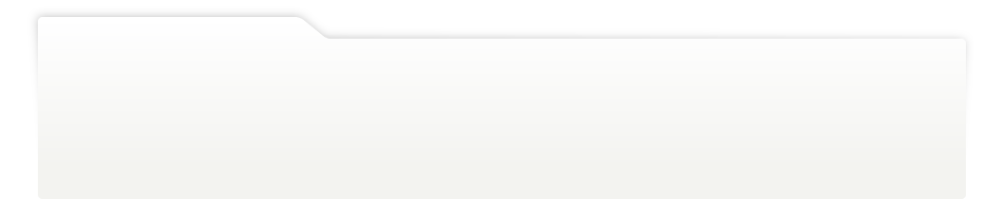
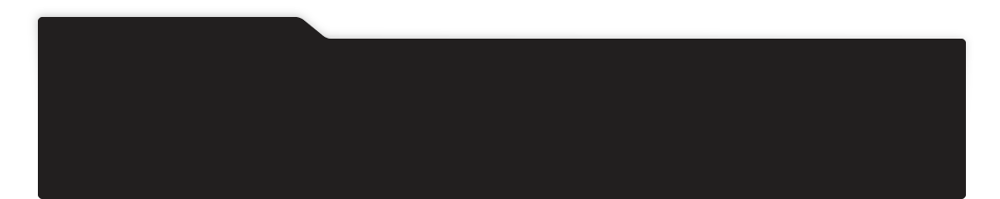
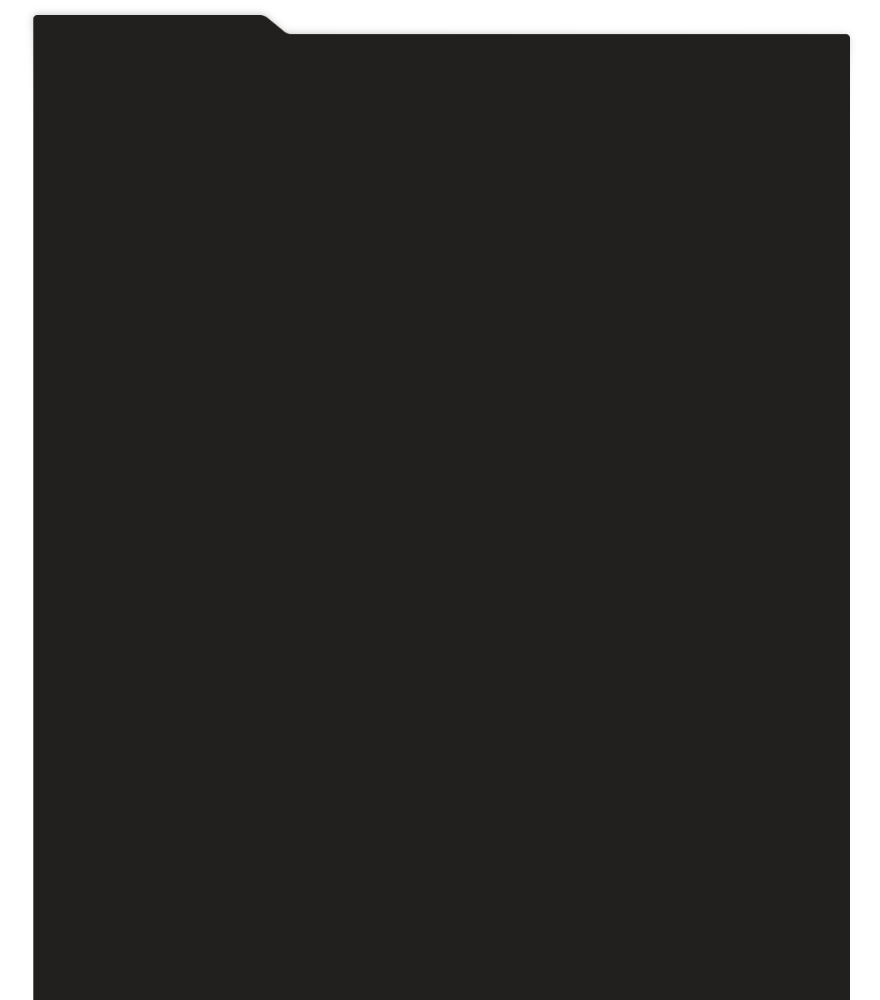
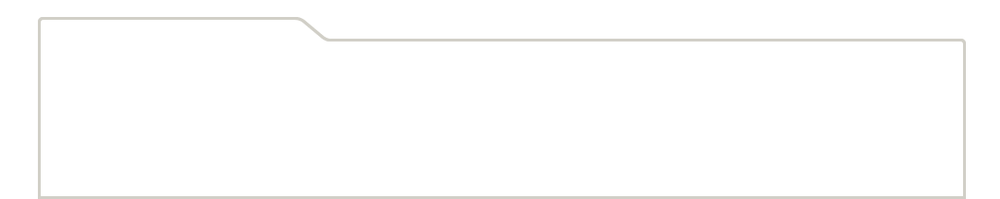
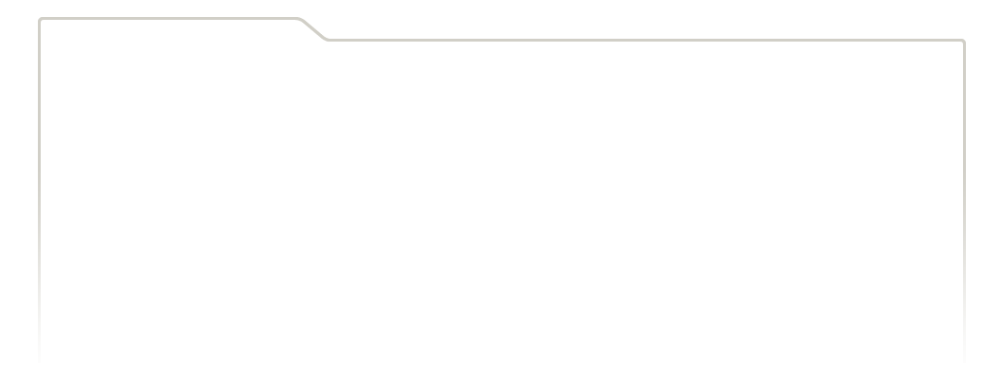
...
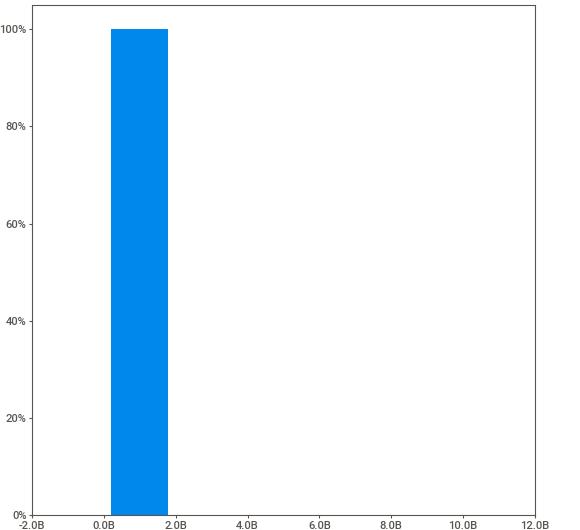
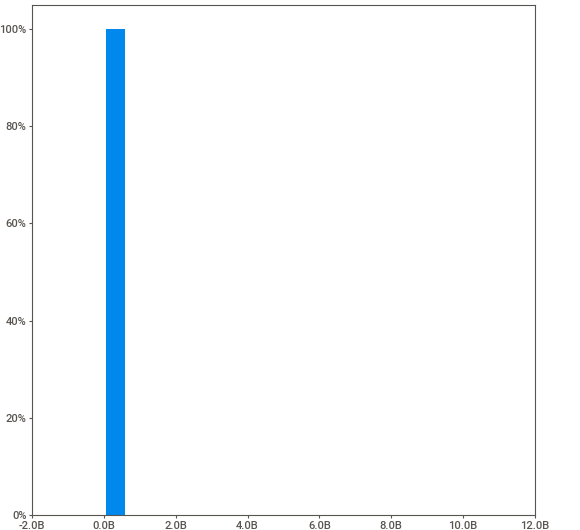
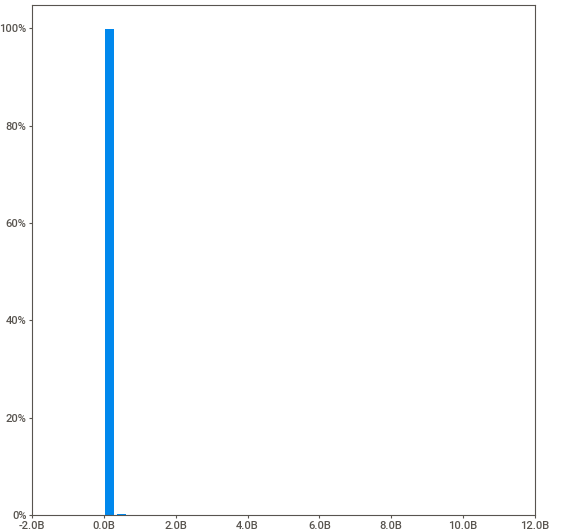
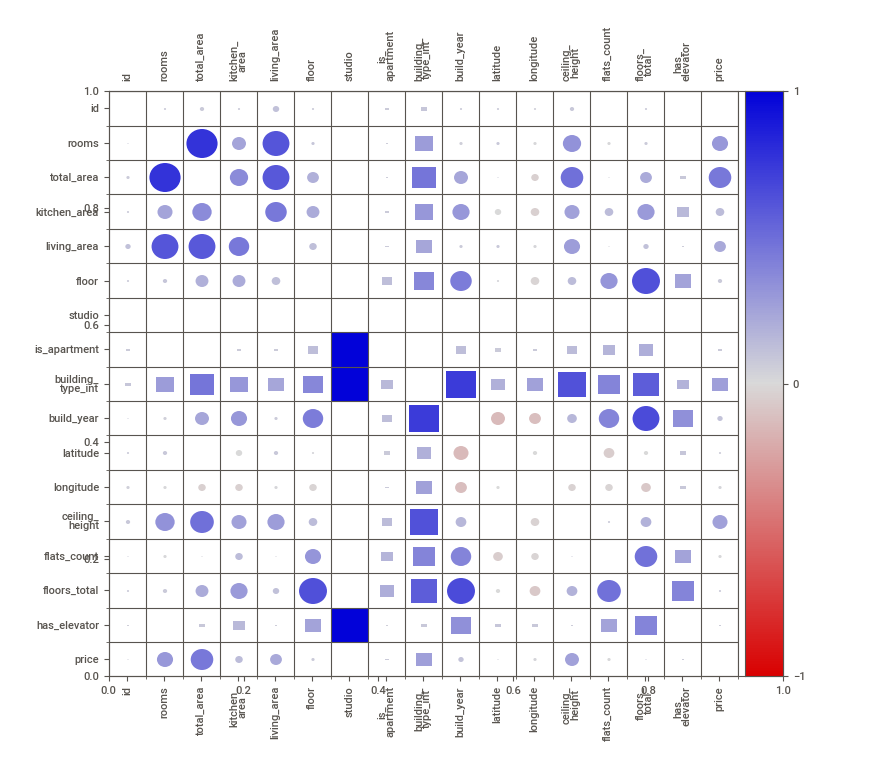
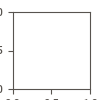

Report EDA_ASSETS/reports/1_before_sv.html was generated.


In [9]:
# Вывод отчета SweetVIZ
report_floor = sv.analyze(data)
report_floor.show_notebook()
report_floor.show_html(
    filepath=eda_assets("1_before_sv.html", "reports"), 
    open_browser=False, layout="vertical"
)

По признакам датасета можно отметить следующее:
1. Из 17 признаков предположительно 4 являются категориальными (`is_apartment`, `studio`, `building_type_int` и `has_elevator`), а остальные числовыми.
2. По признаку `studio` имеется только значение `False`. Возможно в датасет не выгружаются квартиры-студии, соответственно данный признак будет лишним для обучения модели. По признаку `is_apartment` основная масса записей (более 99%) имеет значение `False`, также порядка 90% всех квартир имеют в доме лифт.
3. Имеются большие выбросы в признаках площади (`kitchen_area`, `living_area`, `total_area`), а также в признаках `rooms`, `ceiling_height` и целевом признаке `price`.
4. Достаточно большое количество нулевых значений в признаках `kitchen_area` (8%) и `living_area` (13%).

По целевому признаку наибольшая корреляция наблюдается с числовыми признаками `total_area` (0.42), `rooms` (0.26), `ceiling_height` (0.22) и `living_area` (0.18), а также с категориальной `building_type_int`. Оценим признаки датасета.

#### Дубликаты в данных

Оценим количество явных дубликатов в датасете.

In [10]:
feature_cols = data.drop(columns=["id"]).columns.to_list()
print("Количество неявных дубликатов:",
      data.duplicated(subset=feature_cols).sum())

Количество неявных дубликатов: 9116


Вероятнее всего это одни и те же квартиры, так как объявления на продажу могут подаваться как ее хозяином, так и посредником (и возможно не одним). Также могут продаваться однотипные квартиры по одному адресу, например в новостройках. Так как дубликаты не несут дополнительной информации для моделей машинного обучения, избавимся от дублирующихся записей.

In [11]:
data = data.drop_duplicates(subset=feature_cols).reset_index(drop=True)
print("Размер датасета после удаления дубликатов:", data.shape[0])
del feature_cols

Размер датасета после удаления дубликатов: 132246


### 2.3. Анализ признаков для модели

#### Количество комнат

По количеству комнат значения начинаются с 1, а максимальное значение доходит до 20-ти. Основная масса квартир до 4-х комнат, это порядка 95% от датасета, а на квартиры более 6-ти комнат приходится менее 0,2%. Оценим распределение комнат по цене в разрезе типов зданий. Так как имеются большие выбросы по целевому признаку, график построим с логарифмической шкалой.

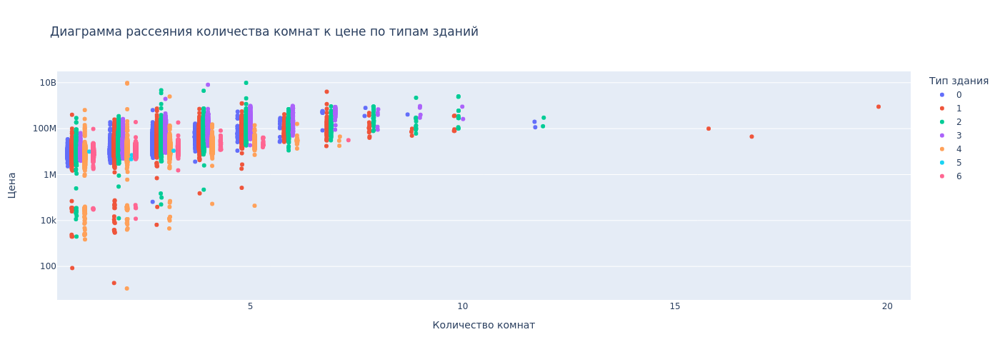

In [12]:
fig = px.strip(
    data, x="rooms", y="price", color="building_type_int", log_y=True,
    title="Диаграмма рассеяния количества комнат к цене по типам зданий",
    labels={"price": "Цена", "rooms": "Количество комнат", "building_type_int": "Тип здания"},
    category_orders={"building_type_int": range(7)}
)
fig.write_html(file=eda_assets("01_rooms.html"))
fig.show(renderer="png", width=1400)

Заметен рост стоимости квартир по мере увеличения количества комнат, однако рост нелинейный. Так как данная шкала логарифмическая, вероятнее всего имеется степенная зависимость между количеством комнат и стоимостью квартиры. Также по типу здания заметно, что более высокие значения типа здания представлены преимущественно для квартир с меньшим количеством комнат и по мере их роста увеличивается преобладание меньших значений типа здания. Можно сделать предположение, что численные типы зданий могут означать различные классы зданий - от элитного до эконом, однако могут иметь и соврешнно иную основу.

Дополнительно заметна группа квартир, стоимость которых существенно ниже основной массы, количество комнат в основном от 1 до 3, но таких объявлений немного.

Чтобы избавиться от выбросов - возможных некорректных и/или редких значений количества комнат, ограничим значения данного признака в пределах от 1 до значений не превышающих 1.5-кратный межквартильный размах свыше 3-го квартиля. Все значения, выходящие за пределы этого промежутка подлежат удалению. Подготовим фукнцию, которая будет определять, является или нет значение выбросом.

In [13]:
# Функция для поиска выбросов
def is_outlier(
    df: pd.DataFrame, target: str, min_val: int | None = None, 
    max_val: int | None = None, threshold=1.5
) -> pd.Series:
    Q1 = df[target].quantile(0.25)
    Q3 = df[target].quantile(0.75)
    min_val = max(Q1 - threshold * (Q3 - Q1), min_val) if min_val else Q1 - threshold * (Q3 - Q1)
    print("Минимальное значение ниже которого выбросы:", min_val)
    max_val = min(threshold * (Q3 - Q1) + Q3, max_val) if max_val else Q3 + threshold * (Q3 - Q1)
    print("Максимальное значение выше которого выбросы:", max_val)
    return (df[target] < min_val) | (df[target] > max_val)

In [14]:
print("Количество выбросов признака rooms:", is_outlier(data, "rooms", 1).sum())

Минимальное значение ниже которого выбросы: 1
Максимальное значение выше которого выбросы: 6.0
Количество выбросов признака rooms: 253


Исключим выбросы по признаку rooms:

In [15]:
data = data[~is_outlier(data, "rooms", min_val=1)]
print("Количество записей после удаления выбросов:", data.shape[0])

Минимальное значение ниже которого выбросы: 1
Максимальное значение выше которого выбросы: 6.0
Количество записей после удаления выбросов: 131993


#### Площадь

В датасете представлены 3 вида площади:
- Общая площадь `total_area`;
- Площадь кухни `kitchen_area`;
- Жилая площадь `living_area`.

**Общая площадь** имеет большой разброс значений в пределах от 11 до более 960 квадратных метров. Наибольшая корреляция с признаком количества комнат. Также имеется корреляция с другими площадями (жилая / кузня) и высотой потолков, а в части категориальных - с типом здания. Оценим распределение количества комнат к общей площади в разрезе типов здания.

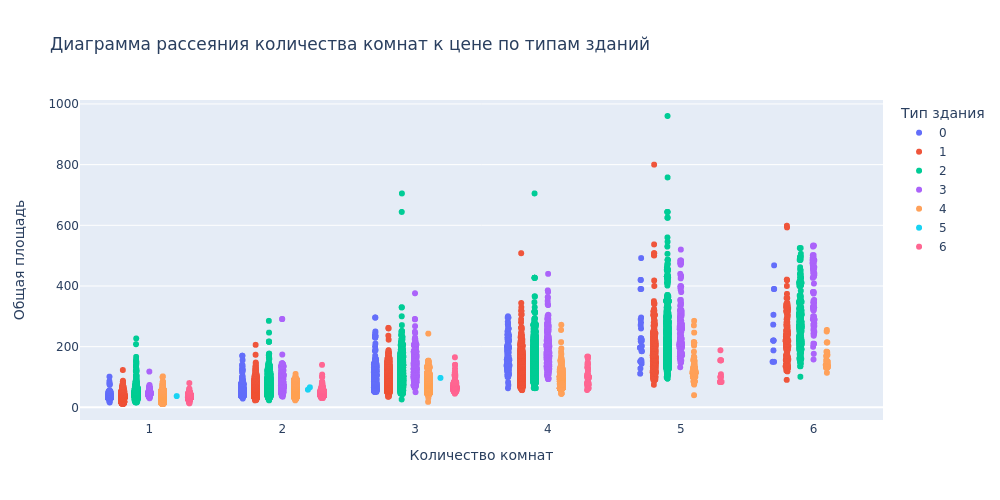

In [16]:
fig = px.strip(
    data, x="rooms", y="total_area", color="building_type_int", 
    title="Диаграмма рассеяния количества комнат к цене по типам зданий",
    labels={"total_area": "Общая площадь", "rooms": "Количество комнат", "building_type_int": "Тип здания"},
    category_orders={"building_type_int": range(7)}
)
fig.write_html(file=eda_assets("02_total_area.html"))
fig.show(renderer="png", width=1000)

По графику заметно, что по мере увеличения количества комнат увеличивается и общая площадь. Также для более распространенных типов зданий заметно ранжирование внутри каждой группы по количеству комнат, а также изменение соотношения одних типов зданий с другими по мере увеличения количества комнат. Наиболее приемлемым вариантом в таком случае будет отсеивать выбросы в разрезе количества комнат и типов зданий.

Оценим распределение крайних значений для выбросов на основе межквартильного интервала.

In [17]:
data.groupby(
    ["rooms", "building_type_int"]
)["total_area"].quantile(
    [0, .01, .05, .25, .5, .75, .95, .99, 1]
).to_frame().unstack().droplevel(0, axis=1).apply(
    lambda x: pd.Series({
        "min": x[0.00], "min_out": x[0.25] - 1.5 * (x[0.75] - x[0.25]), "1%": x[0.01], 
        "5%": x[0.05], "Q1": x[0.25], "Q2": x[0.50], "Q3":x[0.75], "95%": x[0.95], 
        "99%": x[0.99], "max_out": x[0.75] + 1.5 * (x[0.75] - x[0.25]), "max": x[1.00]
}), axis=1).style.background_gradient(
    cmap=sns.diverging_palette(250, 25, as_cmap=True), axis=1
).format("{:,.2f}")

Предоставленные данные имеют достаточно сложное распределение, для некоторых значений площади межквартильный размах явно занижает максимальные значения для определения выброса, либо сильно превосходит имеющиеся значения. Чаще всего пользователи достаточно ответственно подходят к указанию общей площади, однако лучше отсекать сильно отличающиеся значения, на случай ошибок в заполнении. 

Доработаем функцию для возможности указания групп, по которым нужно проводить оценку выбросов на основе межквартильного размаха. И справним какое количество значений признается выбросом с учетом и без учета групп. Для минимального значения площади установим 6 квадратных метров, т.к. это минимальнае допустимае законодательством площадь для одного человека по санитарным нормам. Максимальное значение также будет ограничено 1.5 кратным межквартильным размахом от 3-го квартиля.

In [18]:
# Добавление в функцию возможности группировки
def is_outlier(
    df: pd.DataFrame, target: str, by: list | None = None,
    min_val: int | None = None, max_val: int | None = None, 
    threshold=1.5, verbose=False
) -> pd.Series:
    df = df.copy()
    if by is None:
        if verbose: print("Выбросы без группировки")
        Q1 = df[target].quantile(0.25)
        Q3 = df[target].quantile(0.75)
        min_val = max(Q1 - threshold * (Q3 - Q1), min_val) if min_val else Q1 - threshold * (Q3 - Q1)
        if verbose: print("Минимальное значения для признания выбросом:", min_val)
        max_val = min(threshold * (Q3 - Q1) + Q3, max_val) if max_val else Q3 + threshold * (Q3 - Q1)
        if verbose: print("Максимальное значения для признания выбросом:", max_val)
    else:
        if verbose: print(f"Выбросы с группировкой по {by}")
        # Получение межквартильного отклонения для каждой группы
        vals = df.groupby(
            by=by)[target].quantile([.25, .75]).to_frame().unstack().droplevel(0, axis=1).apply(
            lambda x:
            pd.Series({
                "min_val": x[0.25] - threshold * (x[0.75] - x[0.25]),
                "max_val": x[0.75] + threshold * (x[0.75] - x[0.25])
            }), axis=1
        )
        # Добавление ограничений минимального и максимального значения
        if min_val: vals.loc[vals["min_val"] < min_val, "min_val"] = min_val
        if max_val: vals.loc[vals["max_val"] > max_val, "max_val"] = max_val
        if verbose:
            print("Значения для признания выбросом:")
            print(vals.T)
        # Добавление ограничений к каждой записи датасета by
        vals = df.join(vals, on=by)[["min_val", "max_val"]]
        min_val = vals["min_val"]
        max_val = vals["max_val"]
    return (df[target] < min_val) | (df[target] > max_val)

In [19]:
print("Количество выбросов признака rooms (с группировкой):", 
      is_outlier(
          data, "total_area", by=["rooms", "building_type_int"], 
          min_val=6, verbose=True).sum())
print()
print("Количество выбросов признака rooms (без группировки):", 
      is_outlier(data, "total_area", min_val=6, verbose=True).sum())

Выбросы с группировкой по ['rooms', 'building_type_int']
Значения для признания выбросом:
rooms                 1                                         2         
building_type_int     0     1     2     3     4     5     6     0     1   
min_val           21.80 20.05 24.80 32.25 27.25 37.10 28.55 25.09 20.20  \
max_val           48.20 46.85 60.00 59.05 46.05 37.10 40.15 75.79 81.00   

rooms                     ...      5                                  6   
building_type_int      2  ...      1      2      3      4      6      0   
min_val            27.40  ...  27.25  39.57  55.00  92.37   6.00   6.00  \
max_val           101.80  ... 319.65 386.78 447.00 140.58 261.50 562.97   

rooms                                          
building_type_int      1      2      3      4  
min_val             6.00  62.50  27.75  61.37  
max_val           446.50 482.50 725.75 250.78  

[2 rows x 38 columns]
Количество выбросов признака rooms (с группировкой): 3819

Выбросы без группировки
Минимально

В случае применения группировки по признакам, выбросами признаются 3819 записей, а без применения группировки признается практически в 2 раза больше записей. Произведем очистку от выбросов по признаку `total_area` с группировкой по `rooms` и `building_type_int`. Возможно более оптимальным решением будет увеличить коэффициент межквартильного размаха, однако такой вопрос лучше урегулировать с Заказчиком.

In [20]:
data = data[~is_outlier(
    data, "total_area", by=["rooms", "building_type_int"], min_val=6)].copy()
print("Количество записей после удаления выбросов:", data.shape[0])

Количество записей после удаления выбросов: 128174


**Площадь кухни** имеет довольно большое количество нулевых значений в исходном датасете - порядка 8.3%, значения больше 0 начинаются с 1.5 квадратных метра и доходит до 203. Площадь кухни обычно заполняется более ответственно, однако ее необходимо рассматривать совместно с общей и жилой площадью.

**Жилая площадь** имеет еще больше нулевых значений в исходном датасете - 13.1%, значения более 0 начинаются с 2 квадратов и доходят до 700. Вероятнее всего нулевые значения просто не были заполнены пользователями. Проверим не выходят ли суммарные значения площади кухни и жилой площади за значения общей площади.

In [21]:
display(data[(data["kitchen_area"] + data["living_area"]) > data["total_area"]])
print(f"Среднее отношение площади кухни к общей: {(data['kitchen_area'] / data['total_area']).mean():.2%}")
print(f"Среднее отношение жилой площади к общей: {(data['living_area'] / data['total_area']).mean():.2%}")

,id,rooms,total_area,kitchen_area,living_area,floor,studio,is_apartment,building_type_int,build_year,latitude,longitude,ceiling_height,flats_count,floors_total,has_elevator,price
494,498,1,32.00,19.50,19.50,5,False,False,6,1962,55.81,37.58,2.64,64,9,True,8050000.00
568,572,3,72.90,21.00,65.00,2,False,False,3,2016,55.57,37.49,3.00,297,16,True,17800000.00
1145,1152,3,67.00,6.00,66.00,4,False,False,1,1933,55.78,37.67,4.00,161,8,True,35000000.00
1617,1631,3,65.20,12.00,53.20,7,False,False,2,2014,55.64,37.60,3.00,213,20,False,16990000.00
1637,1651,1,33.10,7.70,25.40,9,False,False,4,1967,55.71,37.67,2.70,251,9,True,20000000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129412,138072,2,62.00,13.00,58.40,11,False,False,4,2015,55.60,37.37,2.74,462,17,True,16300000.00
129823,138545,3,103.80,40.00,80.00,8,False,False,2,2011,55.68,37.63,3.00,869,33,True,30749912.00
129847,138570,1,55.93,17.00,46.20,4,False,False,3,2016,55.47,37.29,3.00,123,6,True,12899990.00
131041,139880,3,77.50,32.00,51.40,4,False,False,1,1958,55.68,37.56,3.00,69,5,False,15600000.00


Среднее отношение площади кухни к общей: 16.31%
Среднее отношение жилой площади к общей: 51.57%


В измененном датасете имеется 139 записей, в которых суммарная площадь кухни и жилой превышает общую площадь. По таким данным можно отметить, что встречаются некорректные значения как площади кухни, так и жилой площади. Также некоторые значения очень близки и могут быть вызваны погрешностью типа float в Python. Однако жилая площадь рассчитывается не только за исключением кухни, но и прихожих, санузлов и прочих нежилых помещений. 

Лучше исправить некорректные значения на медиану по каждой группе в разрезе количества комнат и типа здания. Однако имея только площадь кухни или жилую невозможно определить насколько корректно она заполнена, необходимо оценить соотношение к общей площади. Дополним функцию поиска выбросов для обеспечения возможности определить их по соотношению к другому признаку.

In [22]:
# Добавление возможности осуществлять оценку соотношения (разделить на другое поле)
# и исключение нулевых значений для рассчета выбросов
def is_outlier(
    df: pd.DataFrame, target: str, divider: str | None = None, out_val: int | None = None,
    by: list | None = None, min_val: int | None = None, max_val: int | None = None, 
    threshold = 1.5, verbose = False,
) -> pd.Series:
    df = df.copy()
    if divider is not None:
        df[target] = df[target] / df[divider]
    if by is None:
        if verbose: print("Выбросы без группировки")
        Q1 = df[target].quantile(.25) if out_val is None else df.query(f"{target} != {out_val}").quantile(.25)
        Q3 = df[target].quantile(.75) if out_val is None else df.query(f"{target} != {out_val}").quantile(.75)
        min_val = max(Q1 - threshold * (Q3 - Q1), min_val) if min_val else Q1 - threshold * (Q3 - Q1)
        if verbose: print("Минимальное значения для признания выбросом:", min_val)
        max_val = min(threshold * (Q3 - Q1) + Q3, max_val) if max_val else Q3 + threshold * (Q3 - Q1)
        if verbose: print("Максимальное значения для признания выбросом:", max_val)
    else:
        if verbose: print(f"Выбросы с группировкой по {by}")
        # Получение межквартильного отклонения для каждой группы
        vals = df.groupby(
            by=by)[target].quantile([.25, .75]).to_frame().unstack().droplevel(0, axis=1).apply(
                lambda x:
                pd.Series({
                    "min_val": x[0.25] - threshold * (x[0.75] - x[0.25]),
                    "max_val": x[0.75] + threshold * (x[0.75] - x[0.25])
                }), axis=1
        ) if out_val is None else df.query(f"{target} != {out_val}").groupby(
            by=by)[target].quantile([.25, .75]).to_frame().unstack().droplevel(0, axis=1).apply(
                lambda x:
                pd.Series({
                    "min_val": x[0.25] - threshold * (x[0.75] - x[0.25]),
                    "max_val": x[0.75] + threshold * (x[0.75] - x[0.25])
                }), axis=1
        )
        # Добавление ограничений минимального и максимального значения
        if min_val is not None: vals.loc[vals["min_val"] < min_val, "min_val"] = min_val
        if max_val is not None: vals.loc[vals["max_val"] > max_val, "max_val"] = max_val
        if verbose:
            print("Значения для признания выбросом:")
            print(vals.T)
        # Определение ограничений каждой записи датасета
        vals = df.join(vals, on=by)[["min_val", "max_val"]]
        min_val = vals["min_val"]
        max_val = vals["max_val"]
    return (df[target] < min_val) | (df[target] > max_val) | (df[target] == out_val)

 Оценим количество выбросов в оставшемся датасете.

In [23]:
kitchen_outs = is_outlier(
    data, "kitchen_area", divider="total_area", 
    out_val=0, by=["rooms", "building_type_int"],
)

living_outs = is_outlier(
    data, "living_area", divider="total_area",
    out_val=0, by=["rooms", "building_type_int"]
)

print(f"Некорректные значения площади кухни: {kitchen_outs.mean():.2%}")
print(f"Некорректные значения жилой площади: {living_outs.mean():.2%}")
print(f"Всего уникальных некорректных записей: {(kitchen_outs | living_outs).mean():.2%}")

Некорректные значения площади кухни: 10.89%
Некорректные значения жилой площади: 15.61%
Всего уникальных некорректных записей: 19.55%


Практически 19.5% записей вероятно заполнены некорректно. Заполним такие данные медианой по группам.

In [24]:
# Функция для рассчета медианы
def get_agg_values(
    data: pd.DataFrame, target: str, divider: str | None = None,
    by: list | None = None, round_n = 2, func="median"
) -> pd.Series:
    result = data[target].copy()
    if by is None:
        result = result.transform(func=func)
    else:
        if divider is not None:
            result = result / data[divider]
        result = data[by].join(result.rename("result"))
        result = result.groupby(by).transform(func=func)["result"]
        if divider is not None:
            result = round(result * data[divider], round_n)
    return result

In [25]:
# Исключение некорректных значений для рассчета медианы
data.loc[kitchen_outs, "kitchen_area"] = np.nan
data.loc[living_outs, "living_area"] = np.nan

# Получение медианных значений по датасету 
kitchen_median = get_agg_values(
    data, "kitchen_area", divider="total_area", by=["rooms", "building_type_int"]
)
living_median = get_agg_values(
    data, "living_area", divider="total_area", by=["rooms", "building_type_int"]
)

# Запись медианных значений в датасет
data.loc[kitchen_outs, "kitchen_area"] = kitchen_median[kitchen_outs]
print("По признаку kitchen_area произведена замена записей:",
      (data["kitchen_area"] == kitchen_median).sum())
data.loc[living_outs, "living_area"] = living_median[living_outs]
print("По признаку living_area произведена замена записей:",
      (data["living_area"] == living_median).sum())
del kitchen_median, kitchen_outs, living_median, living_outs

По признаку kitchen_area произведена замена записей: 15141
По признаку living_area произведена замена записей: 20459


Произведено исправление вероятно некорректно заполненных значений. Можно отметить, что фактические значения площади кухни и жилой площади не несут большой информации для модели, лучше было бы рассмотреть их отношение к общей площади.

#### Этаж

По признаку этажа наименьшее значение - 1. Необходимо проверить, не превышает ли этаж квартиры максимальное количество этажей в здании.

In [26]:
print("Количество квартир, этаж которых выше этажности здания:",
      (data["floor"] > data["floors_total"]).sum())

Количество квартир, этаж которых выше этажности здания: 0


В датасете отсутствуют квартиры, этаж которых превышает этажность здания, возможно осуществляется такая проверка при создании объявлений.

Вероятно полезным было бы выделить квартиры, находящиеся на первом и последнем этажах. Оценим среднюю стоимость квадратного метра для таких квартир по сравнению с остальными.

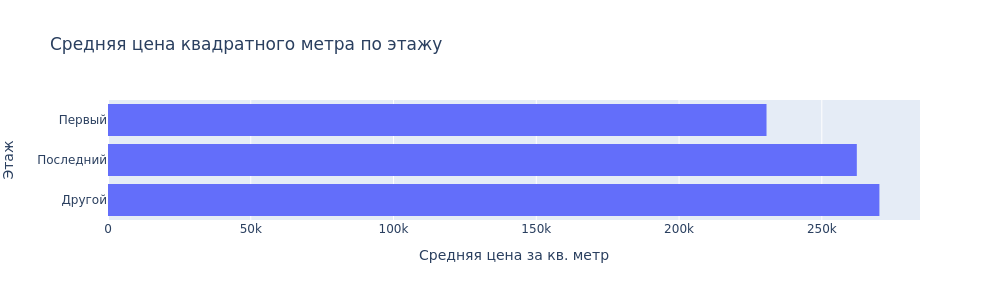

In [27]:
fig = px.histogram(
    x=data["price"] / data["total_area"],
    y=data.apply(
        lambda x: "Последний" if x["floor"] == x["floors_total"] else 
        "Первый" if x["floor"] == 1 else "Другой",
        axis=1
    ), category_orders={"y": ["Первый", "Последний", "Другой"]},
    title="Средняя цена квадратного метра по этажу",
    labels={"y": "Этаж"}, histfunc="avg"
)
fig.update_layout(xaxis_title="Средняя цена за кв. метр")
fig.write_html(file=eda_assets("03_price_by_floor.html"))
fig.show(renderer="png", width=1000, height=300)

Средняя цена за квадратный метр первого этажа значительно ниже средней цены других этажей, при этом последний этаж влияет на цену не так существенно.

Стоит отметить наличие в датасете не только этажности здания, но и количества квартир `floors_total` в здании. По таким данным можно приблизительно рассчитать плотность квартир на этаж, что может дополнительно подсказать оценочный размер здания - "муравейник" или "башня". Если бы датасет содержал также количество подъездов, можно было бы более точно определить плотность квартир. 

Дополнительно можно оценить влияние средней цены за квадратный метр этажа квартиры в домах без лифта.

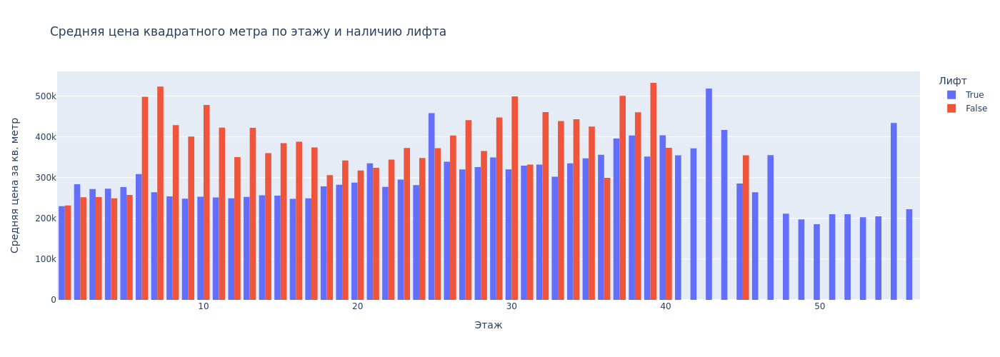

In [28]:
fig = px.histogram(
    x=data["floor"], y=data["price"] / data["total_area"],
    color=data["has_elevator"], barmode="group",
    title="Средняя цена квадратного метра по этажу и наличию лифта",
    labels={"x": "Этаж", "color": "Лифт"}, histfunc="avg"
)
fig.update_layout(yaxis_title="Средняя цена за кв. метр")
fig.write_html(file=eda_assets("04_price_by_floor_elevator.html"))
fig.show(renderer="png", width=1400)

Вероятно в датасете имеются ошибки по признаку наличия лифта. Сложно представить дома с квартирами на 40-м этаже в здании без лифта. При этом сильно выделяется средняя стоимость квадратного метра выше 5 этажа. Квартиры до 5 этажа включительно вероятнее всего относятся к большой массе 5-этажных домов, где обычно лифт действительно отсутствует. Квартиры выше 5-го этажа без лифта существенно отличаются средней ценой от остальной массы квартир.

#### Студии и Апартаменты

Признак `studio` представлен только значением `False`, вероятно доступные нам данные отфильтрованы по этому признаку, однако сам признак остался. Исключим данный столбец. 

In [29]:
data.drop(columns="studio", inplace=True)
print("Новый размер датасета:", data.shape)

Новый размер датасета: (128174, 16)


По апартаментам можно отметить наличие слабой корреляции с признаком типа здания. Оценим к каким типам здания относятся апартаменты.

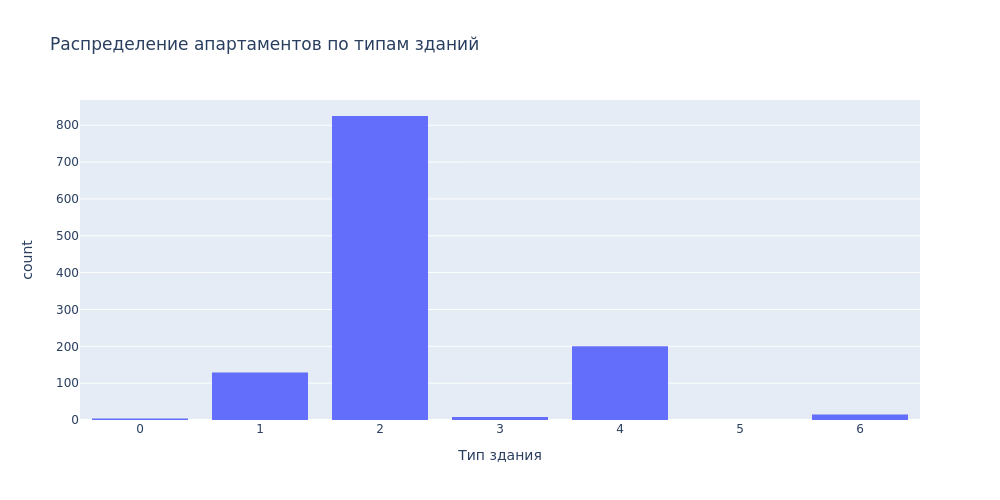

In [30]:
fig = px.histogram(
    data.query("is_apartment == True"), x="building_type_int",
    title="Распределение апартаментов по типам зданий",
    labels={"building_type_int": "Тип здания", "count": "количество"}
)
fig.update_layout(bargap=0.2)
fig.write_html(file=eda_assets("05_apartment_by_building.html"))
fig.show(renderer="png", width=1000)

Основная масса апартаментов располагается в зданиях типа `2`, при этом имеется немалое количество в зданиях типа `4` и `1`, в зданиях других типов количество апартаментов минимально, а в зданиях типа `5` отсутствуют. Вероятно, в виду отсутствия апартаментов в зданиях типа `5` данные эти признаки показывают наличие корреляции.

#### Тип здания

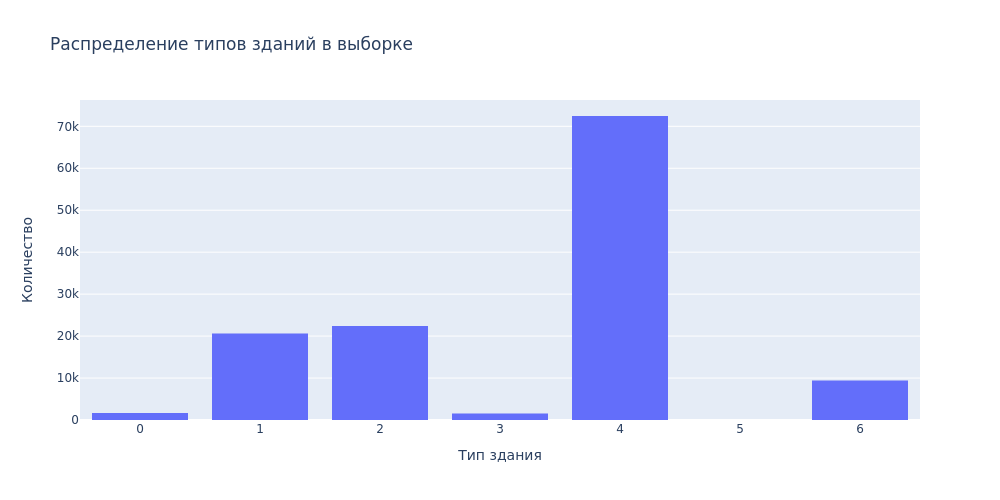

In [31]:
fig = px.histogram(
    data, x="building_type_int", histfunc="count",
    title="Распределение типов зданий в выборке",
    labels={"building_type_int": "Тип здания"}
)
fig.update_layout(yaxis_title="Количество", bargap=0.2)
fig.write_html(file=eda_assets("06_building.html"))
fig.show(renderer="png", width=1000)

Основная масса зданий приходится на 4-й тип, достаточно большое количество зданий приходится на 2-й и 1-й типы зданий. Немного ниже количество зданий типа 6. Наименьшее количестов зданий приходится на типы 3 и 0, а меньше всего 5.

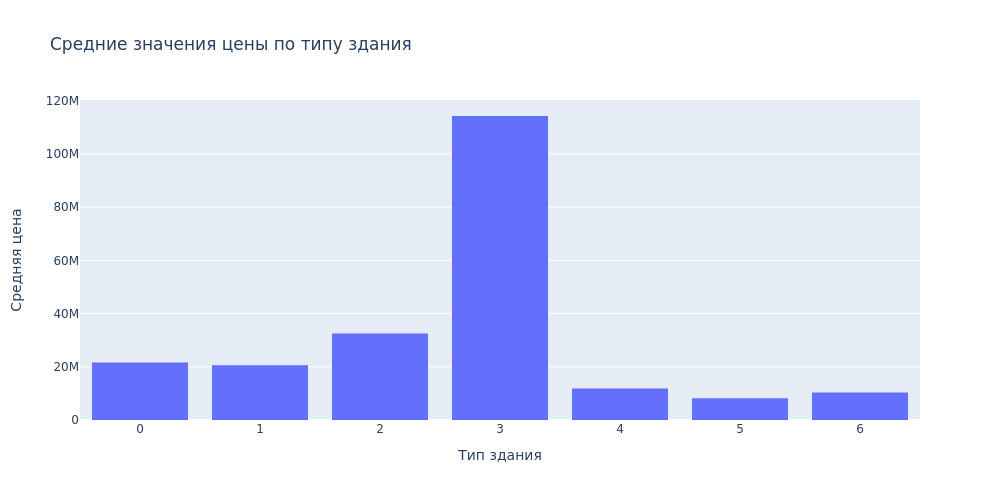

In [32]:
fig = px.histogram(
    data, x="building_type_int", y="price", histfunc="avg", 
    title="Средние значения цены по типу здания",
    labels={"count": "Средняя цена", "building_type_int": "Тип здания"}
)
fig.update_layout(yaxis_title="Средняя цена", bargap=0.2)
fig.write_html(file=eda_assets("07_building_price.html"))
fig.show(renderer="png", width=1000)

Наибольшая средняя цена приходится на 3 тип зданий, остальные в среднем существенно дешевле. Данный признак явно является категориальным, причем признак имеет нелинейное отношение к целевому. Для более точной оценки необходимо сравнить с ценой квадратного метра.

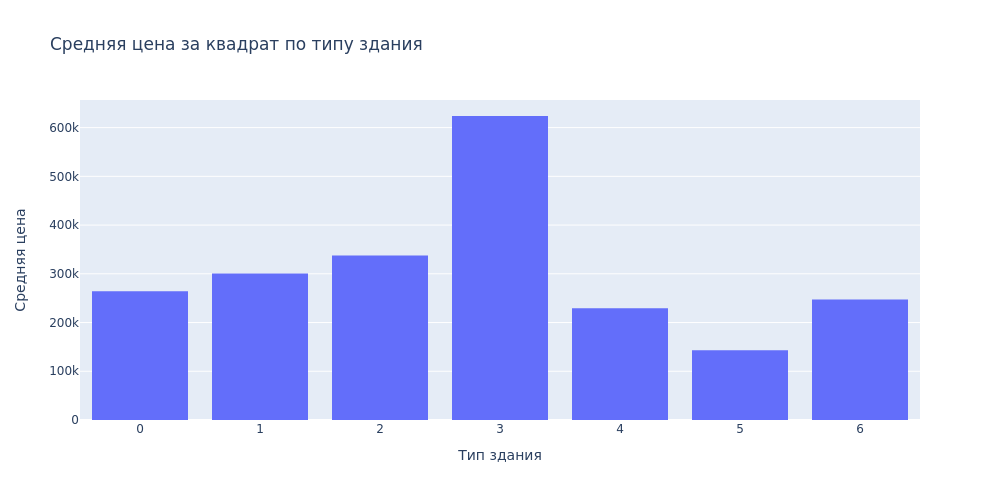

In [33]:
fig = px.histogram(
    x=data["building_type_int"], y=data["price"] / data["total_area"],
    title="Средняя цена за квадрат по типу здания",
    labels={"x": "Тип здания"}, histfunc="avg"
)
fig.update_layout(yaxis_title="Средняя цена", bargap=0.2)
fig.write_html(file=eda_assets("08_building_price_by_area.html"))
fig.show(renderer="png", width=1000)

Значения средней цены за квадратный метр существенно ближе. Однако также наблюдается отсутствие прямой или обратной зависимости значений с целевым признаком. Данный признак явно является категориальным и не имеет порядковой составляющей, по крайне мере по отношению к целевому признаку, соответственно лучше его преобразовать в текст, чтобы в дальнейшем его было легче определить как категориальный.

In [34]:
data["building_type_int"] = data["building_type_int"].astype("str")
data.rename(columns={"building_type_int": "building_type"}, inplace=True)
data["building_type"].unique()

array(['6', '2', '4', '1', '3', '0', '5'], dtype=object)

#### Картография

Данные по широте и долготе распределены в пределах одного градуса и в целом не выглядят аномально. Оценим расположение случайных 5000 точек на карте.

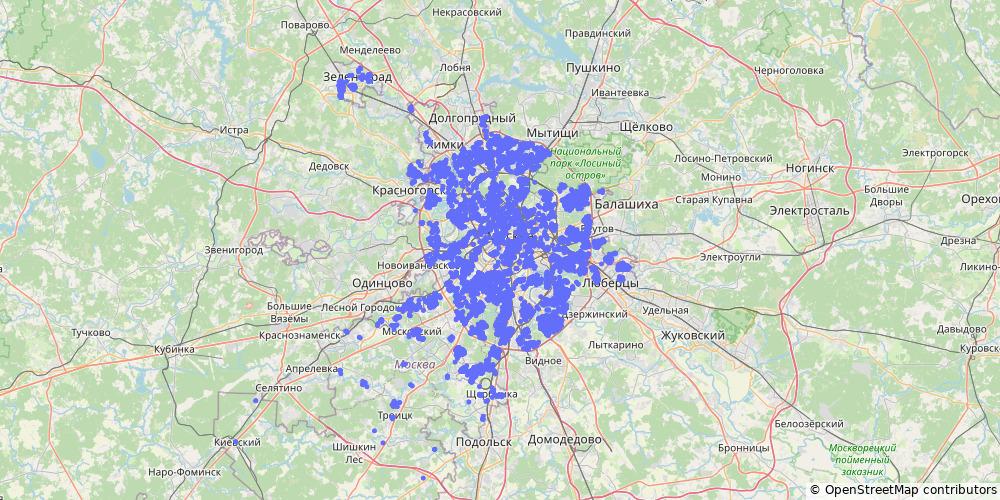

In [35]:
fig = px.scatter_mapbox(
    data_frame=data.sample(5000, random_state=RANDOM_STATE), 
    lat="latitude", lon="longitude", hover_name="rooms",
    mapbox_style="open-street-map", zoom=8)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
# Сохранение в виде картинки, так как в MLflow не отображается карта
fig.write_image(file=eda_assets("09_5k_sample_on_map.svg"))
fig.show(renderer="png", width=1000)

Судя по карте датасет состоит из квартир города Москва. Преобразование данных не требуется.

Вероятно полезным было бы добавление в датасет информации о расстоянии до ближайших социально значимых объектов, таких как станции метро, школы, детские сады, парки и другие, а также расстояние до центра города.

#### Высота потолков

Высота потолков начинается с 2 метров и доходит до максимального значения в 27, второе максимальное значение - 8 метров. В целом в сервисе Яндекс Недвижимость можно встретить двухуровневые и более квартиры со вторым светом, высота потолков которых может доходить до 8 метров или даже выше, однако значение в 27 метров возможно является ошибкой. Для обучения модели лучше ограничим значение высоты потолков от 2-х до 10-ти метров.

In [36]:
data = data.query("2 <= ceiling_height <= 10")
print("Новый размер датасета:", data.shape)

Новый размер датасета: (128173, 16)


#### Другие признаки дома

По остальным признакам, относящимся к характеристикам дома аномалии не наблюдаются. Признаки останутся без преобразования.

### 2.4. Анализ целевой переменной

По целевому признаку в исходном датасете были большие выбросы. Возможно от части выбросов удалось избавиться в предыдущих этапах. Оценим распределение целевого признака после произведенных преобразований.

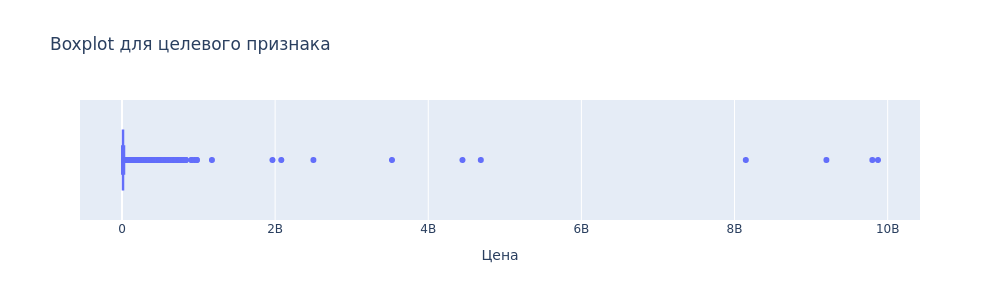

In [37]:
fig = px.box(data, x="price", title="Boxplot для целевого признака", labels={"price": "Цена"})
fig.write_html(file=eda_assets("10_price_box_full.html"))
fig.show(renderer="png", width=1000, height=300)

Очень большой разброс по цене, основные значения существенно ниже чем максимальные. Взглянем на данные с ограничением по максимальному значению.

In [38]:
fig = px.box(data, x="price", title="Boxplot для целевого признака (до 100'000'000)", labels={"price": "Цена"})
fig.update_xaxes(range=[0, 1e8])
fig.write_html(file=eda_assets("11_price_box.html"))
fig.show()

Разброс целевого признака очень большой, основная масса сотредоточена в нижней части значений в пределах до 30 000 000, однако рассматривать целевой признак как есть не имеет смысла, нужно оценить разброс значений не по общей стоимости квартиры, а по стоимости квадратного метра.

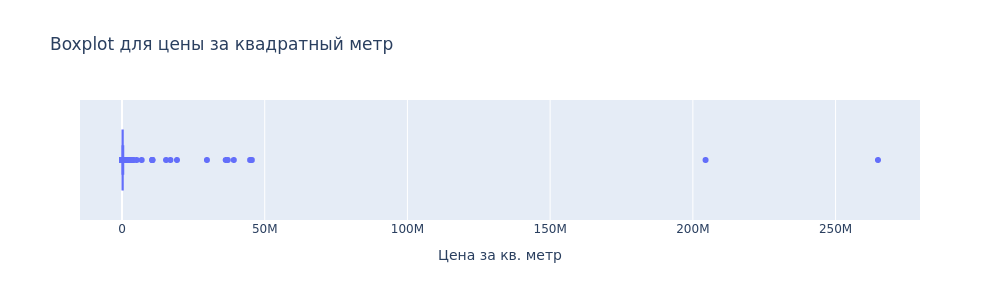

In [39]:
fig = px.box(
    x=data["price"] / data["total_area"], 
    title="Boxplot для цены за квадратный метр",
    labels={"x": "Цена за кв. метр"}
)
fig.write_html(file=eda_assets("12_price_by_area_box_full.html"))
fig.show(renderer="png", width=1000, height=300)

По цене за квадратный метр наблюдается близкая картина - имеются сильные выбросы. Оценим основную массу значений.

In [40]:
fig = px.box(
    x=data["price"] / data["total_area"], 
    title="Boxplot для цены за квадратный метр (до 500'000)",
    labels={"x": "Цена за кв. метр"}
)
fig.update_xaxes(range=[0, 500000])
fig.write_html(file=eda_assets("13_price_by_area_box.html"))
fig.show()

#### Анализ целевой переменной в зависимости от различных признаков

По целевому признаку наибольшая корреляция наблюдается с признаками площади `total_area` (0.76), `living_area` (0.73) и `kitchen_area` (0.55), другими числовыми признаками `rooms` (0.62) и `ceiling_height` (0.44) , а также с категориальной `building_type_int` (0.48). Оценим признаки датасета.

Взглянем на взаимосвязь целевого признака с наиболее коррелирующим признаком общей площади, а также в разрезе наиболее коррелирующего категориального признака типа дома. 

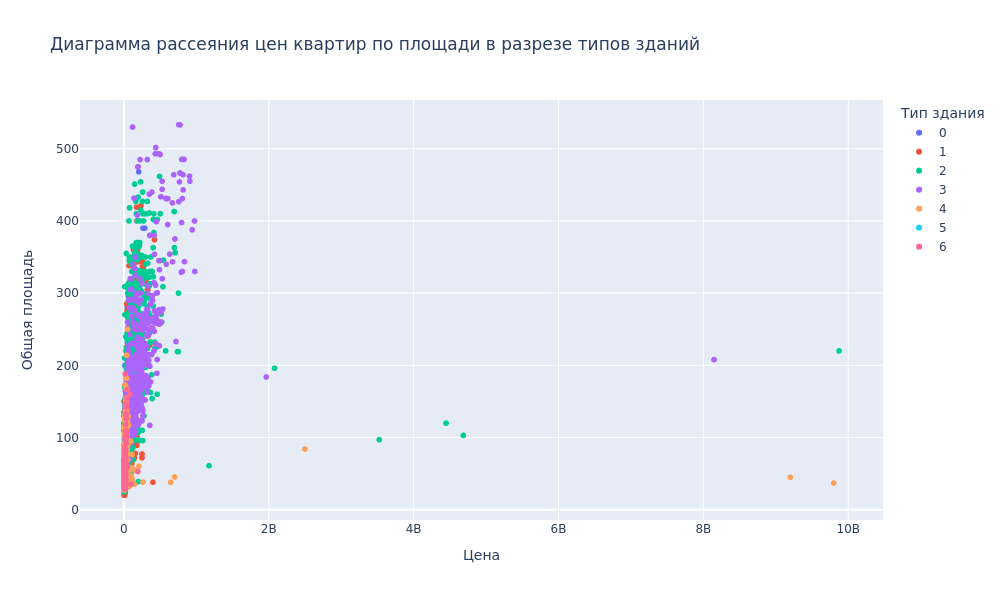

In [41]:
fig = px.scatter(
    data, x="price", y="total_area", color="building_type",
    height=600, title="Диаграмма рассеяния цен квартир по площади в разрезе типов зданий",
    labels={"price": "Цена", "total_area": "Общая площадь", "building_type": "Тип здания"},
    category_orders={"building_type":[str(x) for x in range(7)]}
)
fig.write_html(file=eda_assets("14_price_area_scatter_full.html"))
fig.show(renderer="png", width=1000)

В связи с очень большими выбросами ограничим вывод цены до 100 000 000.

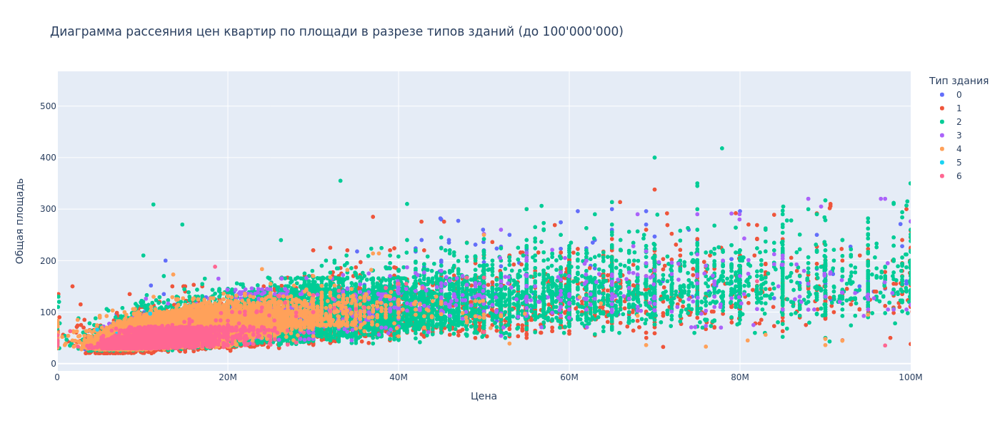

In [42]:
fig = px.scatter(
    data, x="price", y="total_area", color="building_type",
    height=600, title="Диаграмма рассеяния цен квартир по площади в разрезе типов зданий (до 100'000'000)",
    labels={"price": "Цена", "total_area": "Общая площадь", "building_type": "Тип здания"},
    category_orders={"building_type":[str(x) for x in range(7)]}
)
fig.update_xaxes(range=[0, 1e8])
fig.write_html(file=eda_assets("15_price_area_scatter.html"))
fig.show(renderer="png", width=1400)

Можно отметить, что некоторые цены являются довольно популярными (вертикальные полосы из точек), куда попадают квартиры с различной общей площадью. Зависимость цены квартиры от площади нелинейна, причем имеются довольно большой разброс значений по цене. Судя по всему существенное влияние на такой большой разброс цен может также оказывать расположение квартир в различных районах города.

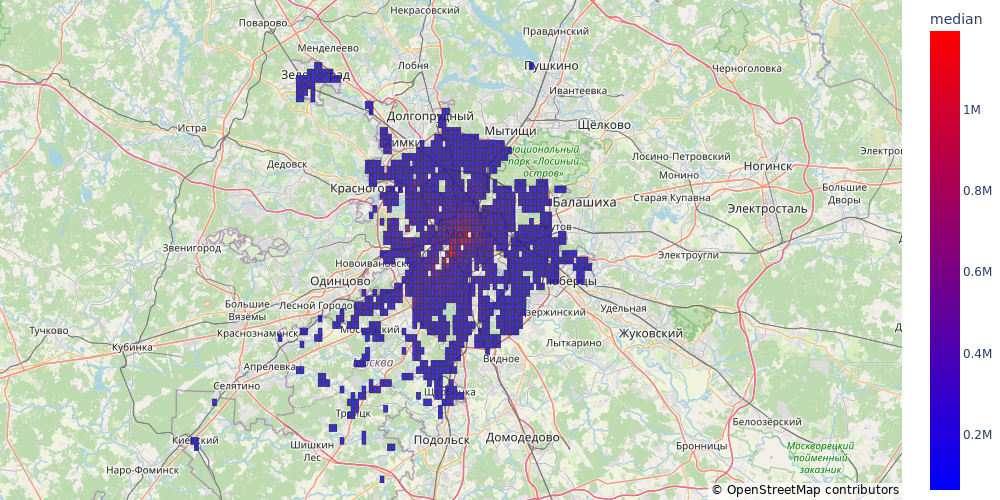

In [43]:
# Определение глубины округления широты/долготы
round_scale = 2
geo_step = 10 ** -round_scale / 2

# Получение аггрегирующих данных
map_data = pd.DataFrame({
    "lat": data["latitude"].round(round_scale), 
    "lon": data["longitude"].round(round_scale), 
    "price": data["price"] / data["total_area"]
}).groupby(by=["lat", "lon"])["price"].agg(["min", "median", "max"]).reset_index().reset_index()

# Получение сетки для вывода на карте
geojson = {
    "type": "FeatureCollection",
    "features": map_data.apply(
        lambda x:
        {   
            "type": "Feature",
            "geometry": {
                "type": "Polygon",
                "coordinates": [[
                    [x["lon"]-geo_step, x["lat"]-geo_step],
                    [x["lon"]+geo_step, x["lat"]-geo_step],
                    [x["lon"]+geo_step, x["lat"]+geo_step],
                    [x["lon"]-geo_step, x["lat"]+geo_step],
                    [x["lon"]-geo_step, x["lat"]-geo_step]
                ]]
            },
            "properties": {
                "id": x["index"],
                "min": x["min"],
                "med": x["median"],
                "max": x["max"]
            }
        }, axis=1
    ).to_list()
}

# Вывод тепловой карты по регионам
fig = px.choropleth_mapbox(
    map_data, geojson=geojson, color="median",
    locations="index", featureidkey="properties.id",
    color_continuous_scale="Bluered",
    mapbox_style="open-street-map", zoom=8, opacity=0.8,
    center={"lat": map_data["lat"].mean(), "lon": map_data["lon"].mean()}
)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
# Сохранение в виде картинки, так как в MLflow не отображается карта
fig.write_image(file=eda_assets("16_price_by_area_heatmap.svg"))
fig.show(renderer="png", width=1000)
del round_scale, geo_step, geojson, map_data

По средней цене за квадратный метр можно отметить довольно высокие цены вблизи центра Москвы, а также местами в западной части города. Обработку выбросов для целевого признака некорректно проводить без привязки к местоположению квартиры, так как разные местоположения достаточно сильно влияют на целевой признак. 

Добавим группировку по широте и долготе, однако для этого необходимо округлить значения до 2-го разряда дробной части, так как дробные разряды более 2 дают слишком маленький размер региона. Доработаем функцию определения выбросов, в том числе с учетом обработки без использования межквартильного размаха (для высоты потолка).


In [44]:
# Добавление округления значений столбцов для группировки и статичных ограничений (без межквартильного размаха)
def is_outlier(
    df: pd.DataFrame, target: str, divider: str | None = None,  out_val: int | None = None,
    by: list | None = None, by_round: dict | None = None, min_val: int | None = None, 
    max_val: int | None = None, threshold: float | None = 1.5, verbose = False,
) -> pd.Series:
    df = df.copy()
    if divider is not None:
        df[target] = df[target] / df[divider]
    if by is None:
        if verbose: print("Выбросы без группировки")
        if threshold is not None:
            Q1 = df[target].quantile(.25) if out_val is None else df.query(f"{target} != {out_val}").quantile(.25)
            Q3 = df[target].quantile(.75) if out_val is None else df.query(f"{target} != {out_val}").quantile(.75)
            min_val = max(Q1 - threshold * (Q3 - Q1), min_val) if min_val else Q1 - threshold * (Q3 - Q1)
            max_val = min(threshold * (Q3 - Q1) + Q3, max_val) if max_val else Q3 + threshold * (Q3 - Q1)
        else:
            if (min_val is None) or (max_val is None):
                raise ValueError("Если не используется аргумент 'threshold' необходимо обязательно указать 'min_value' и 'max_value'")
        if verbose: print("Минимальное значения для признания выбросом:", min_val)
        if verbose: print("Максимальное значения для признания выбросом:", max_val)
    else:
        if verbose: print(f"Выбросы с группировкой по {by}")
        # Округляем значения столбцов
        if by_round is not None:
            for col, val in by_round.items():
                df[col] = df[col].round(val)
        # Получение межквартильного отклонения для каждой группы
        vals = df.groupby(
            by=by)[target].quantile([.25, .75]).to_frame().unstack().droplevel(0, axis=1).apply(
                lambda x:
                pd.Series({
                    "min_val": x[0.25] - threshold * (x[0.75] - x[0.25]),
                    "max_val": x[0.75] + threshold * (x[0.75] - x[0.25])
                }), axis=1
        ) if out_val is None else df.query(f"{target} != {out_val}").groupby(
            by=by)[target].quantile([.25, .75]).to_frame().unstack().droplevel(0, axis=1).apply(
                lambda x:
                pd.Series({
                    "min_val": x[0.25] - threshold * (x[0.75] - x[0.25]),
                    "max_val": x[0.75] + threshold * (x[0.75] - x[0.25])
                }), axis=1
        )
        # Добавление ограничений минимального и максимального значения
        if min_val is not None: vals.loc[vals["min_val"] < min_val, "min_val"] = min_val
        if max_val is not None: vals.loc[vals["max_val"] > max_val, "max_val"] = max_val
        if verbose:
            print("Значения для признания выбросом:")
            print(vals.T)
        # Определение ограничений каждой записи датасета
        vals = df.join(vals, on=by)[["min_val", "max_val"]]
        min_val = vals["min_val"]
        max_val = vals["max_val"]
    return (df[target] < min_val) | (df[target] > max_val) | (df[target] == out_val)


Оценим количество вероятных выбросов по целевому признаку. Для этих целей будем также использовать аггрегацию по признакам - количество комнат, у которого высокая корреляция с общей площадью и его можно использовать как категориальный, а также признак типа здания. Чтобы учесть географическую составляющую также добавим в группировку округленные значения широты и долготы до 2-го разряда дробной части.

In [45]:
print(
    "Количество вероятных выбросов по целевому признаку:",
    is_outlier(
        data, target="price", by=["rooms", "building_type", "latitude", "longitude"], 
        by_round={"latitude": 2, "longitude": 2}, divider="total_area", min_val=0
    ).sum()
)

Количество вероятных выбросов по целевому признаку: 3217


Количество таких выбросов не большое по сравнению с размером датасета, считаю целесообразным очистить данные от выбросов по целевому признаку.

In [46]:
data = data[~is_outlier(
    data, target="price", by=["rooms", "building_type", "latitude", "longitude"], 
    by_round={"latitude": 2, "longitude": 2}, divider="total_area", verbose=False
)].copy()
print("Новый размер датасета:", data.shape)

Новый размер датасета: (124956, 16)


### 2.5 Выводы после EDA

#### Обзор датасета после обработки выбросов

Для проведения предобработки выбросов подготовим sklearn трансформер, который выполнит полную предобработку "сырых" данных.

In [47]:
# Трансформер для проведения предобработки выбросов
class OutlierProcessor(BaseEstimator, TransformerMixin):
    def __init__(self, outlier_params=None, dropna=True, drop_duplicates=True, verbose=False):
        self.outlier_params = outlier_params
        self.dropna = dropna
        self.drop_duplicates=drop_duplicates
        self.verbose = verbose
    
    # Добавление ранее объявленных методов как статические
    is_outlier = staticmethod(is_outlier)
    get_agg_values = staticmethod(get_agg_values)

    # Метод fit не производит никаких вычислений
    def fit(self, X, y=None):
        # Хорошей практикой было бы добавить в этот метод поиск и сохранение всех границ значений,
        # а в методе transform проводить сравнение и обработку значений для определения выбросов,
        # но это бы сильно поменяло логику ранее подготовленной мной функции для DAG.
        # Поэтому не стал сильно переделывать, как обычно отстаю.
        return self
    
    # Метод transform производит обработку выбросов
    def transform(self, X, y=None):
        # Работа с копией полученных данных
        result = X.copy()
        if self.verbose: print("Размер датасета:", result.shape)
        # Обработка признаков
        if self.outlier_params is not None:
            # Удаление неиспользуемых признаков
            if "drop_cols" in self.outlier_params:
                result.drop(columns=self.outlier_params["drop_cols"], inplace=True)
                if self.verbose: 
                    print("Удалены признаки", self.outlier_params["drop_cols"])
            # Удаление дубликатов перед обработкой выбросов
            if self.drop_duplicates: 
                if self.verbose: print("Количество дубликатов:", result.duplicated().sum())
                result.drop_duplicates(keep="first", inplace=True)
                if self.verbose: print("Размер датасета после удаления дубликатов:", result.shape)
            # Обработка выбросов
            if "out_cols" in self.outlier_params:
                for col in self.outlier_params["out_cols"]:
                    if self.verbose: print("Обработка признака", col["name"])
                    result.loc[self.is_outlier(
                        result, target=col["name"], 
                        divider=col["divider"] if "divider" in col else None,
                        out_val=col["out_val"] if "out_val" in col else None,
                        by=col["by"] if "by" in col else None, 
                        by_round=col["by_round"] if "by_round" in col else None,
                        min_val=col["min_val"] if "min_val" in col else None,
                        max_val=col["max_val"] if "max_val" in col else None,
                        threshold=col["threshold"] if "threshold" in col else None,
                        verbose=self.verbose
                    ), col["name"]] = np.nan
                    if self.verbose: 
                        print(f"Исключены выбросы в признаке {col['name']}: {result[col['name']].isna().sum()}")
            # Заполнение пропусков медианой
            if "fill_cols" in self.outlier_params:
                for col in self.outlier_params["fill_cols"]:
                    if self.verbose: print("Заполнение пропусков признака", col["name"])
                    outs = result[col["name"]].isna()
                    if self.verbose: print("Количество пропусков:", outs.sum())
                    result.loc[outs, col["name"]] = self.get_agg_values(
                        result, target=col["name"],
                        divider=col["divider"] if "divider" in col else None,
                        by=col["by"] if "by" in col else None,
                        round_n=col["round"] if "round" in col else None,
                        func=col["func"] if "func" in col else "median",
                    )[outs]
                    if self.verbose: print("Пропусков осталось:", result[col["name"]].isna().sum())
            if "change_col" in self.outlier_params:
                for col in self.outlier_params["change_col"]:
                    if "astype" in col:
                        result[col["name"]] = result[col["name"]].astype(col["astype"])
                    if "rename" in col:
                        result.rename(columns={col["name"]: col["rename"]}, inplace=True)
        # Удаление пропусков, в том числе выбросов, которым присвоено np.nan
        if self.dropna:
            if self.verbose: 
                print("Количесво пропусков:")
                print(result.isna().sum())
            result.dropna(inplace=True)
            if self.verbose: print("Размер датасета после удаления пропусков:", result.shape)

        # Удаление дубликатов после обработки выбросов
        if self.drop_duplicates: 
            if self.verbose: print("Количество дубликатов:", result.duplicated().sum())
            result.drop_duplicates(keep="first", inplace=True)
            if self.verbose: print("Размер датасета после удаления дубликатов:", result.shape)
        # Возврат результатов
        return result

Настройки для трансформера располагаются в файле `mlflow_server/outlier_params.yaml`. Проведем предобработку исходных данных и справним два датасета - подготовленный вручную в рамках EDA и полученный в результате предобработки трансформером.

                                             |          | [  0%]   00:00 -> (? left)

Report EDA_ASSETS/reports/2_compare_sv.html was generated.



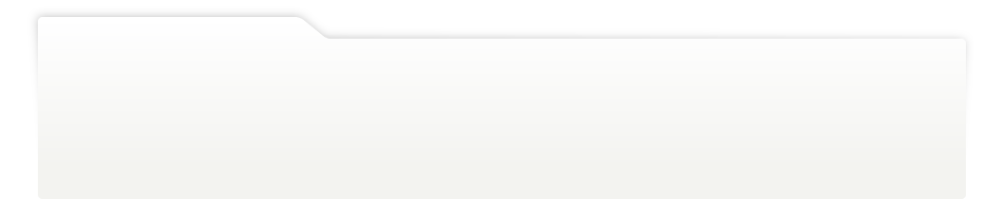
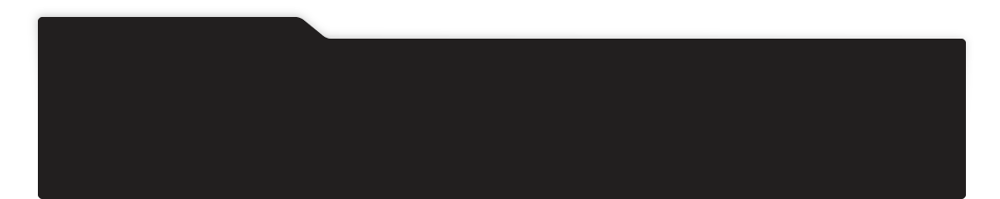
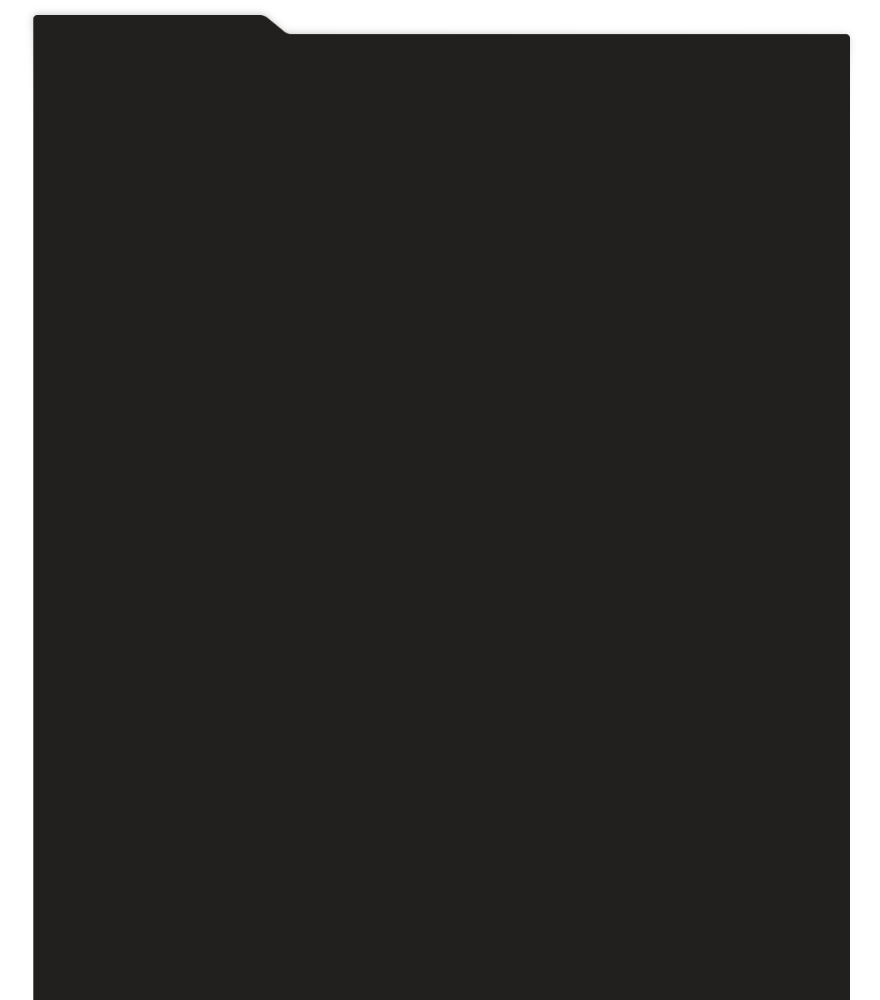
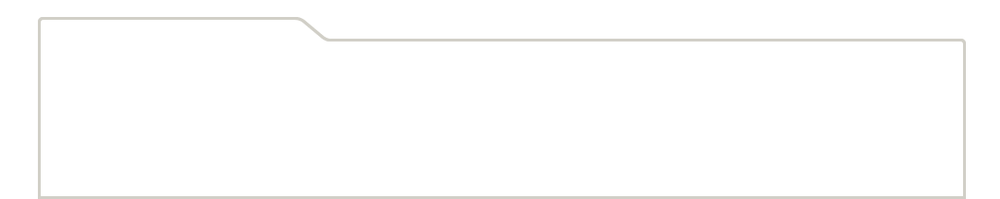
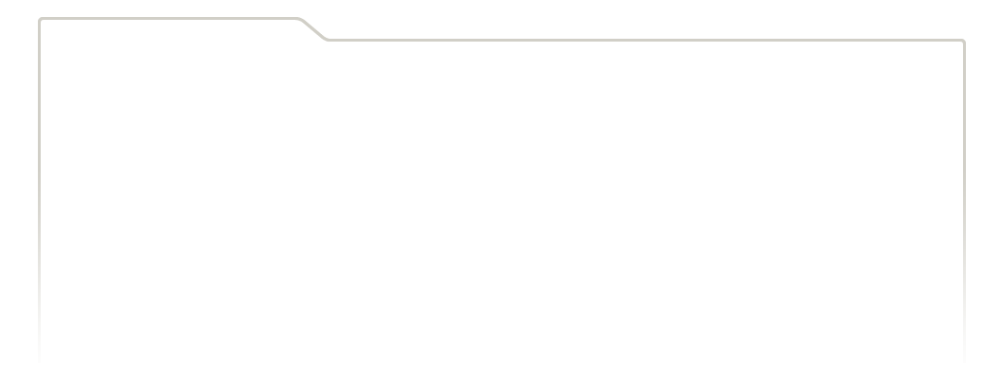
...
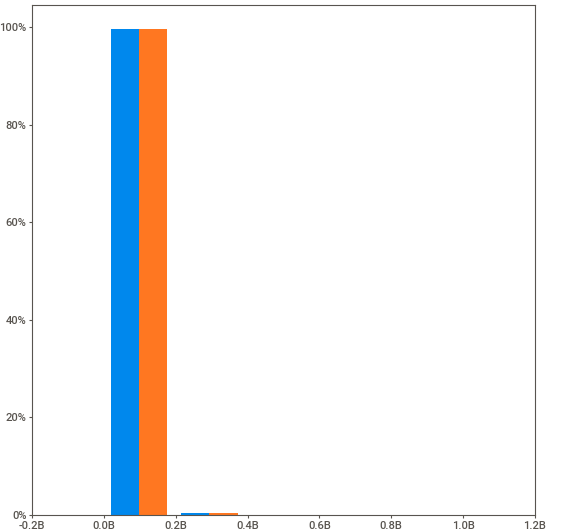
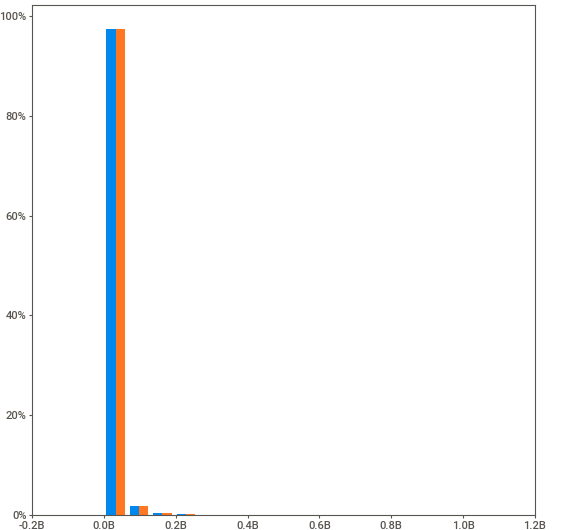
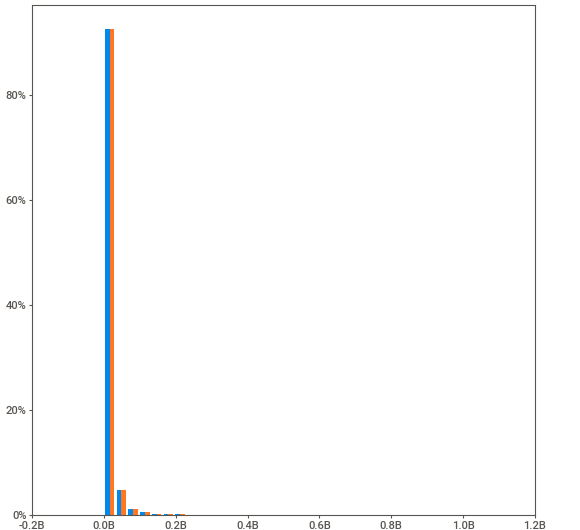
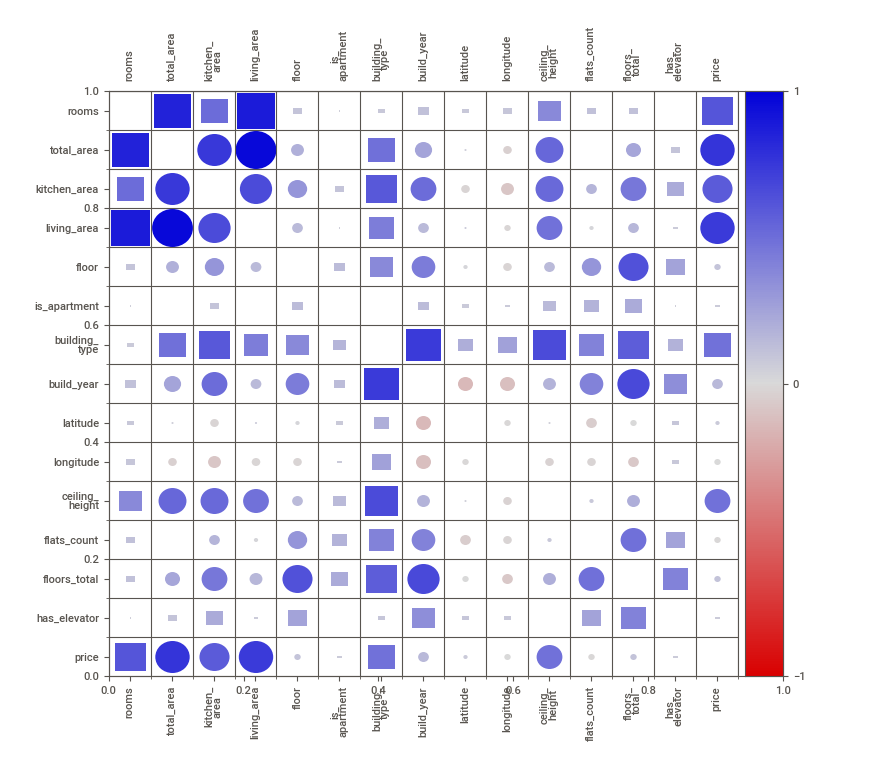
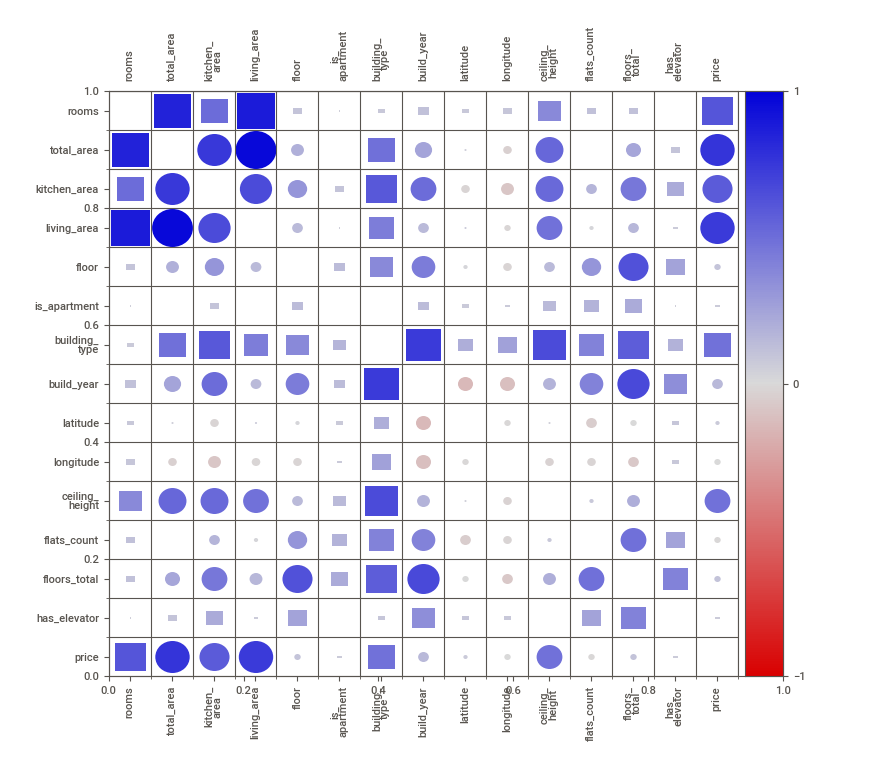

In [48]:
with open("../mlflow_server/outlier_params.yaml") as fd:
    outlier_params = yaml.safe_load(fd)
if outlier_params:
    report_floor = sv.compare(
        (data.drop(columns="id").drop_duplicates(keep="first"), "Вручную"),
        (
            OutlierProcessor(
                outlier_params=outlier_params,
                #verbose=True
            ).fit_transform(get_data()), 
            "Трансформер"
        )
    )
    report_floor.show_html(
        filepath=eda_assets("2_compare_sv.html", "reports"), 
        open_browser=False, layout="vertical")
    report_floor.show_notebook()

На первый взгляд распределение в датасетах выглядит идентично, однако можно обнаружить небольшие расхождения по значениям площади кухни и жилой, которые были заполнены медианой. Это связано с тем, что расчет медианы для площадей при обработке вручную производился до исключения выбросов по оставшимся признакам, а в трансформере производится после, что является более корректным.

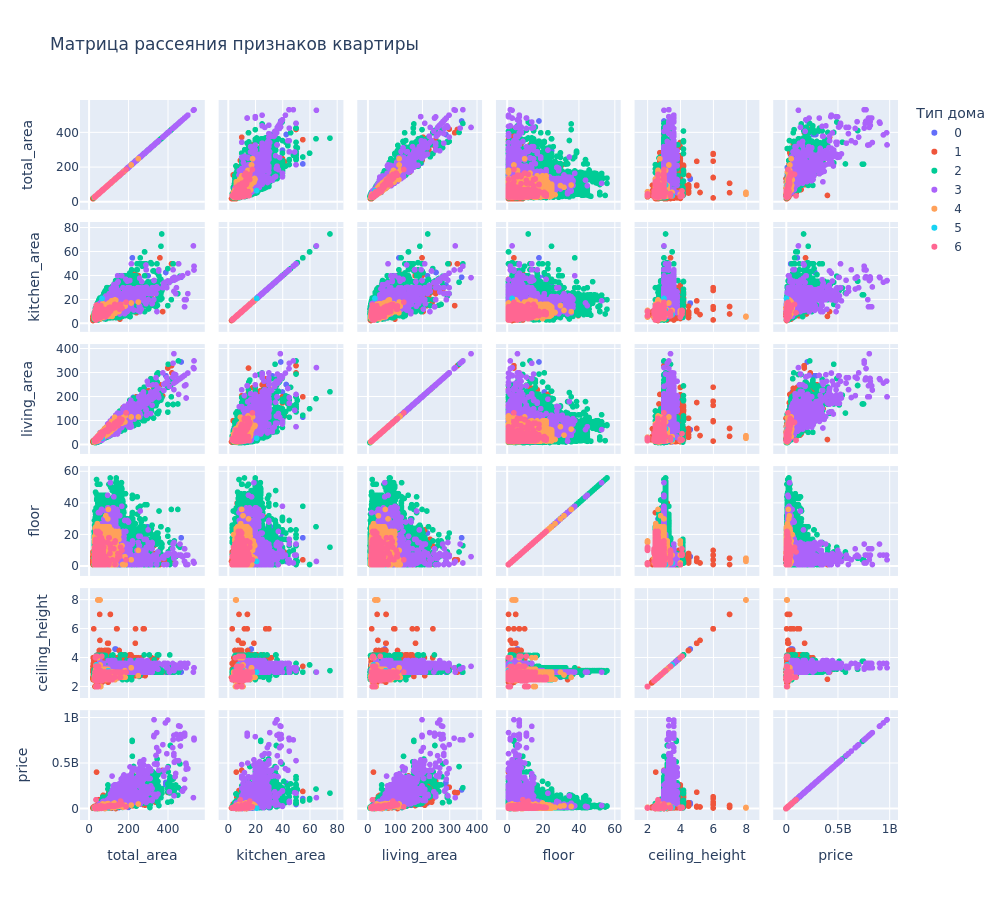

In [49]:
fig = px.scatter_matrix(
    data, dimensions=[
        "total_area", "kitchen_area", "living_area", "floor", "ceiling_height", "price"
    ], color="building_type", width=1000, height=900,
    title="Матрица рассеяния признаков квартиры",
    labels={"building_type": "Тип дома"},
    category_orders={"building_type":[str(x) for x in range(7)]}
)
fig.write_html(eda_assets("17_flats_scatter_matrix.html"))
fig.show(renderer="png")

По графику заметно, что наиболее высокие цены приходятся на квартиры большей площади, которые располагаются в домах типа 3 и 2. Другие типы домов существенно дешевле. Имеется довольно сильная линейная зависимость жилой площади от общей. По площади кухни имеется больший разброс относительно общей площади. 

Оценим признаки домов, в котором располагаются квартиры.

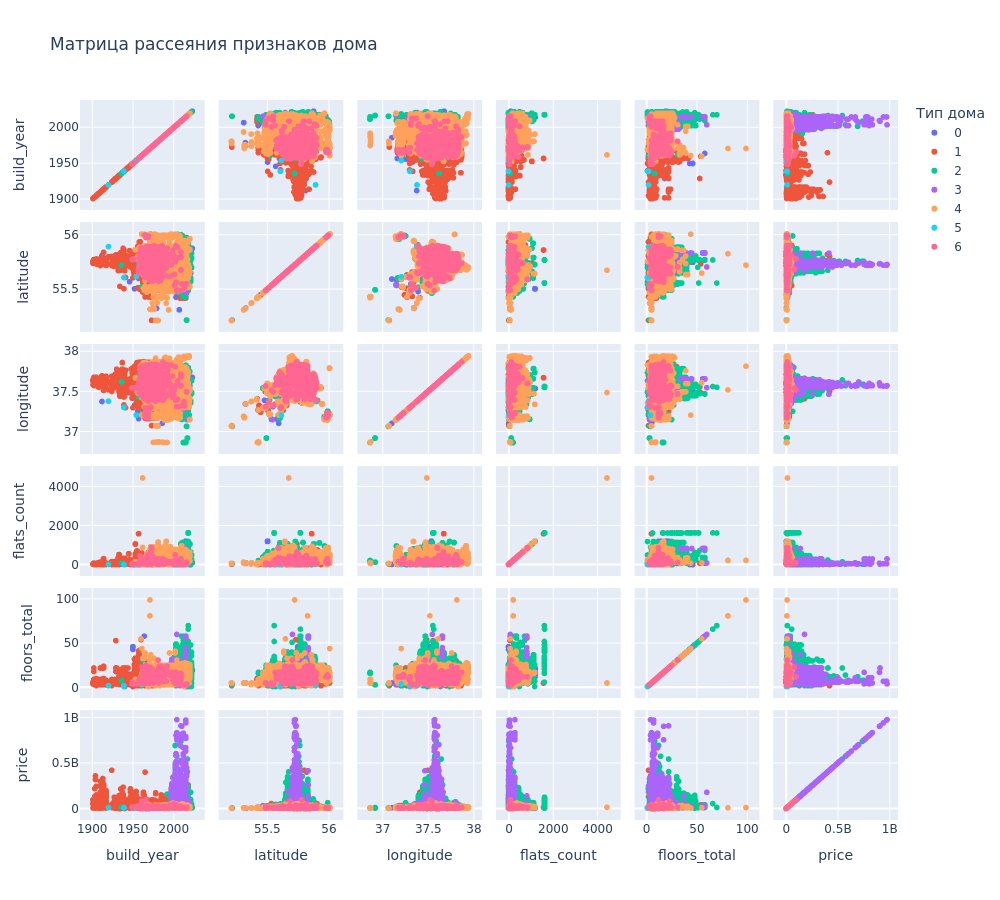

In [50]:
fig = px.scatter_matrix(
    data, dimensions=[
        "build_year", "latitude", "longitude", "flats_count", "floors_total", "price"
    ], color="building_type", width=1000, height=900,
    title="Матрица рассеяния признаков дома",
    labels={"building_type": "Тип дома"},
    category_orders={"building_type":[str(x) for x in range(7)]}
)
fig.write_html(eda_assets("18_buildings_scatter_matrix.html"))
fig.show(renderer="png")

По признакам дома можно отметить, что очень сильное влияние на цену квартиры оказывает местоположение дома - наибольшие цены располагаются вблизи центра города. Хорошо было бы добавить в датасет признак близости к центру города.

#### Выводы

По результатам проведенного исследовательского анализа данных произведено следующее:
1. Исключены дубликаты в данных;
2. Выявлены и исключены выбросы и редкие значения по следующим признакам:
    - количество комнат `rooms` за пределами межквартильного размаха в 1.5 IQR от Q1 и Q3; 
    - общая площадь `total_area` аналогичным статистическим методом в разрезе количества комнат и типов зданий;
    - целевой признак цены квартиры `price` исходя из цены за квадратный метр в разрезе количества комнат, типов зданий и местоположения объекта методом межквартильного размаха;
    - высота потолков `ceiling_height` путем исключения значений за пределами промежутка от 2-х до 10 метров;
    - в случае наличия пропусков в данных они исключаются из датасета.
3. Проведена обработка вероятно некорректных значений признаков площади кухни `kitchen_area` и жилой площади `living_area`, которая производилась также методом межквартильного размаха, признанные выбросом значения установлены медианой по соотношению к общей площади в разрезе количества комнат и типов зданий.
4. Признак `building_type_int` не является  переименован в `building_type` и преобразован в категориальный.

Для автоматической обработки выбросов подготовлен трансформер и файл для параметров его работы. По результатам обработки признаков можно отметить следующее:
1. В части корреляции целевого признака с остальными:
    - наибольшая корреляция с признаком общей площади `total_area` (0.75), однако зависимость нелинейная и имеет довольно большой разброс;
    - также достаточно высокая корреляция по другим признакам площади `living_area` (0.73) и `kitchen_area` (0.56), однако данные признаким имеют достаточно большую зависимость друг от друга и признака `total_area`;
    - заметная корреляция с количеством комнат `rooms` (0.59), зависимость также нелинейная с большим разбросом;
    - умеренная корреляция с типом здания `building_type` (0.45);
    - также умеренная корреляция с высотой потолков `ceiling_height` (0.45); 
    - слабая корреляция с годом постройки `build_year` (0.11), по остальным признакам корреляция практически отсутствует;
    - средние цены квадратного метра в центральной части Москвы выше и снижаются по мере удаления.
2. В части мультиколлинеарности датасета:
    - очень высокая корреляция между признаками `total_area` и `living_area` - 0.97, что явно говорит о мультиколлинеарности;
    - довольно высокая корреляция признака `rooms` с признаками `living_area` (0.88) и `total_area` (0.85);
    - по признаку `building_type` имеется корреляция с большинством признаков датасета, в частности с `build_year` корреляция составляет 0.72, по остальным признакам ниже.

### 2.6 логирование артефактов в MLflow

#### Логирование результатов EDA и обработки выбросов

In [51]:
# Подключение к локальному серверу MLflow
mlflow.set_tracking_uri(MLFLOW_URI)
mlflow.set_registry_uri(MLFLOW_URI)

# получение ID эксперимента
if mlflow.get_experiment_by_name(EXPERIMENT_NAME):
    experiment_id = mlflow.get_experiment_by_name(EXPERIMENT_NAME).experiment_id
else:
    experiment_id = mlflow.create_experiment(EXPERIMENT_NAME)

In [52]:
# Получение обработчика выбросов
with open("../mlflow_server/outlier_params.yaml") as fd:
    outlier_params = yaml.safe_load(fd)
outlier_processor = OutlierProcessor(outlier_params=outlier_params)

# Получение исходных и обработанных данных
data = get_data()
clean_data = outlier_processor.fit_transform(data)

In [53]:
# Логирование артефактов EDA и трансформера
with mlflow.start_run(run_name="EDA and outlier processing", experiment_id=experiment_id) as run:
    # Логирование отчетов и графиков
    for filename, dirname in eda_assets.list:
        mlflow.log_artifact(filename, dirname)
    # Логирование ноутбука и md файла с выводами, которые
    # подготовлены отдельно на базе данного ноутбука
    mlflow.log_artifact("../mlflow_server/eda.ipynb", "notebook")
    mlflow.log_artifact("../mlflow_server/summary.md", "notebook")
    # Логирование обработчика выбросов    
    mlflow.log_artifact("../mlflow_server/outlier_params.yaml", "outlier_processor")
    mlflow.sklearn.log_model(
        sk_model=outlier_processor, 
        artifact_path="outlier_processor",
        signature=mlflow.models.infer_signature(
            model_input=data, model_output=clean_data
        ),
        input_example=data.sample(15, random_state=RANDOM_STATE),
    )
print("Run ID:", run.info.run_id)

2024-11-25 07:39:52,210 INFO: Found credentials in environment variables.
2024/11/25 07:39:55 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


Run ID: e5631e0e62e44d008f4e131c9d03084f


#### Разделение датасета

Получим сырые данные, обработаем их подготовленным трансформером и разобьем на тренировочную и тестовую выборки. Оценку модели будем проводить с применением кросс-валидации на тренировочной выборке.

In [54]:
train, test = train_test_split(clean_data, test_size=TEST_SIZE, random_state=RANDOM_STATE)
train.reset_index(drop=True, inplace=True)
test.reset_index(drop=True, inplace=True)
print("Размер тренировочной выборки:", train.shape)
print("Размер тестовой выборки:", test.shape)
del data, clean_data

Размер тренировочной выборки: (93689, 15)
Размер тестовой выборки: (31230, 15)


#### Подготовка трансформера

При проведении исследовательского анализа были определены следующие категориальные признаки - тип здания `building_type`, апартаменты `is_apartment`, наличие лифта `has_elevator`. Признак  студии `studio` был исключен, так как подобные значения отсутствуют в выборке и обучать модель по такому признаку не имеет смысла. Из категориальных признаков только `building_type` не является бинарным. Остальные признаки являются числовыми.

Разделим признаки на бинарные, категориальные и числовые, а также выделим целевой признак.

In [55]:
target = "price"
bin_features = train.select_dtypes(include="boolean").columns.to_list()
cat_features = train.select_dtypes(include="object").columns.to_list()
num_features = [x for x in train.columns if x not in [target, *bin_features, *cat_features]]
print("Количество признаков в датасете:", train.columns.shape[0])
print("Бинарные признаки:", bin_features)
print("Категориальные признаки:", cat_features)
print("Числовые признаки:", num_features)
print("Количество признаков после разделения:", len([target, *bin_features, *cat_features, *num_features]))

Количество признаков в датасете: 15
Бинарные признаки: ['is_apartment', 'has_elevator']
Категориальные признаки: ['building_type']
Числовые признаки: ['rooms', 'total_area', 'kitchen_area', 'living_area', 'floor', 'build_year', 'latitude', 'longitude', 'ceiling_height', 'flats_count', 'floors_total']
Количество признаков после разделения: 15


Бинарные признаки закодируем посредством OneHotEncoder. Так как единственный категориальный признак не является порядковым, а количество значений небольшое, его также можно кодировать OneHotEncoder и это будет наилучшим выбором для большинства моделей, но в данном проекте закодируем его посредством CatBoostEncoder. Для некоторых простых моделей желательно закодировать числовые признаки, чтобы привести их к единому масштабу, однако в данном проекте планируется использование более продвинутых ансамблевых методов, основанных на деревьях решений, поэтому кодирование числовых признаков производиться не будет. Подготовим трансформер для кодирования признаков.

In [56]:
prep = ColumnTransformer(
    [
        ("bin", OneHotEncoder(
            drop="if_binary", sparse_output=False,
        ), bin_features),
        ("cat", CatBoostEncoder(return_df=True), cat_features)
    ], remainder="passthrough"
)
prep

ColumnTransformer(remainder='passthrough',
                  transformers=[('bin',
                                 OneHotEncoder(drop='if_binary',
                                               sparse_output=False),
                                 ['is_apartment', 'has_elevator']),
                                ('cat', CatBoostEncoder(), ['building_type'])])

#### Обучение модели и логирование в MLflow

В результате подготовки данных были исключены выбросы значений признаков, поэтому наиболее предпочтительной метрикой можно выбрать RMSE, результаты можно дополнительно оценивать метрикой MAPE, чтобы понимать расхождение в процентном соотношении. В качестве модели машинного обучения можно выбрать и простые, однако лучше остановиться на ансамблевых методах, наиболее точными из которых являются бустинговые модели. Из бустинговых моделей наибольшую популярность имеют XGBoost, LightGBM и CatBoost. 

Несмотря на то, что категориальных признаков немного и данные подготовлены для работы любых моделей, воспользуемся моделью CatBoost так как она обладает высокой точностью и простотой настройки параметров. При этом данных не так много, чтобы делать выбор в пользу более быстрых моделей бустинга.

- Метрики: **RMSE**, **MAPE**.
- Модель: **CatBoostRegressor**

In [57]:
model = CatBoostRegressor(verbose=0, random_seed=RANDOM_STATE, thread_count=-1)
pipeline = Pipeline([
    ("preprocessor", prep),
    ("model", model)
])
pipeline

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('bin',
                                                  OneHotEncoder(drop='if_binary',
                                                                sparse_output=False),
                                                  ['is_apartment',
                                                   'has_elevator']),
                                                 ('cat', CatBoostEncoder(),
                                                  ['building_type'])])),
                ('model',
                 <catboost.core.CatBoostRegressor object at 0x7fd0e81756f0>)])

Проведем обучение baseline-модели на тренировочной выборке с кросс-валидацией.

In [58]:
cv_result = cross_validate(
    pipeline, train.drop(columns=target), train[target], 
    cv=CV, scoring=SCORING
)
print(f"Среднее время обучения на кросс-валидации: {np.mean(cv_result['fit_time']):.2f}")
print(f"Среднее время предсказания на кросс-валидации: {np.mean(cv_result['score_time']):.2f}")
print(f"RMSE на кросс-валидации: {-np.mean(cv_result['test_neg_root_mean_squared_error']):,.2f}")
print(f"MAPE на кросс-валидации: {-np.mean(cv_result['test_neg_mean_absolute_percentage_error']):.1%}")

Среднее время обучения на кросс-валидации: 6.67
Среднее время предсказания на кросс-валидации: 0.11
RMSE на кросс-валидации: 8,714,089.04
MAPE на кросс-валидации: 27.3%


При кросс-валидации среднее время обучения модели составляет около 11 секунд, предсказания - менее 1 секунды. Получим метрики на тестовой выборке для сравнения и оценки.

In [59]:
pipeline.fit(train.drop(columns=target), train[target])
test_pred = pipeline.predict(test.drop(columns=target))
metrics = {
    "cv_rmse": -np.mean(cv_result["test_neg_root_mean_squared_error"]),
    "cv_mape": -np.mean(cv_result["test_neg_mean_absolute_percentage_error"]),
    "test_rmse": mean_squared_error(test[target], test_pred, squared=False),
    "test_mape": mean_absolute_percentage_error(test[target], test_pred)
}
print(f"RMSE: {metrics['test_rmse']:,.2f}")
print(f"MAPE: {metrics['test_mape']:.1%}")

RMSE: 8,759,630.63
MAPE: 53.5%


Значение метрики MAPE говорит о том, что на тестовой выборке модель в среднем ошибается чуть больше чем на 53.5%, хотя на тренировочных данных при кросс-валидации эти значения существенно лучше. При этом значение метрики RMSE достаточно близкое. Это может говорить о том, что имеется довольно сильный разброс данных, либо имеется дисбаланс тренировочной и тестовой выборки, вследствие чего модель ошибается на более низких значениях на тествой выборке сильнее, чем на тренировочной.

Взглянем на дисперсию остатков для тестовой выборки.

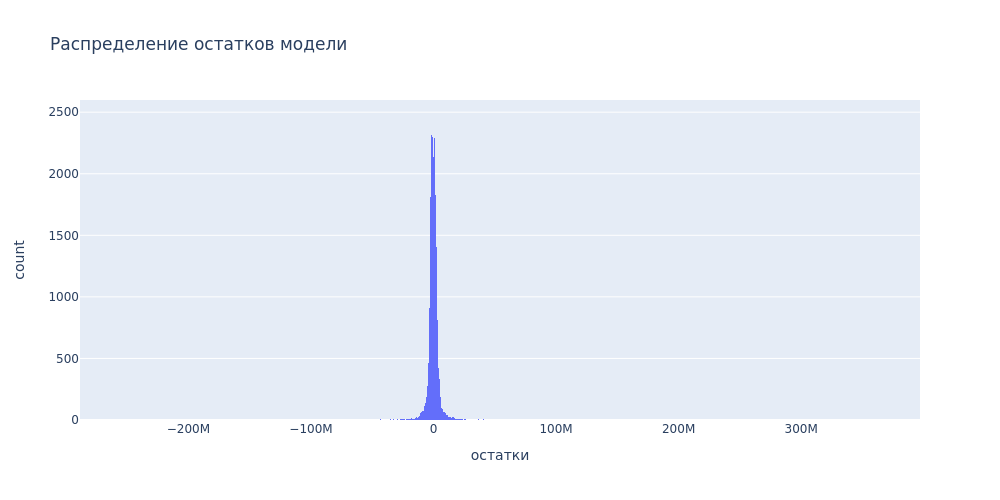

In [60]:
model_assets = AssetFiles(init_dir="EDA_ASSETS", default_dir="plots")
fig = px.histogram(
    test[target] - test_pred,
    labels={"count": "количество", "value": "остатки"},
    title="Распределение остатков модели"
)
fig.update_traces(showlegend=False) 
fig.write_html(model_assets("baseline_residual_distr.html"))
fig.show(renderer="png", width=1000)

По графику заметно, что основная масса остатков находится вблизи нулевого значения, однако имеются довольно большие отклонения от фактических значений как в большую, так и в меньшую сторону. Взглянем на дисперсию остатков.

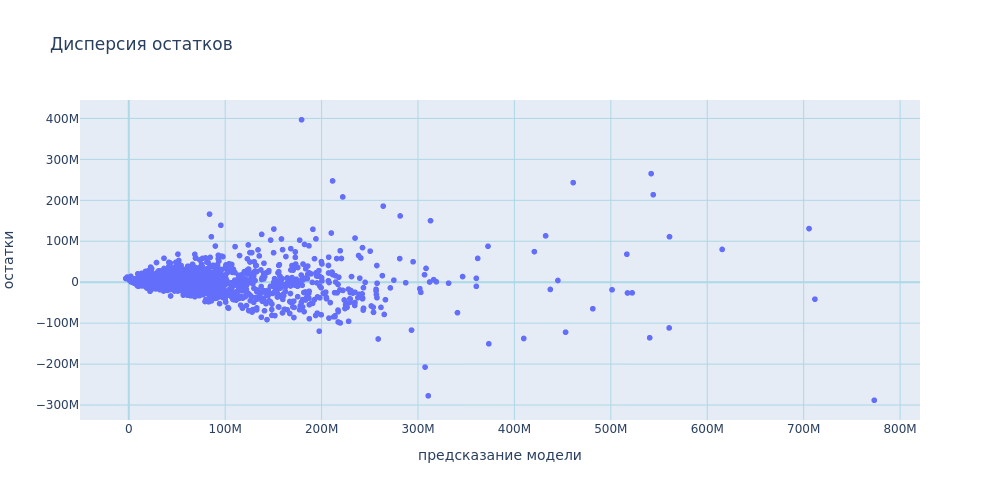

In [61]:
fig = px.scatter(
    x=test_pred, y=test[target] - test_pred, 
    labels={"x": "предсказание модели", "y": "остатки"},
    title="Дисперсия остатков"
)
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='LightBlue', zerolinecolor="LightBlue")
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='LightBlue', zerolinecolor="LightBlue")
fig.write_html(model_assets("baseline_residual_variance.html"))
fig.show(renderer="png", width=1000)

Расхождения для более низких предсказаний не такие большие, причем заметно, что модель предсказывает также и отрицательные значения. Для самых низких предсказаний модель очевидно их занижает. Для более высоких предсказаний стоимости модель ошибается больше, причем чаще завышает предсказания. Явно выделяются сильные отклонения в предсказании модели, которые вероятнее всего влияют на достаточно плохие значения MAPE на тестовой выборке:
- имеется очень заниженное предсказание модели - до 200 млн., что ниже фактической на ~400 млн.;
- имеется несколько завышенных предсказаний модели в районе 300 млн. и более 700 млн. завышены на 200-300 млн.

Зарегистрируем модель в MLflow с логированием метрик и графиков.

In [62]:
# Получение дополнительной информации
signature = mlflow.models.infer_signature(train.drop(columns=target), train[target])
prep_input_example = train.drop(columns=target).sample(15, random_state=RANDOM_STATE)
model_input_example = pd.DataFrame(
    pipeline["preprocessor"].transform(train.drop(columns=target)),
    columns=pipeline["preprocessor"].get_feature_names_out()
)

with mlflow.start_run(run_name="Baseline model", experiment_id=experiment_id) as run:
    # Логирование препроцессора
    mlflow.sklearn.log_model(
        sk_model=pipeline["preprocessor"],
        artifact_path="preprocessor",
        input_example=prep_input_example,
        signature=False
    )
    # Логирование артифактов и метрик
    for filename, dirname in model_assets.list:
        mlflow.log_artifact(filename, dirname)
    mlflow.log_metrics(metrics)
    # Логирование модели
    mlflow.catboost.log_model(
        pipeline["model"], 
        artifact_path="model",
        registered_model_name=REGISTRY_MODEL_NAME,
        signature=signature,
        input_example=model_input_example,
        await_registration_for=60,
        pip_requirements="../requirements.txt",
    )
print("Run ID:", run.info.run_id)

2024/11/25 07:40:36 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!
Successfully registered model 'flats_model_zrx'.
2024/11/25 07:40:41 INFO mlflow.tracking._model_registry.client: Waiting up to 60 seconds for model version to finish creation. Model name: flats_model_zrx, version 1


Run ID: 9d082016c8174282ba811e9450339206


Created version '1' of model 'flats_model_zrx'.


### Промежуточные итоги

В рамках 2 этапа проведен исследовательский анализ данных (EDA). По результатам анализа выявлено наличие дубликатов, которые были исключены. Также исключены записи, значения которых имеют большие отклонения или очень редкие значения по количеству комнат `rooms`, общей площади `total_area`, высоте потолков `ceiling_height` и по целевому признаку цены `price`. Обработка выбросов осуществлялась на базе статистического метода межквартильных интервалов (IQR), выбросами определены все значения за пределами 1.5-кратного межквартильного интервала от первого (Q1) и третьего (Q3). При этом для общей площади и цены за квадратный метр определение межквартильного интервала произведено в разрезе количества комнат и типа здания, а для целевого признака дополнительно в разрезе местоположения. 

Также на базе данного метода определены вероятно некорректные значения жилой площади и кухни исходя из их отношения к общей площади. Все такие значения были исправлены на медиану. Признак `building_type_int` переведен в строковый и переименован в `building_type` для возможности в дальнейшем обрабатывать его как категориальный.

Высота потолков была ограничена в промежутке от 2 до 10 метров. Исключен признак `studio`, все значения которого являлись `False`.

По результатам анализа подготовлен sklearn трансформер для обработки выбросов, произведено логирование трансформера в MLFlow вместе с графиками и отчетами EDA. Также произведено кодирование данных - бинарные признаки кодированы посредством `OneHotEncoder`, а категориальный признак `building_type` посредством `CatBoostEncoder`. Подготовлен отдельный ноутбук, в который включен только этап EDA с обработкой выбросов. Ноутбук, отчеты и графики, а также трансформер для обработки выбросов логированы в MLflow.

Подготовлен паплайн с енкодером признаков и baseline-моделью `CatBoost`, произведено и обучение модели. На тестовой выборке получены метрики базовой модели а также проведена оценка остатков. Обученная модель, полученные метрики `RMSE` и `MAPE`, а также графики распределения и дисперсии остатков логированы в MLflow.

Результаты модели на тестовой выборке:
- **RMSE: 8.76 млн.** 
- **MAPE: 53.5%**

In [63]:
del eda_assets, model_assets, cv_result, pipeline, model, test_pred, metrics, signature, report_floor, outlier_params, outlier_processor
gc.collect()

267974

## Этап 3: Генерация Признаков и обучение новой версии модели

### 3.1 Ручная генерация признаков

По результатам проведенного EDA в части подготовки дополнительных признаков можно отметить следующее:
- признаки количества комнат и площади имеют нелинейное отношение к целевому, вероятно наличие степенной зависимости. Цена существенно повышается по мере увеличения значения этих признаков.
- возможно более оптимальным вариантом было бы использование не фактического значения признаков площади кухни `kitchen_area` и жилой площади `living_area`, а относительное к общей площади `total_area`;
- для некоторых моделей могут быть полезны признаки нахождения на первом и последнем этажах, однако для моделей, основанных на деревьях решений выделение такого признака не имеет большого значения;
- признак количества этажей в зании можно преобразовать в классы по высоте - небольшой этажности, более высокие и высотки;
- также вероятно полезным может быть плотность квартир на этаж - `flats_count` / `floors_total` или другое их соотношение. Возможно более оптимальным была бы плотность квартир на этаж в подъезде, однако в датасете отсутствуют сведения о количестве подъездов в доме;
- полезными могут быть сведения о наличии лифта на высоких этажах, однако, вероятнее всего, в датасете имеются ошибки в таких сведениях. При этом можно отметить различие средней цены для квартир до 5-го этажа включительно и квартир выше 5-го этажа, в зданиях без лифта;
- в части картографических данных было бы полезно иметь сведения о расстоянии до до центра города , а также до наиболее социально значимых объектов - станции метро, школы, парки и т.д. Однако такие сведения отсутствуют в датасете;
- вероятно имеются и другие сложные или скрытые зависимости между признаками, которые могут быть сгенерированы автоматически.

In [64]:
# Добавление степени к признакам и их взаимодействия
encoder_pol = PolynomialFeatures(degree=3, include_bias=False)
encoded_features = encoder_pol.fit_transform(train[["total_area", "rooms"]])
pd.DataFrame(encoded_features, columns=encoder_pol.get_feature_names_out())

,total_area,rooms,total_area^2,total_area rooms,rooms^2,total_area^3,total_area^2 rooms,total_area rooms^2,rooms^3
0,59.90,2.00,3588.01,119.80,4.00,214921.82,7176.02,239.60,8.00
1,45.50,2.00,2070.25,91.00,4.00,94196.38,4140.50,182.00,8.00
2,50.60,2.00,2560.36,101.20,4.00,129554.20,5120.72,202.40,8.00
3,68.00,2.00,4624.00,136.00,4.00,314432.00,9248.00,272.00,8.00
4,145.00,5.00,21025.00,725.00,25.00,3048625.00,105125.00,3625.00,125.00
...,...,...,...,...,...,...,...,...,...
93684,46.00,2.00,2116.00,92.00,4.00,97336.00,4232.00,184.00,8.00
93685,110.00,4.00,12100.00,440.00,16.00,1331000.00,48400.00,1760.00,64.00
93686,40.00,2.00,1600.00,80.00,4.00,64000.00,3200.00,160.00,8.00
93687,81.40,3.00,6625.96,244.20,9.00,539353.17,19877.88,732.60,27.00


Разделим признак высоты здания на 3 группы.

In [65]:
encoder_kbd = KBinsDiscretizer(n_bins=3, encode="ordinal", strategy="quantile", random_state=RANDOM_STATE)
encoded_features = encoder_kbd.fit_transform(train[["floors_total"]])
pd.DataFrame(
    encoded_features, columns=encoder_kbd.get_feature_names_out()
).join(train[["floors_total"]], rsuffix="_origin").groupby("floors_total")["floors_total_origin"].max()

floors_total
0.00     9
1.00    16
2.00    99
Name: floors_total_origin, dtype: int64

По количеству этажей выделились три группы - до 9 этажей, до 16 этажей, а также выше 16 этажей.

### 3.2 Оборачивание всех преобразований в объекты sklearn

In [66]:
new_feat = ColumnTransformer([
    ("pol", encoder_pol, ["total_area", "rooms"]),
    ("kbd", encoder_kbd, ["floors_total"]),
    ("cat", CatBoostEncoder(return_df=False), cat_features)
], remainder="passthrough")
pd.DataFrame(
    new_feat.fit_transform(train.drop(columns=target), train[target]),
    columns=new_feat.get_feature_names_out()
)

,pol__total_area,pol__rooms,pol__total_area^2,pol__total_area rooms,pol__rooms^2,pol__total_area^3,pol__total_area^2 rooms,pol__total_area rooms^2,pol__rooms^3,kbd__floors_total,...,remainder__kitchen_area,remainder__living_area,remainder__floor,remainder__is_apartment,remainder__build_year,remainder__latitude,remainder__longitude,remainder__ceiling_height,remainder__flats_count,remainder__has_elevator
0,59.90,2.00,3588.01,119.80,4.00,214921.82,7176.02,239.60,8.00,2.00,...,10.20,34.50,7,False,1993,55.66,37.45,2.64,249,True
1,45.50,2.00,2070.25,91.00,4.00,94196.38,4140.50,182.00,8.00,0.00,...,6.00,32.00,5,False,1966,55.81,37.82,2.64,68,True
2,50.60,2.00,2560.36,101.20,4.00,129554.20,5120.72,202.40,8.00,2.00,...,8.40,30.50,3,False,1984,55.86,37.59,2.64,320,True
3,68.00,2.00,4624.00,136.00,4.00,314432.00,9248.00,272.00,8.00,0.00,...,9.00,42.34,5,False,1953,55.74,37.49,3.00,54,False
4,145.00,5.00,21025.00,725.00,25.00,3048625.00,105125.00,3625.00,125.00,0.00,...,17.00,98.00,3,False,1946,55.78,37.56,3.20,117,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93684,46.00,2.00,2116.00,92.00,4.00,97336.00,4232.00,184.00,8.00,1.00,...,6.50,29.20,1,False,1978,55.87,37.65,2.50,191,True
93685,110.00,4.00,12100.00,440.00,16.00,1331000.00,48400.00,1760.00,64.00,1.00,...,10.00,63.10,6,False,1995,55.68,37.49,3.00,182,True
93686,40.00,2.00,1600.00,80.00,4.00,64000.00,3200.00,160.00,8.00,1.00,...,6.20,23.50,8,False,1965,55.84,37.66,2.64,96,True
93687,81.40,3.00,6625.96,244.20,9.00,539353.17,19877.88,732.60,27.00,0.00,...,8.60,52.70,3,False,1961,55.81,37.60,3.00,223,True


### 3.3 Автоматическая генерация признаков

Автоматическую генерацию признаков произведем для числовых признаков, за исключением местоположения, а также площади кухни и жилой. Генерацию признаков произведем посредством библиотеки autofeat, которая позволяет подобрать признаки путем их математических преобразований признаков и их комбинаций для выявления сложных закономерностей.

In [67]:
autofeat_file = os.path.sep.join(["FE_ASSETS", "autofeat.pkl"])
if os.path.exists(autofeat_file):
    with open(autofeat_file, "rb") as fd:
        auto_feat = joblib.load(fd)
else:
    auto_feat = AutoFeatRegressor(
        categorical_cols=bin_features,
        feateng_cols=[
            "total_area", "living_area", "kitchen_area",
            "ceiling_height", "rooms", "flats_count", 
            "floor", "floors_total"
        ],
        transformations=("1/", "log", "sqrt"),
        feateng_steps=2, featsel_runs=5, n_jobs=-1, max_gb=1
    )
    # Обучение autofeat
    auto_feat.fit(train.drop(columns=target), train[target])
    # Сохранение дампа на диск для воспроизводимости
    with open(autofeat_file, "wb") as fd:
        joblib.dump(auto_feat, fd)
del autofeat_file

Проверим автоматическую генерацию новых признаков.

In [68]:
print(
    "Новые столбцы:",
    auto_feat.transform(
        train.drop(columns=target)
    ).columns[15]
)

Новые столбцы: cat_has_elevator_True


### 3.4 Обучение новой версии модели

In [69]:
# Обучение на новых признаках после autofeat
new_feat.fit(
    auto_feat.transform(train.drop(columns=target)), 
    train[target])
# Пайплайн для геренации новых признаков, 
# первый autofeat так как он зафиксирован
feat_processor = Pipeline([
    ("autofeat", auto_feat),
    ("newfeat", new_feat)
])

new_feat_train = pd.DataFrame(
    feat_processor.transform(train.drop(columns=target)),
    columns=feat_processor["newfeat"].get_feature_names_out()
)
feat_signature = mlflow.models.infer_signature(
    train.drop(columns=target),
    new_feat_train
)
prep_input_example = train.drop(columns=target).sample(15, random_state=RANDOM_STATE)
model_signature = mlflow.models.infer_signature(new_feat_train, train[target])
model_input_example = new_feat_train.sample(15, random_state=RANDOM_STATE)
new_feat_train

,pol__total_area,pol__rooms,pol__total_area^2,pol__total_area rooms,pol__rooms^2,pol__total_area^3,pol__total_area^2 rooms,pol__total_area rooms^2,pol__rooms^3,kbd__floors_total,...,remainder__1/(kitchen_area*rooms),remainder__floors_total/living_area,remainder__floors_total/kitchen_area,remainder__log(floors_total)/total_area,remainder__1/(flats_count*floors_total),remainder__1/(floors_total*kitchen_area),remainder__sqrt(flats_count)/floors_total,remainder__log(flats_count)/ceiling_height,remainder__sqrt(floors_total)*kitchen_area,remainder__sqrt(kitchen_area)/ceiling_height
0,59.90,2.00,3588.01,119.80,4.00,214921.82,7176.02,239.60,8.00,2.00,...,0.05,0.64,2.16,0.05,0.00,0.00,0.72,2.09,47.84,1.21
1,45.50,2.00,2070.25,91.00,4.00,94196.38,4140.50,182.00,8.00,0.00,...,0.08,0.28,1.50,0.05,0.00,0.02,0.92,1.60,18.00,0.93
2,50.60,2.00,2560.36,101.20,4.00,129554.20,5120.72,202.40,8.00,2.00,...,0.06,0.56,2.02,0.06,0.00,0.01,1.05,2.18,34.63,1.10
3,68.00,2.00,4624.00,136.00,4.00,314432.00,9248.00,272.00,8.00,0.00,...,0.06,0.12,0.56,0.02,0.00,0.02,1.47,1.33,20.12,1.00
4,145.00,5.00,21025.00,725.00,25.00,3048625.00,105125.00,3625.00,125.00,0.00,...,0.01,0.06,0.35,0.01,0.00,0.01,1.80,1.49,41.64,1.29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93684,46.00,2.00,2116.00,92.00,4.00,97336.00,4232.00,184.00,8.00,1.00,...,0.08,0.41,1.85,0.05,0.00,0.01,1.15,2.10,22.52,1.02
93685,110.00,4.00,12100.00,440.00,16.00,1331000.00,48400.00,1760.00,64.00,1.00,...,0.03,0.22,1.40,0.02,0.00,0.01,0.96,1.73,37.42,1.05
93686,40.00,2.00,1600.00,80.00,4.00,64000.00,3200.00,160.00,8.00,1.00,...,0.08,0.51,1.94,0.06,0.00,0.01,0.82,1.73,21.48,0.94
93687,81.40,3.00,6625.96,244.20,9.00,539353.17,19877.88,732.60,27.00,0.00,...,0.04,0.13,0.81,0.02,0.00,0.02,2.13,1.80,22.75,0.98


In [70]:
np.random.seed(RANDOM_STATE)
random.seed(RANDOM_STATE)
# Модель
model = CatBoostRegressor(verbose=0, random_seed=RANDOM_STATE, thread_count=-1)

# Кросс-валидация
cv_result = cross_validate(
    model, new_feat_train, train[target].to_numpy(), 
    cv=CV, scoring=SCORING
)
print(f"Среднее время обучения на кросс-валидации: {np.mean(cv_result['fit_time']):.2f}")
print(f"Среднее время предсказания на кросс-валидации: {np.mean(cv_result['score_time']):.2f}")
print(f"RMSE на кросс-валидации: {-np.mean(cv_result['test_neg_root_mean_squared_error']):,.2f}")
print(f"MAPE на кросс-валидации: {-np.mean(cv_result['test_neg_mean_absolute_percentage_error']):.1%}")
metrics = {
    "cv_rmse": -np.mean(cv_result["test_neg_root_mean_squared_error"]),
    "cv_mape": -np.mean(cv_result["test_neg_mean_absolute_percentage_error"])
}
del cv_result

Среднее время обучения на кросс-валидации: 13.96
Среднее время предсказания на кросс-валидации: 0.13
RMSE на кросс-валидации: 8,479,520.31
MAPE на кросс-валидации: 27.2%


Среднее время обучения модели при кросс-валидации по датасету со сгенерированными признаками составляет порядка 25 секунд. Предсказание производится со скоростью сравнимой с базовой моделью. Метрика RMSE показывает значительно лучший результат, MAPE незначительно улучшилась по сравнению с Baseline-моделью. Оценим метрику на тестовой выборке.

In [71]:
gc.collect()
# Обучение модели и получение метрик на тестовой выборке
model.fit(new_feat_train, train[target].to_numpy())
new_feat_test = feat_processor.transform(test.drop(columns=target))
test_pred = model.predict(new_feat_test)
# Сохранение метрик
metrics["test_rmse"] = mean_squared_error(test[target], test_pred, squared=False)
metrics["test_mape"] = mean_absolute_percentage_error(test[target], test_pred)
print(f"RMSE: {metrics['test_rmse']:,.2f}")
print(f"MAPE: {metrics['test_mape']:.1%}")

RMSE: 8,513,477.69
MAPE: 51.7%


Метрики также улучшились и на тестовой выборке в сравнении с базовой моделью. Оценим распределение остатков.

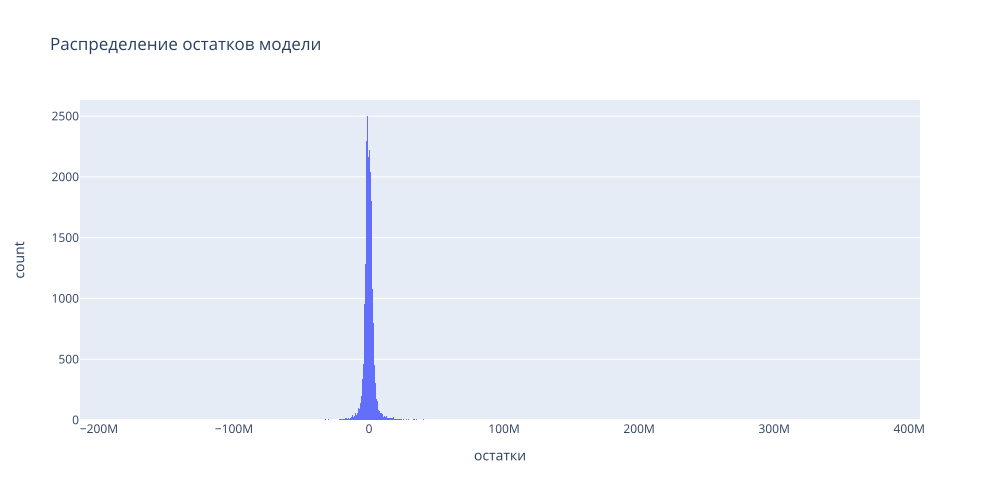

In [72]:
model_assets = AssetFiles(init_dir="FE_ASSETS", default_dir="plots")
fig = px.histogram(
    test[target] - test_pred,
    labels={"count": "количество", "value": "остатки"},
    title="Распределение остатков модели"
)
fig.update_traces(showlegend=False) 
fig.write_html(model_assets("feateng_residual_distr.html"))
fig.show(renderer="svg", width=1000)

Распределение остатков близко к таковому для базовой модели, однако заметен сдвиг к более высоким значениям. Большие отклонения остались.

Оценим дисперсию остатков. 

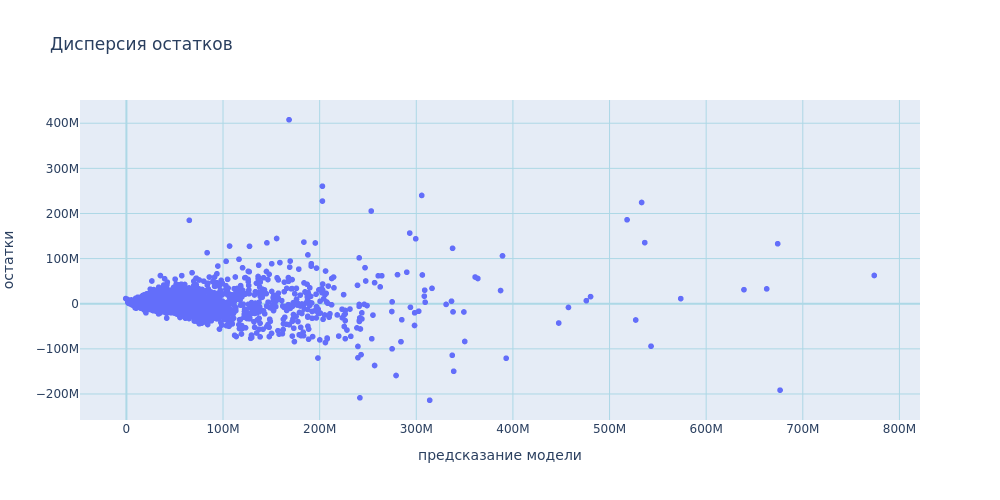

In [73]:
fig = px.scatter(
    x=test_pred, y=test[target] - test_pred, 
    labels={"x": "предсказание модели", "y": "остатки"},
    title="Дисперсия остатков"
)
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='LightBlue', zerolinecolor="LightBlue")
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='LightBlue', zerolinecolor="LightBlue")
fig.write_html(model_assets("feateng_residual_variance.html"))
fig.show(renderer="png", width=1000)

Дисперсия остатков новой модели близка к базовой модели - на самых низких предсказаниях они в основном занижены, на более высоких чаще завышены. Максимальные отклонения достаточно близки к значениям базовой модели, однако модель стала больше занижать предсказания. Также разброс остатков для самых высоких предсказаний стал меньше.

### 3.5 Логирование артефактов в MLflow

In [74]:
with mlflow.start_run(run_name="Feature engineering", experiment_id=experiment_id) as run:
    # Логирование препроцессора
    mlflow.sklearn.log_model(
        sk_model=feat_processor,
        artifact_path="feat_processor",
        signature=feat_signature,
        input_example=prep_input_example
    )
    # Логирование артифактов и метрик
    for filename, dirname in model_assets.list:
        mlflow.log_artifact(filename, dirname)
    mlflow.log_metrics(metrics)
    # Логирование модели
    mlflow.catboost.log_model(
        model, 
        artifact_path="model",
        registered_model_name=REGISTRY_MODEL_NAME,
        signature=model_signature,
        input_example=model_input_example,
        await_registration_for=60,
        pip_requirements="../requirements.txt",
    )
print("Run ID:", run.info.run_id)

2024/11/25 07:42:08 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!
2024/11/25 07:42:10 WARNING mlflow.models.model: Logging model metadata to the tracking server has failed. The model artifacts have been logged successfully under s3://s3-student-mle-20240822-6db01ad632/1/e13cc44b9f9a4b8a94e4ba81b034504b/artifacts. Set logging level to DEBUG via `logging.getLogger("mlflow").setLevel(logging.DEBUG)` to see the full traceback.
Registered model 'flats_model_zrx' already exists. Creating a new version of this model...
2024/11/25 07:42:11 INFO mlflow.tracking._model_registry.client: Waiting up to 60 seconds for model version to finish creation. Model name: flats_model_zrx, version 2


Run ID: e13cc44b9f9a4b8a94e4ba81b034504b


Created version '2' of model 'flats_model_zrx'.


### Промежуточные итоги

В рамках 3 этапа подготовлены 2 преобразователя на базе `sklearn`. 
1. `PolynomialFeatures` для генерации полиномиальных комбинаций признаков общей площади `total_area` и количества комнат `rooms` до степени `3`.
2. `KBinsDiscretizer` для автоматизированного разделения этажности зданий на 3 группы:
- до 9 этажей включительно;
- до 16 этажей включительно;
- свыше 16 этажей.

Дополнительно для оценки других возможных скрытых зависимостей генерируются новые признаки посредством библиотеки `autofeat`. Функции включены в единый пайплайн для генерации и кодирования признаков, общее количество признаков после генерации составило `67`. Произведено обучение новой версии модели и получены метрики на тренировочной и тестовой выборках, которые незначительно улучшились по сравнению с базовой моделью. Результаты предсказаний, трансформер для генерации и кодирования признаков, а также модель логированы в MLflow.

Результаты модели на тестовой выборке:
- **RMSE: 8.51 млн.** 
- **MAPE: 51.7%**

## Этап 4: Отбор признаков и обучение новой версии модели

В целях отбора признаков будет использован алгоритм последовательного отбора `Sequential Feature Selection` с использованием двух методов отбора:
1. Sequential Backward Selection (SBS) — начинает с полного набора признаков и удаляет их один за другим.
2. Sequential Forward Selection (SFS) — начинает с пустого набора признаков и добавляет их один за другим.

In [75]:
# Список для артефактов отбора признаков
fs_assets = AssetFiles(init_dir="FS_ASSETS", default_dir="plots")

### 4.1 Отбор признаков при помощи метода номер 1

Произведем отбор признаков методом Sequential Backward Selection, в качестве количества признаков укажем `best`, что позволит отобрать наилучшее количество признаков по результатам кросс-валидации.

In [76]:
# Файл для сохранения дампа экземпляра Sequential Backward Selection
sbs_file = fs_assets("sbs.pkl", "feature_selectors")

if os.path.exists(sbs_file):
    # Загрузка ранее сохраненного экземпляра sbs
    with open(sbs_file, "rb") as fd:
        sbs = joblib.load(fd)
else:
    # Создание экземпляра sbs
    sbs = SFS(
        model,
        k_features="best",
        forward=False,
        floating=False,
        scoring=SCORING[0],
        cv=CV, n_jobs=-1
    )
    # Обучение экземпляра
    sbs.fit(new_feat_train, train[target])
    # Сохранение обученного экземпляра
    with open(sbs_file, "wb") as fd:
        joblib.dump(sbs, fd)

Получим данные по всем итерациям отбора признаков и сохраним в csv файл.

In [77]:
sbs_df = pd.DataFrame.from_dict(sbs.get_metric_dict()).T
sbs_df.to_csv(fs_assets("sbs.csv", "feature_selectors"))
print("Количество этапов отбора признаков SBS:", sbs_df.shape[0])
sbs_df.sort_values("avg_score", ascending=False).head(10)

Количество этапов отбора признаков SBS: 60


,feature_idx,cv_scores,avg_score,feature_names,ci_bound,std_dev,std_err
36,"(0, 1, 2, 6, 8, 10, 11, 14, 15, 16, 18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 33, 36, 37, 38, 39, 44, 45, 47, 48, 49, 54, 56, 59)","[-7803109.646019736, -7210333.055688523, -8546377.425201448, -9172669.268434342]",-8183122.35,"(pol__total_area, pol__rooms, pol__total_area^2, pol__total_area^2 rooms, pol__rooms^3, cat__building_type, remainder__kitchen_area, remainder__build_year, remainder__latitude, remainder__longitude, remainder__flats_count, remainder__cat_is_apartment_False, remainder__cat_is_apartment_True, remainder__cat_has_elevator_False, remainder__cat_has_elevator_True, remainder__living_area/rooms, remainder__floor*living_area, remainder__total_area/floors_total, remainder__floors_total*living_area, remainder__log(total_area)/ceiling_height, remainder__log(ceiling_height)/ceiling_height, remainder__floor*log(rooms), remainder__total_area/rooms, remainder__sqrt(flats_count)*total_area, remainder__log(ceiling_height)*log(total_area), remainder__flats_count*rooms, remainder__1/(floors_total*rooms), remainder__1/(floor*floors_total), remainder__sqrt(flats_count)*kitchen_area, remainder__log(floor)/floor, remainder__1/(flats_count*floor), remainder__sqrt(rooms)/total_area, remainder__total_area/flats_count, remainder__1/(flats_count*floors_total), remainder__sqrt(flats_count)/floors_total, remainder__sqrt(kitchen_area)/ceiling_height)",1189312.23,741937.67,428357.91
29,"(0, 2, 8, 10, 11, 14, 15, 16, 18, 19, 20, 21, 22, 24, 26, 27, 29, 31, 33, 36, 38, 39, 44, 45, 48, 49, 54, 56, 59)","[-7915714.946575528, -7277313.449910547, -8664783.424259812, -8922232.290765379]",-8195011.03,"(pol__total_area, pol__total_area^2, pol__rooms^3, cat__building_type, remainder__kitchen_area, remainder__build_year, remainder__latitude, remainder__longitude, remainder__flats_count, remainder__cat_is_apartment_False, remainder__cat_is_apartment_True, remainder__cat_has_elevator_False, remainder__cat_has_elevator_True, remainder__floor*living_area, remainder__total_area/floors_total, remainder__floors_total*living_area, remainder__log(ceiling_height)/ceiling_height, remainder__total_area/rooms, remainder__sqrt(flats_count)*total_area, remainder__log(ceiling_height)*log(total_area), remainder__1/(floors_total*rooms), remainder__1/(floor*floors_total), remainder__sqrt(flats_count)*kitchen_area, remainder__log(floor)/floor, remainder__sqrt(rooms)/total_area, remainder__total_area/flats_count, remainder__1/(flats_count*floors_total), remainder__sqrt(flats_count)/floors_total, remainder__sqrt(kitchen_area)/ceiling_height)",1035664.89,646086.68,373018.32
42,"(0, 1, 2, 6, 8, 10, 11, 12, 14, 15, 16, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 36, 37, 38, 39, 44, 45, 46, 47, 48, 49, 51, 54, 55, 56, 59)","[-7977222.22150719, -7259093.372133939, -8521671.247589707, -9048567.744293408]",-8201638.65,"(pol__total_area, pol__rooms, pol__total_area^2, pol__total_area^2 rooms, pol__rooms^3, cat__building_type, remainder__kitchen_area, remainder__living_area, remainder__build_year, remainder__latitude, remainder__longitude, remainder__flats_count, remainder__cat_is_apartment_False, remainder__cat_is_apartment_True, remainder__cat_has_elevator_False, remainder__cat_has_elevator_True, remainder__living_area/rooms, remainder__floor*living_area, remainder__living_area*total_area, remainder__total_area/floors_total, remainder__floors_total*living_area, remainder__log(total_area)/ceiling_height, remainder__log(ceiling_height)/ceiling_height, remainder__floor*log(rooms), remainder__total_area/rooms, remainder__sqrt(flats_count)*total_area, remainder__rooms/floor, remainder__log(ceiling_height)*log(total_area), remainder__flats_count*rooms, remainder__1/(floors_total*rooms), remainder__1/(floor*floors_total), remainder__sqrt(flats_count)*kitchen_area, remainder__log(floor)/floor, remainder__floor/kitchen_area, remainder__1/(flats_count*floor), remainder__sqrt(rooms)

Методом SBS проведен отбор всех признаков датасета, лучший результат на 36 признаках.

### 4.2 Отбор признаков при помощи метода номер 2

Произведем отбор признаков методом SFS.

In [78]:
# Файл для сохранения дампа экземпляра Sequential Backward Selection
sfs_file = fs_assets("sfs.pkl", "feature_selectors")

if os.path.exists(sfs_file):
    # Загрузка ранее сохраненного экземпляра sbs
    with open(sfs_file, "rb") as fd:
        sfs = joblib.load(fd)
else:
    # Создание экземпляра sbs
    sfs = SFS(
        model,
        k_features="best",
        forward=True,
        floating=False,
        scoring=SCORING[0],
        cv=CV, n_jobs=-1
    )
    # Обучение экземпляра
    sfs.fit(new_feat_train, train[target])
    # Сохранение обученного экземпляра
    with open(sfs_file, "wb") as fd:
        joblib.dump(sfs, fd)

Также полученные результаты отбора признаков сохраним в csv файл.

In [79]:
sfs_df = pd.DataFrame.from_dict(sfs.get_metric_dict()).T
sfs_df.to_csv(fs_assets("sfs.csv", "feature_selectors"))
print("Количество этапов отбора признаков SFS:", sfs_df.shape[0])
sfs_df.sort_values("avg_score", ascending=False).head(10)

Количество этапов отбора признаков SFS: 60


,feature_idx,cv_scores,avg_score,feature_names,ci_bound,std_dev,std_err
33,"(0, 1, 5, 7, 9, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 25, 26, 27, 28, 29, 30, 31, 34, 36, 37, 40, 41, 45, 46, 48, 49, 57)","[-7891805.715648368, -7280608.363229422, -8246014.433582206, -9190377.288532255]",-8152201.45,"(pol__total_area, pol__rooms, pol__total_area^3, pol__total_area rooms^2, kbd__floors_total, remainder__kitchen_area, remainder__living_area, remainder__floor, remainder__build_year, remainder__latitude, remainder__longitude, remainder__ceiling_height, remainder__cat_is_apartment_False, remainder__cat_is_apartment_True, remainder__cat_has_elevator_False, remainder__cat_has_elevator_True, remainder__living_area*total_area, remainder__total_area/floors_total, remainder__floors_total*living_area, remainder__log(total_area)/ceiling_height, remainder__log(ceiling_height)/ceiling_height, remainder__floor*log(rooms), remainder__total_area/rooms, remainder__rooms/floor, remainder__log(ceiling_height)*log(total_area), remainder__flats_count*rooms, remainder__flats_count/floors_total, remainder__flats_count*floors_total, remainder__log(floor)/floor, remainder__floor/kitchen_area, remainder__sqrt(rooms)/total_area, remainder__total_area/flats_count, remainder__log(flats_count)/ceiling_height)",1108867.59,691753.28,399383.94
35,"(0, 1, 5, 7, 9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 25, 26, 27, 28, 29, 30, 31, 34, 36, 37, 40, 41, 44, 45, 46, 48, 49, 57)","[-7997707.970528987, -7358593.8009593375, -8066654.517702216, -9186033.874323541]",-8152247.54,"(pol__total_area, pol__rooms, pol__total_area^3, pol__total_area rooms^2, kbd__floors_total, remainder__kitchen_area, remainder__living_area, remainder__floor, remainder__build_year, remainder__latitude, remainder__longitude, remainder__ceiling_height, remainder__flats_count, remainder__cat_is_apartment_False, remainder__cat_is_apartment_True, remainder__cat_has_elevator_False, remainder__cat_has_elevator_True, remainder__living_area*total_area, remainder__total_area/floors_total, remainder__floors_total*living_area, remainder__log(total_area)/ceiling_height, remainder__log(ceiling_height)/ceiling_height, remainder__floor*log(rooms), remainder__total_area/rooms, remainder__rooms/floor, remainder__log(ceiling_height)*log(total_area), remainder__flats_count*rooms, remainder__flats_count/floors_total, remainder__flats_count*floors_total, remainder__sqrt(flats_count)*kitchen_area, remainder__log(floor)/floor, remainder__floor/kitchen_area, remainder__sqrt(rooms)/total_area, remainder__total_area/flats_count, remainder__log(flats_count)/ceiling_height)",1054138.21,657611.03,379671.91
43,"(0, 1, 3, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 25, 26, 27, 28, 29, 30, 31, 34, 36, 37, 39, 40, 41, 44, 45, 46, 48, 49, 50, 51, 54, 57, 59)","[-7969852.624680735, -7277108.682421733, -8212804.046843986, -9157138.655893197]",-8154226.00,"(pol__total_area, pol__rooms, pol__total_area rooms, pol__total_area^3, pol__total_area^2 rooms, pol__total_area rooms^2, pol__rooms^3, kbd__floors_total, remainder__kitchen_area, remainder__living_area, remainder__floor, remainder__build_year, remainder__latitude, remainder__longitude, remainder__ceiling_height, remainder__flats_count, remainder__cat_is_apartment_False, remainder__cat_is_apartment_True, remainder__cat_has_elevator_False, remainder__cat_has_elevator_True, remainder__living_area*total_area, remainder__total_area/floors_total, remainder__floors_total*living_area, remainder__log(total_area)/ceiling_height, remainder__log(ceiling_height)/ceiling_height, remainder__floor*log(rooms), remainder__total_area/rooms, remainder__rooms/floor, remainder__log(ceiling_height)*log(total_area), remainder__flats_count*rooms, remainder__1/(floor*floors_total), remainder__flats_count/floors_total, remainder__flats_count*floors_total, remainder__sqrt(flats_count)*kitchen_area, remainder__log(floor)/floor, remainder__floor/kitchen_area, remainder__sqrt(rooms)/

Методом SFS отбор также проводился по всем признакам датасета, лучший результат на 33 признаках.

### 4.3 Анализ отобранных признаков при помощи двух методов и формирование финального списка с признаками для модели

Построим и сохраним график отбора признаков.

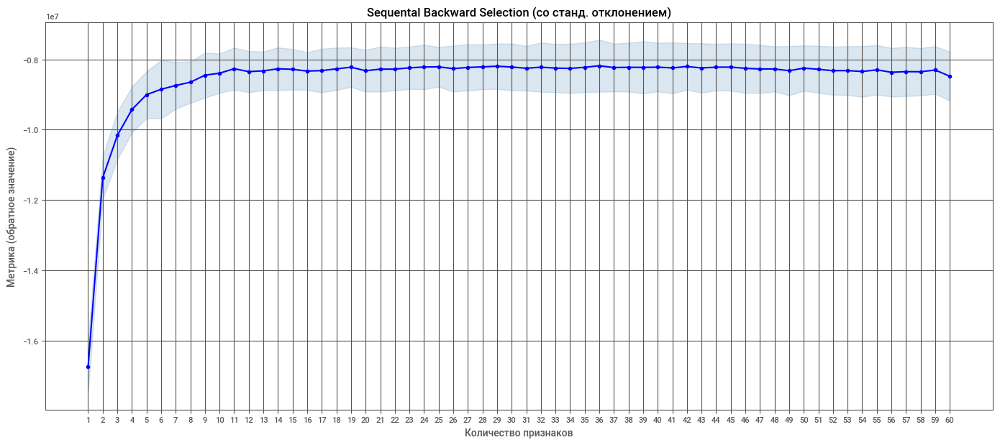

In [80]:
fig = plot_sfs(sbs.get_metric_dict(), figsize=(17, 7), kind="std_dev")
plt.grid()
plt.title("Sequental Backward Selection (со станд. отклонением)")
plt.xlabel("Количество признаков")
plt.ylabel("Метрика (обратное значение)")
plt.savefig(fs_assets("sbs.png"))
plt.show()

По графику отбора признаков методом SBS заметно, что сокращение признаков не значительно влияет на качество предсказаний вплоть до 11 признаков, местами происходит небольшое улучшение метрик, после чего наблюдается резкое снижение метрики по мере сокращения признаков. Оценим какие признаки отобрала модель.

In [81]:
top_sbs = sbs.k_feature_names_
print("Лучшие признаки метода SBS:")
print(pd.Series(top_sbs))

Лучшие признаки метода SBS:
0                                    pol__total_area
1                                         pol__rooms
2                                  pol__total_area^2
3                            pol__total_area^2 rooms
4                                       pol__rooms^3
5                                 cat__building_type
6                            remainder__kitchen_area
7                              remainder__build_year
8                                remainder__latitude
9                               remainder__longitude
10                            remainder__flats_count
11                 remainder__cat_is_apartment_False
12                  remainder__cat_is_apartment_True
13                 remainder__cat_has_elevator_False
14                  remainder__cat_has_elevator_True
15                      remainder__living_area/rooms
16                      remainder__floor*living_area
17                remainder__total_area/floors_total
18               r

Методом SBS отобраны как полиномиальные признаки, так и сгенерированные автоматически, а также часть признаков без изменений, такие как местоположение, площадь кухни, тип здания, высота потолков и количество квартир в здании.

Оценим график отбора признаков методом SFS.

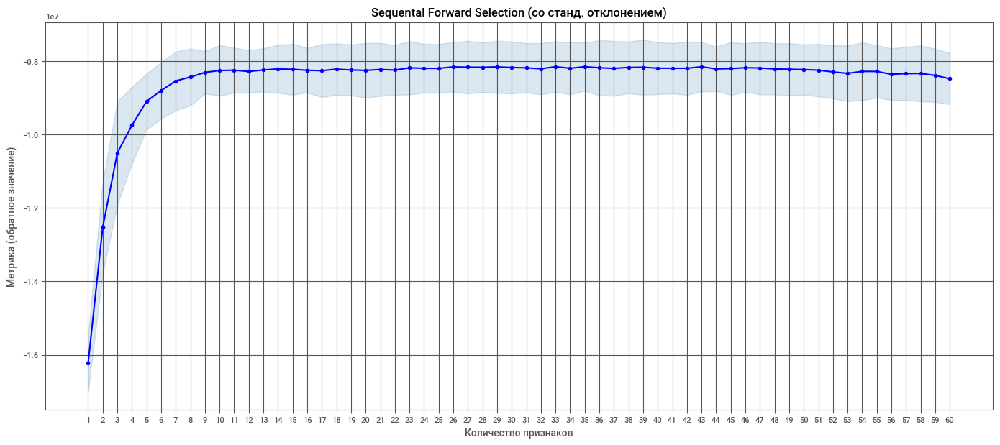

In [82]:
fig = plot_sfs(sfs.get_metric_dict(), figsize=(17, 7), kind="std_dev")
plt.grid()
plt.title("Sequental Forward Selection (со станд. отклонением)")
plt.xlabel("Количество признаков")
plt.ylabel("Метрика (обратное значение)")
plt.savefig(fs_assets("sfs.png"))
plt.show()

График отбора признаков методом SFS более показывает более сглаженную динамику значений метрики. Метрика улучшается по мере добавления признаков до 15-ти, после чего наблюдается плато с небольшим снижением значений метрики. Оценим какие признаки были отобраны методом SFS.

In [83]:
top_sfs = sfs.k_feature_names_
print("Лучшие признаки метода SFS:")
print(pd.Series(top_sfs))

Лучшие признаки метода SFS:
0                                    pol__total_area
1                                         pol__rooms
2                                  pol__total_area^3
3                            pol__total_area rooms^2
4                                  kbd__floors_total
5                            remainder__kitchen_area
6                             remainder__living_area
7                                   remainder__floor
8                              remainder__build_year
9                                remainder__latitude
10                              remainder__longitude
11                         remainder__ceiling_height
12                 remainder__cat_is_apartment_False
13                  remainder__cat_is_apartment_True
14                 remainder__cat_has_elevator_False
15                  remainder__cat_has_elevator_True
16                 remainder__living_area*total_area
17                remainder__total_area/floors_total
18               r

Методом SFS отобраны несколько иные признаки, при этом довольно большое количество признаков совпадает. Оценим какие признаки пересекаются при разных способах отбора.

In [84]:
interc_features = list(set(top_sbs) & set(top_sfs))
print("Список пересекающихся признаков:")
print(pd.Series(interc_features))

Список пересекающихся признаков:
0                              remainder__build_year
1          remainder__log(total_area)/ceiling_height
2                remainder__floors_total*living_area
3     remainder__log(ceiling_height)*log(total_area)
4      remainder__log(ceiling_height)/ceiling_height
5                       remainder__flats_count*rooms
6                  remainder__cat_is_apartment_False
7                 remainder__total_area/floors_total
8                  remainder__total_area/flats_count
9                   remainder__cat_is_apartment_True
10                 remainder__cat_has_elevator_False
11                           remainder__kitchen_area
12                       remainder__total_area/rooms
13                 remainder__sqrt(rooms)/total_area
14                                        pol__rooms
15                       remainder__floor*log(rooms)
16                                   pol__total_area
17                       remainder__log(floor)/floor
18           

Различными методами отобраны 21 идентичный признак. Также взглянем на общее количество отобранных признаков разными методами.

In [85]:
union_features = list(set(top_sbs) | set(top_sfs))
print("Общий список отобранных признаков:")
print(pd.Series(union_features))

Общий список отобранных признаков:
0                              remainder__build_year
1                  remainder__1/(floor*floors_total)
2                   remainder__1/(flats_count*floor)
3          remainder__log(total_area)/ceiling_height
4                remainder__floors_total*living_area
5     remainder__log(ceiling_height)*log(total_area)
6      remainder__log(ceiling_height)/ceiling_height
7                       remainder__flats_count*rooms
8                  remainder__cat_is_apartment_False
9                                  pol__total_area^2
10                remainder__total_area/floors_total
11                                 kbd__floors_total
12           remainder__1/(flats_count*floors_total)
13                      remainder__floor*living_area
14         remainder__sqrt(flats_count)/floors_total
15                 remainder__total_area/flats_count
16        remainder__log(flats_count)/ceiling_height
17                  remainder__cat_is_apartment_True
18         

Объединенный список насчитывает 48 признаков.

### 4.4 Обучение новой версии модели

Произведем обучение новых версий модели на двух наборах отобранных признаков - пересечении и объединении.

In [86]:
# Новая модель для пересечения признаков
model_interc = CatBoostRegressor(verbose=0, random_seed=RANDOM_STATE, thread_count=-1)

# Кросс-валидация
cv_result = cross_validate(
    model_interc, new_feat_train[interc_features], train[target].to_numpy(), 
    cv=CV, scoring=SCORING
)
print(f"Среднее время обучения на кросс-валидации: {np.mean(cv_result['fit_time']):.2f}")
print(f"Среднее время предсказания на кросс-валидации: {np.mean(cv_result['score_time']):.2f}")
print(f"RMSE на кросс-валидации: {-np.mean(cv_result['test_neg_root_mean_squared_error']):,.2f}")
print(f"MAPE на кросс-валидации: {-np.mean(cv_result['test_neg_mean_absolute_percentage_error']):.1%}")
metrics_interc = {
    "cv_rmse": -np.mean(cv_result["test_neg_root_mean_squared_error"]),
    "cv_mape": -np.mean(cv_result["test_neg_mean_absolute_percentage_error"])
}
del cv_result

Среднее время обучения на кросс-валидации: 7.68
Среднее время предсказания на кросс-валидации: 0.06
RMSE на кросс-валидации: 8,376,027.64
MAPE на кросс-валидации: 27.2%


На выборке по пересечению лучших признаков при кросс-валидации метрика RMSE улучшилась по сравнению с полной выборкой дополнительных признаков, а MAPE показывает промежуточные результаты между предыдущими двумя моделями. Оценим метрики на тестовой выборке.

In [87]:
# Обучение модели и получение метрик на тестовой выборке
model_interc.fit(new_feat_train[interc_features], train[target].to_numpy())
interc_feat_test = pd.DataFrame(
    feat_processor.transform(test.drop(columns=target)),
    columns=feat_processor["newfeat"].get_feature_names_out()
)[interc_features]
test_pred = model_interc.predict(interc_feat_test)
# Сохранение метрик
metrics_interc["test_rmse"] = mean_squared_error(test[target], test_pred, squared=False)
metrics_interc["test_mape"] = mean_absolute_percentage_error(test[target], test_pred)
print(f"RMSE: {metrics_interc['test_rmse']:,.2f}")
print(f"MAPE: {metrics_interc['test_mape']:.1%}")

RMSE: 9,093,744.36
MAPE: 52.5%


На тестовой выборке результат по метрикам стал существенно хуже предыдущих моделей. Вероятно такого количества признаков недостаточно для хорошей работы модели.

Оценим следующий набор признаков, который получен путем объединения лучших признаков по результатам отбора разными методами.

In [88]:
# Новая модель для объединенного набора признаков
model_union = CatBoostRegressor(verbose=0, random_seed=RANDOM_STATE, thread_count=-1)

# Кросс-валидация
cv_result = cross_validate(
    model_union, new_feat_train[union_features], train[target].to_numpy(), 
    cv=CV, scoring=SCORING
)
print(f"Среднее время обучения на кросс-валидации: {np.mean(cv_result['fit_time']):.2f}")
print(f"Среднее время предсказания на кросс-валидации: {np.mean(cv_result['score_time']):.2f}")
print(f"RMSE на кросс-валидации: {-np.mean(cv_result['test_neg_root_mean_squared_error']):,.2f}")
print(f"MAPE на кросс-валидации: {-np.mean(cv_result['test_neg_mean_absolute_percentage_error']):.1%}")
metrics_union = {
    "cv_rmse": -np.mean(cv_result["test_neg_root_mean_squared_error"]),
    "cv_mape": -np.mean(cv_result["test_neg_mean_absolute_percentage_error"])
}
del cv_result

Среднее время обучения на кросс-валидации: 12.95
Среднее время предсказания на кросс-валидации: 0.11
RMSE на кросс-валидации: 8,241,720.85
MAPE на кросс-валидации: 27.6%


Время обучения близкое к таковому для общих признаков. Метрика RMSE еще улучшилась, также наблюдается и несущественное улучшение метрики MAPE. Оценим результаты на тестовой выборке.

In [89]:
# Обучение модели и получение метрик на тестовой выборке
model_union.fit(new_feat_train[union_features], train[target].to_numpy())
union_feat_test = pd.DataFrame(
    feat_processor.transform(test.drop(columns=target)),
    columns=feat_processor["newfeat"].get_feature_names_out()
)[union_features]
test_pred = model_union.predict(union_feat_test)
# Сохранение метрик
metrics_union["test_rmse"] = mean_squared_error(test[target], test_pred, squared=False)
metrics_union["test_mape"] = mean_absolute_percentage_error(test[target], test_pred)
print(f"RMSE: {metrics_union['test_rmse']:,.2f}")
print(f"MAPE: {metrics_union['test_mape']:.1%}")

RMSE: 8,446,647.41
MAPE: 52.8%


На тестовой выборке также наблюдается незначительное улучшение метрики RMSE, однако значение MAPE ухудшилось, возможно отобранные признаки немного ухудшают определение более низких значений предсказаний, несмотря на общее улучшение точности. Оценим остатки для лучшей модели.

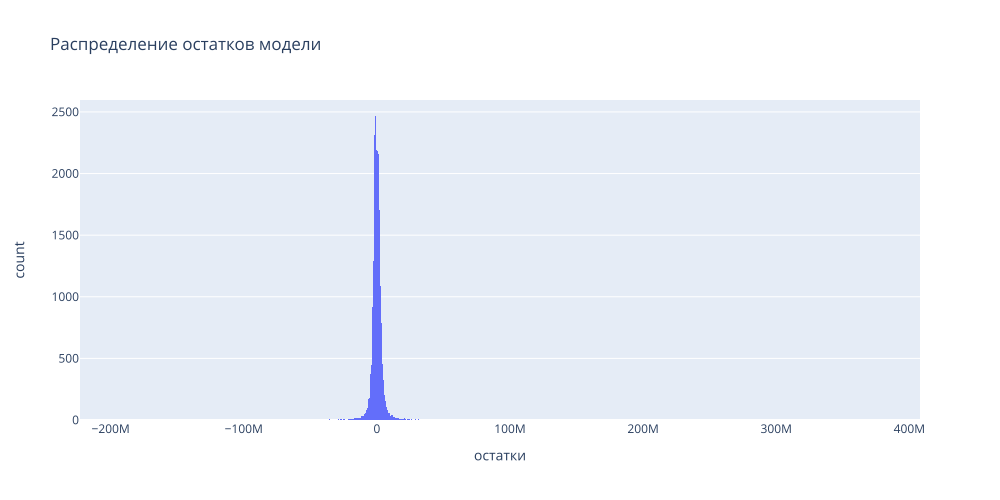

In [90]:
fig = px.histogram(
    test[target] - test_pred,
    labels={"count": "количество", "value": "остатки"},
    title="Распределение остатков модели"
)
fig.update_traces(showlegend=False) 
fig.write_html(fs_assets("featsel_residual_distr.html"))
fig.show(renderer="svg", width=1000)

По распределению остатков довольно сложно сделать выводы, так как большая часть достаточно сильно сгруппирована вблизи околонулевых значений. Оценим дисперсию остатков.

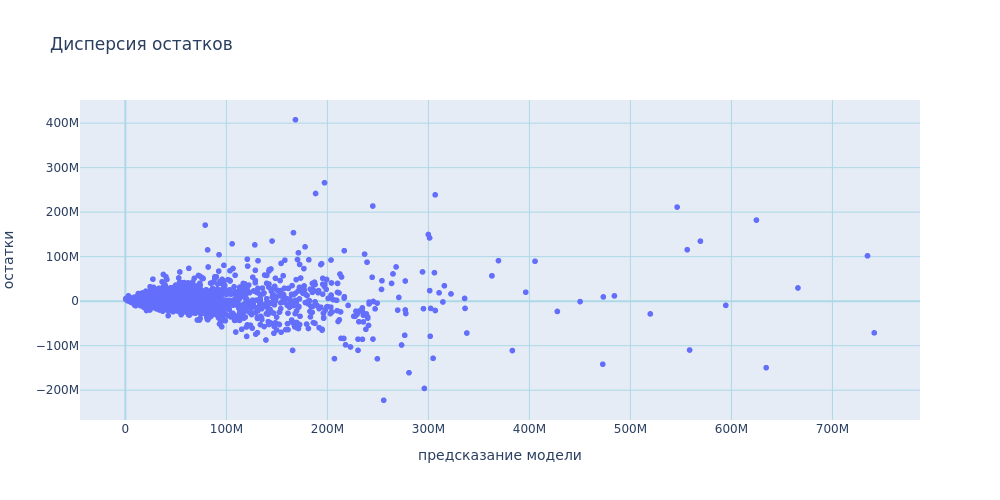

In [91]:
fig = px.scatter(
    x=test_pred, y=test[target] - test_pred, 
    labels={"x": "предсказание модели", "y": "остатки"},
    title="Дисперсия остатков"
)
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='LightBlue', zerolinecolor="LightBlue")
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='LightBlue', zerolinecolor="LightBlue")
fig.write_html(fs_assets("featsel_residual_variance.html"))
fig.show(renderer="png", width=1000)

По дисперсии остатков можно отметить, что самые большие предсказания снизились и уменьшился разброс таких предсказаний. Тенденция также сохраняется по мере увеличения значения предсказания - для более низких чаще модель занижает, а для более высоких завышает. Причем для самых высоких предсказаний разброс снизился, такие значения модель сильнее занижает, чем завышает. Однако увеличился разброс для средних значений от 150 до 350 миллионов, где остались самые большие расхождения в обе стороны. Также исчезли отрицательные предсказания.

### 4.5 Логирование всех артефактов в MLflow

Получим дополнительные сведения для моделей.

In [92]:
interc_signature = mlflow.models.infer_signature(
    interc_feat_test, test[target])
interc_input_example = interc_feat_test.sample(15, random_state=RANDOM_STATE)
union_signature = mlflow.models.infer_signature(
    union_feat_test, test[target])
union_input_example = union_feat_test.sample(15, random_state=RANDOM_STATE)

Логируем новые версии моделей, результаты лучшей модели логируем в основной запуск, а результаты по выборке, основанной на пересечении отобранных признаков в дочерний.

In [93]:
with mlflow.start_run(run_name="Feature selection", experiment_id=experiment_id) as parent_run:
    # Логирование артефактов
    for filename, dirname in fs_assets.list:
        mlflow.log_artifact(filename, dirname)

    # Логирование модели на пересечении отобранных признаков
    with mlflow.start_run(
        run_name="Feature selection (intersection)", experiment_id=experiment_id, nested=True
    ) as child_run:
        mlflow.log_metrics(metrics_interc)
        mlflow.catboost.log_model(
            model_interc, 
            artifact_path="model",
            registered_model_name=REGISTRY_MODEL_NAME,
            signature=interc_signature,
            input_example=interc_input_example,
            await_registration_for=60,
            pip_requirements="../requirements.txt",
        )

    # Логирование лучших метрик
    mlflow.log_metrics(metrics_union)

    # Логирование лучшей модели
    mlflow.catboost.log_model(
        model_union, 
        artifact_path="model",
        registered_model_name=REGISTRY_MODEL_NAME,
        signature=union_signature,
        input_example=union_input_example,
        await_registration_for=60,
        pip_requirements="../requirements.txt",
    )
print("Run ID:", parent_run.info.run_id)

Registered model 'flats_model_zrx' already exists. Creating a new version of this model...
2024/11/25 07:44:08 INFO mlflow.tracking._model_registry.client: Waiting up to 60 seconds for model version to finish creation. Model name: flats_model_zrx, version 3
Created version '3' of model 'flats_model_zrx'.
Registered model 'flats_model_zrx' already exists. Creating a new version of this model...
2024/11/25 07:44:09 INFO mlflow.tracking._model_registry.client: Waiting up to 60 seconds for model version to finish creation. Model name: flats_model_zrx, version 4


Run ID: 96b50c93551d4c27ad8c395377741ca9


Created version '4' of model 'flats_model_zrx'.


### Помежуточные итоги

Произведен отбор признаков, для которого использовались два метода последовательного отбора `Sequential Feature Selection`:
1. Sequential Backward Selection (SBS) — начинает с полного набора признаков и удаляет их один за другим.
2. Sequential Forward Selection (SFS) — начинает с пустого набора признаков и добавляет их один за другим.

Обучение моделей проводилось на двух датасетах - пересечении и объединении признаков, отобранных разными методами последовательного отбора. На тренировочной выборке обе модели улучшили результаты по метрике RMSE по сравнению с полным датасетом, однако более высокие результаты показала модель, обученная на датасете с объединенными признаками, в том числе и улучшение метрики MAPE по сравнению с результатами предыдущих моделей.

Результаты модели на тестовой выборке:
- **RMSE: 8.45 млн.** 
- **MAPE: 52.8%**

## Этап 5: Подбор гиперпараметров и обучение новой версии модели

### 5.1 Подбор гиперпарметров при помощи метода номер 1

В качестве метода номер 1 воспользуемся библиотекой Optuna. Optuna — это мощная библиотека для автоматизированного подбора гиперпараметров, которая особенно удобна для задач машинного обучения и других оптимизационных задач. Она поддерживает как байесовский оптимизационный алгоритм TPE (Tree-structured Parzen Estimator), так и перебор гиперпараметров методом перебора и случайный поиск. В данном проекте воспользуемся байесовским оптимизационным алгоритмом.

In [94]:
# Функция для подбора гиперпараметров
def optimize(trial):
    # Гиперпараметры для модели
    params = {
        "iterations": trial.suggest_int("iterations", 2500, 4000, step=100),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.05, step=0.01),
        "depth": trial.suggest_int("depth", 6, 12),
        "l2_leaf_reg": trial.suggest_float("l2_leaf_reg", 0.1, 5, step=0.1),
        "early_stopping_rounds": None,
        "verbose": 0,
        "thread_count": -1
    }
    # Модель
    model = CatBoostRegressor(**params, random_seed=RANDOM_STATE)
    # Кросс-валидация
    cv_result = cross_validate(
        model, new_feat_train[union_features], train[target].to_numpy(), 
        cv=CV, scoring=SCORING, verbose=1)
    # Получение метрик
    rmse = -cv_result["test_neg_root_mean_squared_error"].mean()
    mape = -cv_result["test_neg_mean_absolute_percentage_error"].mean()
    # Возврат результатов
    return rmse, mape

In [95]:
# Название для optuna study и расположение результатов
study_name = "study_" + REGISTRY_MODEL_NAME
# Список для артефактов подбора гиперпараметров
ht_assets = AssetFiles(init_dir="HT_ASSETS", default_dir="plots")
# База данных sqlite для optuna
study_storage = "sqlite:///" + ht_assets(
    study_name+".db", "optuna").replace(os.path.sep, "/")

# Optuna study для подбора гиперпараметров
study = optuna.create_study(
    study_name=study_name,
    storage=study_storage,
    load_if_exists=True,
    directions=["minimize", "minimize"],
    sampler=optuna.samplers.TPESampler(seed=RANDOM_STATE)
)

[I 2024-11-25 07:44:09,331] Using an existing study with name 'study_flats_model_zrx' instead of creating a new one.


In [96]:
# MLflow run для подбора гиперпараметров
with mlflow.start_run(run_name="Hyperparameter tuning", experiment_id=experiment_id) as run:
    ht_run_id = run.info.run_id

# Callback для логирования в MLflow
mlf_callback = MLflowCallback(
    tracking_uri=MLFLOW_URI,
    metric_name=["cv_rmse", "cv_mape"],
    create_experiment=False,
    mlflow_kwargs={
        "experiment_id": experiment_id,
        "tags": {MLFLOW_PARENT_RUN_ID: ht_run_id}
    }
)

In [97]:
# Подбор гиперпараметров (если не сохранены) и логирование проверок
if len(study.trials) > 0:
    # Добавляем запуски 
    for trial in study.trials:
        mlf_callback(study, trial)
# Если поиск не дошел до количества N_TRIALS продолжим поиск
if len(study.trials) < N_TRIALS:
    trial.optimize(
        optimize, 
        n_trials=N_TRIALS-len(study.trials),
        callbacks=[mlf_callback]
    )

### 5.2 Подбор гиперпарметров при помощи метода номер 2

In [98]:
# Определение сетки гиперпараметров для подбора
param_grid = {
    "iterations": range(2500, 4001, 100),
    "learning_rate": [.01, .02, .03, .04, .05],
    "depth": range(6, 13),
    "l2_leaf_reg": np.array(range(1, 51))/10
}

In [99]:
# Создание экземпляра RandomizedSearchCV
random_cv = RandomizedSearchCV(
    estimator=CatBoostRegressor(
        early_stopping_rounds=None,
        verbose=0,
        random_seed=RANDOM_STATE,
        thread_count=-1
    ),
    param_distributions=param_grid,
    n_iter=N_TRIALS, scoring=SCORING[0],
    cv=CV, random_state=RANDOM_STATE
)

In [100]:
# Подбор гиперпараметров
filename = ht_assets("rscv.pkl", "randomized_search_cv")
# Загружаем сохраненный файл, если существует
if os.path.exists(filename):
    with open(filename, "rb") as fd:
        random_cv = joblib.load(fd)
# Если нет, то обучаем RandomizedSerchCV и сохраняем в файл
else:
    random_cv.fit(new_feat_train[union_features], train[target].to_numpy())
    with open(filename, "wb") as fd:
        joblib.dump(random_cv, fd)

### 5.3 Формирование списка гиперпараметров для новой модели

Оценим важность гиперпараметров, подбор которых осуществлялся посредством optuna

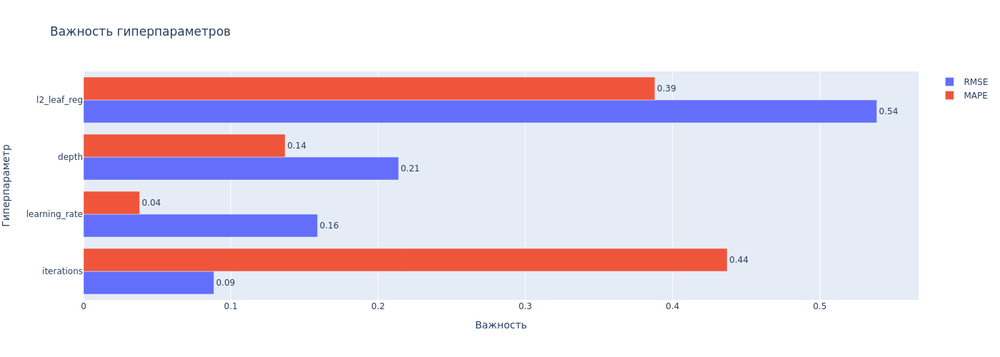

In [101]:
fig = optuna.visualization.plot_param_importances(study)
fig.data[0].name = "RMSE"
fig.data[1].name = "MAPE"
fig.update_layout(
    title="Важность гиперпараметров",
    xaxis_title="Важность",
    yaxis_title="Гиперпараметр")
fig.write_html(file=ht_assets("param_importances.html"))
fig.show(renderer="png", width=1400)

Для метрики RMSE наибольшую важность имеют гиперпараметры l2_leaf_reg и depth, далее по мере снижения важности располагаются learning_rate и iterations. Для метрики MAPE наибльшую важность представляет гиперпараметр iterations, а далее важность гиперпараметров снижается аналогично. Это говорит об улучшении предсказаний более низких целевых значений при увеличении количества итераций CatBoost, так как ошибка для таких предсказаний может быть не сильно большой по номинальному значению, однако в процентном отношении может быть достаточно высокой.

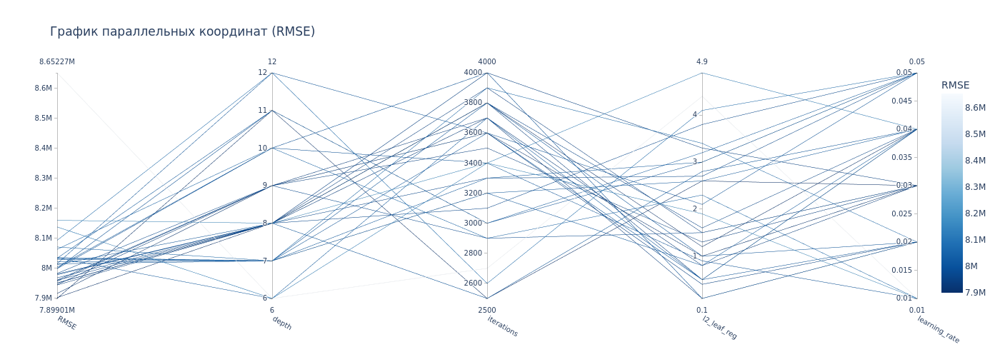

In [102]:
fig = optuna.visualization.plot_parallel_coordinate(study, target=lambda t: t.values[0], target_name="RMSE")
fig.update_layout(title="График параллельных координат (RMSE)")
fig.write_html(file=ht_assets("rmse_parallel_coordinate.html"))
fig.show(renderer="png", width=1400)

Наилучшие (более низкие) значения метрики RMSE показывают более высокие значения iterations при более низких значениях depth и l2_leaf_reg, либо наоборот - низких значениях iterations и высоких значениях depth и l2_leaf_reg. 

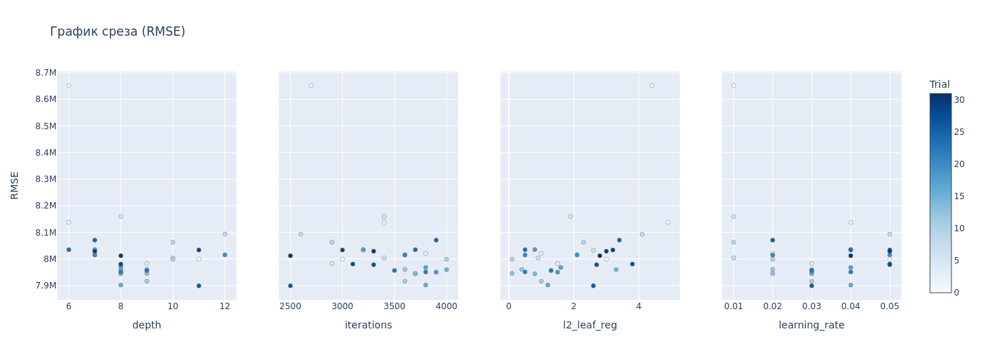

In [103]:
fig = optuna.visualization.plot_slice(study, target=lambda t: t.values[0], target_name="RMSE")
fig.update_layout(title="График среза (RMSE)")
fig.write_html(file=ht_assets("rmse_slice.html"))
fig.show(renderer="png", width=1400)

По графику среза лучше заметны два исследования optuna с наиболее низкими значениями RMSE, которые достаточно сильно отличаются по гиперпараметрам - одно при 2500 итераций CatBoost, при этом с более высокими значениями depth и l2_leaf_reg, другое наоборот при 3800 итераций и низкими значениями двух других гиперпараметров. По гиперпараметру learning_rate лучшие значения варьируются в пределах 0.02-0.04.

Оценим зависимость между самыми важными гиперпараметрами для RMSE.

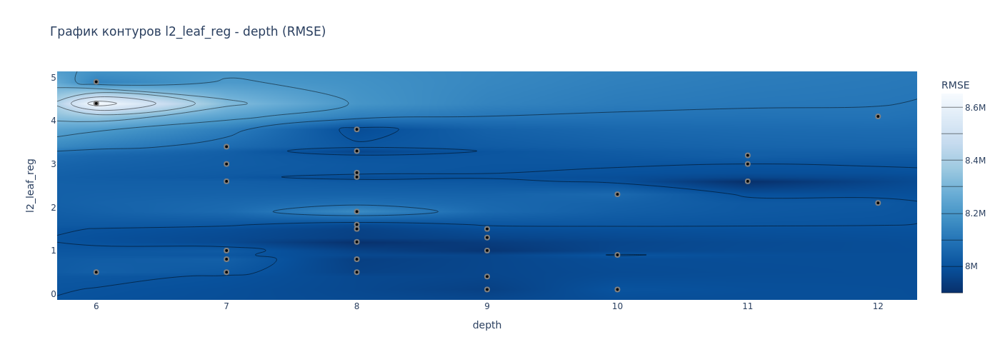

In [104]:
fig = optuna.visualization.plot_contour(
    study, params=["l2_leaf_reg", "depth"], 
    target=lambda t: t.values[0], target_name="RMSE"
)
fig.update_layout(title="График контуров l2_leaf_reg - depth (RMSE)")
fig.write_html(file=ht_assets("rmse_contour_l2leaf-depth.html"))
fig.show(renderer="png", width=1400)

Метрика RMSE лучше при более низких значениях l2_leaf_reg и средних значениях depth. Конечно же на значения RMSE влияют и другие гиперпараметры.

Оценим также влияние гиперпараметров на метрику MAPE

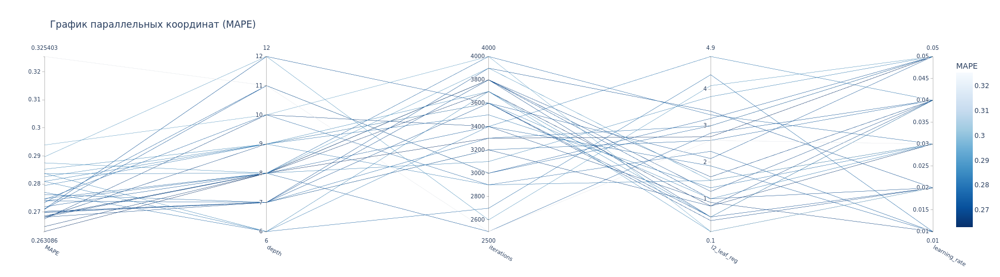

In [105]:
fig = optuna.visualization.plot_parallel_coordinate(study, target=lambda t: t.values[1], target_name="MAPE")
fig.update_layout(title="График параллельных координат (MAPE)")
fig.write_html(file=ht_assets("mape_parallel_coordinate.html"))
fig.show(renderer="png", width=1800)

Лучшие (низкие) значения MAPE приходятся чаще на невысокие значения гиперпараметров depth и l2_leaf_reg, при более высоких значениях iterations.

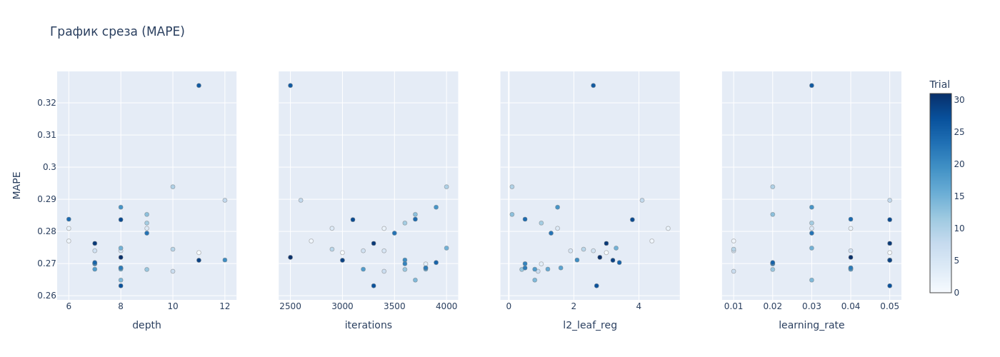

In [106]:
fig = optuna.visualization.plot_slice(study, target=lambda t: t.values[1], target_name="MAPE")
fig.update_layout(title="График среза (MAPE)")
fig.write_html(file=ht_assets("mape_slice.html"))
fig.show(renderer="png", width=1400)

По графику среза явно выделяется наилучшее значение в MAPE в одной из поздних итераций, которая приходится на высокое значение learning_rate, при невысоком значении depth и средних значениях iterations и l2_leaf_reg. Причем основная масса низких значений данной метрики приходится на низкие значения l2_leaf_reg и более высокие значения iterations.

Оценим зависимость между наиболее важными признаками.

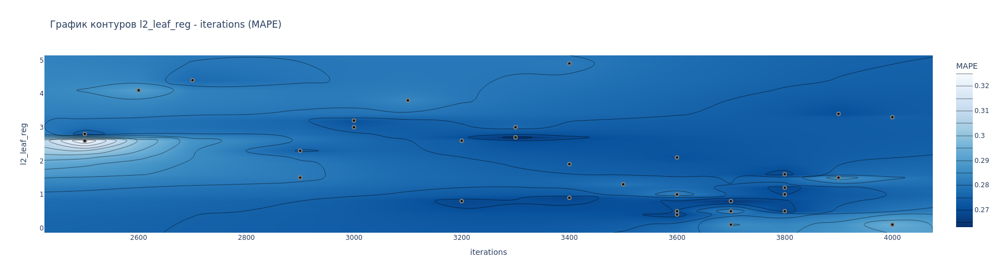

In [107]:
fig = optuna.visualization.plot_contour(
    study, params=["l2_leaf_reg", "iterations"], 
    target=lambda t: t.values[1], target_name="MAPE"
)
fig.update_layout(title="График контуров l2_leaf_reg - iterations (MAPE)")
fig.write_html(file=ht_assets("mape_contour_l2leaf-iterations.html"))
fig.show(renderer="png", width=1800)

Наиболее низкие значения MAPE приходятся на средние и более высокие значения гиперпараметра iterations при низких или средних значениях l2_leaf_reg. Локальные минимумы и максимумы на графике вероятнее определяются также и другими гиперпараметрами.

Оценим наилучшие предсказания двух методов подбора.

In [108]:
ht_result = pd.DataFrame()
for trial in study.best_trials:
    trial_name = "optuna_"+str(trial.number)
    ht_result.loc[trial_name, "RMSE"] = trial.values[0]
    ht_result.loc[trial_name, "MAPE"] = trial.values[1]
    for param_name, param_value  in trial.params.items():
        ht_result.loc[trial_name, param_name] = param_value
ht_result.loc["rs_cv_best", "RMSE"] = - random_cv.best_score_
for param_name, param_value  in random_cv.best_params_.items():
    ht_result.loc["rs_cv_best", param_name] = param_value

ht_result.sort_values("RMSE")

,RMSE,MAPE,iterations,learning_rate,depth,l2_leaf_reg
optuna_26,7899008.07,0.33,2500.00,0.03,11.00,2.60
optuna_16,7901867.27,0.27,3800.00,0.04,8.00,1.20
rs_cv_best,7925066.07,NaN,4000.00,0.05,10.00,0.40
optuna_14,7943982.09,0.26,3700.00,0.03,8.00,0.80
optuna_27,7978221.73,0.26,3300.00,0.05,8.00,2.70


Optuna предлагает на выбор 4 лучших результата - по 2 на каждый гиперпараметр. Стоит отметить, что при лучших значениях RMSE не самые лучшие значения метрики MAPE и наборот. Значение метрики RMSE для лучшей модели с RandomizedSearchCV существенно ниже лучших моделей optuna. Наилучшую метрику RMSE показала модель на 2500 итераций, а также достаточно высокими l2_leaf_reg и depth. Однако стоит отметить существенно худшие значения метрики MAPE - средняя ошибка более 32,5 процентов от фактического значения для данной модели. Это говорит о том, что для более низких значений предсказаний ошибка остается достаточно высокой. 


Возможно хорошим решением было бы использование результатов 16-й итерации подбора гиперпараметров optuna, которые показывают как достаточно высокую метрику RMSE = 7.9 млн., так и MAPE=26.8%, что лишь на 0.5% хуже лучшего значения по MAPE. Однако наибольшая важность гиперпараметров для RMSE приходится на l2_leaf_reg и depth, а для MAPE - на iterations и l2_leaf_reg. Для такого важного гиперпараметра как l2_leaf_reg достаточно близкие значения между наилучшей метрикой RMSE и наилучшей метрикой MAPE. Также в рамках проекта основной целевой метрикой определена RMSE, так что выберем гиперпараметры 26 итерации подбора optuna.

### 5.4 Обучение финальной версии модели

In [109]:
# Получение лучшей метрики и параметров
metrics_ht = {
    "cv_rmse": study.trials[26].values[0],
    "cv_mape": study.trials[26].values[1]
}
params_ht = study.trials[26].params
print("Лучшие гиперпараметры:", params_ht)
print(f"RMSE при кросс-валидации: {metrics_ht['cv_rmse']:,.2f}")
print(f"MAPE при кросс-валидации: {metrics_ht['cv_mape']:.1%}")

# Дополнительные параметры
params_ht["early_stopping_rounds"] = None
params_ht["verbose"] = 0
params_ht["thread_count"] = -1
params_ht["random_seed"] = RANDOM_STATE

Лучшие гиперпараметры: {'iterations': 2500, 'learning_rate': 0.03, 'depth': 11, 'l2_leaf_reg': 2.6}
RMSE при кросс-валидации: 7,899,008.07
MAPE при кросс-валидации: 32.5%


Метрика RMSE при кросс-валидации на тренировочной выборке получилась наилучшей среди всех версий модели, однако по метрике MAPE значения существенно ухудшились и сдвинулись на последнее место. Произведем обучение модели на тренировочной выборке и оценим результаты на тестовой.

In [110]:
# Обучение модели и получение предсказаний
model = CatBoostRegressor(**params_ht)
model.fit(new_feat_train[union_features], train[target].to_numpy())
test_pred = model.predict(union_feat_test)
# Сохранение метрик
metrics_ht["test_rmse"] = mean_squared_error(test[target], test_pred, squared=False)
metrics_ht["test_mape"] = mean_absolute_percentage_error(test[target], test_pred)

print(f"RMSE: {metrics_ht['test_rmse']:,.2f}")
print(f"MAPE: {metrics_ht['test_mape']:.1%}")

RMSE: 8,082,813.74
MAPE: 52.1%


На тестовой выборке значение метрики RMSE также получилось наилучшим среди всех моделей, однако метрика MAPE значительно ухудшилась. Оценим распределение остатков.

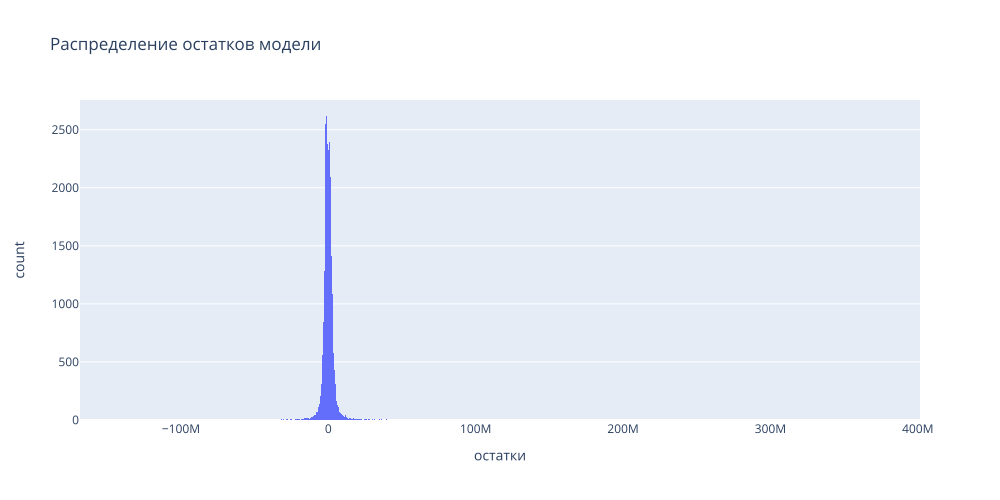

In [111]:
fig = px.histogram(
    test[target] - test_pred,
    labels={"count": "количество", "value": "остатки"},
    title="Распределение остатков модели"
)
fig.update_traces(showlegend=False) 
fig.write_html(ht_assets("model_residual_distr.html"))
fig.show(renderer="svg", width=1000)

Изменения по распределению остатков не сильно заметны. Взглянем на дисперсию остатков.

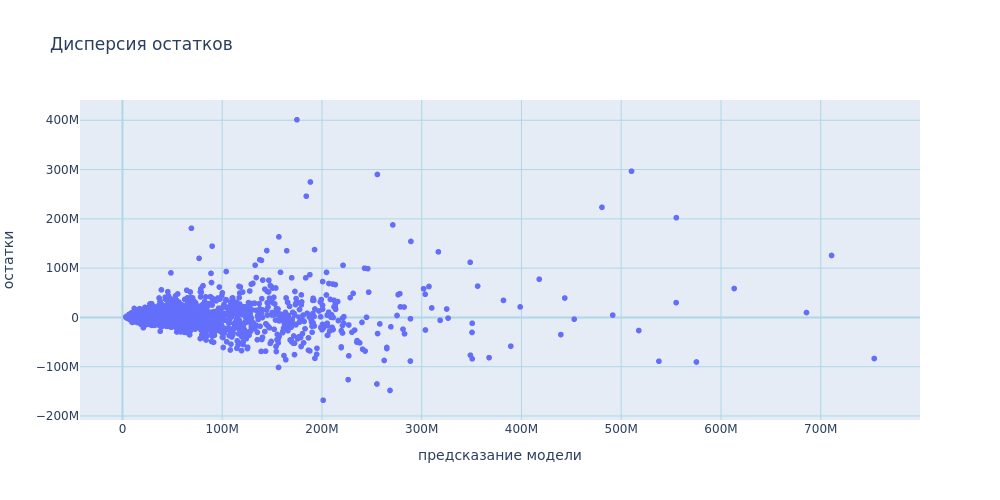

In [112]:
fig = px.scatter(
    x=test_pred, y=test[target] - test_pred, 
    labels={"x": "предсказание модели", "y": "остатки"},
    title="Дисперсия остатков"
)
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='LightBlue', zerolinecolor="LightBlue")
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='LightBlue', zerolinecolor="LightBlue")
fig.write_html(ht_assets("model_residual_variance.html"))
fig.show(renderer="png", width=1000)

Большие выбросы остались, возможно такие значения модель не может предсказать на данных из тестовой выборки, либо такие значения являются выбросом и не было отсеяно на этапе обработки датасета. Также сохранилось увеличение разброса по мере роста значения предсказаний.

### 5.5 Логирование артефактов в MLflow

In [113]:
# Получение дополнительных сведений для логирования
ht_signature = mlflow.models.infer_signature(
    union_feat_test, test[target]
)
ht_input_example = union_feat_test.sample(random_state=RANDOM_STATE)

In [114]:
# Логирование модели и метрик в ранее созданный MLflow run
with mlflow.start_run(run_id=ht_run_id) as run:
    # Логирование артефактов, метрик и параметров
    for filename, dirname in ht_assets.list:
        mlflow.log_artifact(filename, dirname)
    mlflow.log_metrics(metrics_ht)
    mlflow.log_params(params_ht)

    # Логирование модели
    mlflow.catboost.log_model(
        model, 
        artifact_path="model",
        registered_model_name=REGISTRY_MODEL_NAME,
        signature=ht_signature,
        input_example=ht_input_example,
        await_registration_for=60,
        pip_requirements="../requirements.txt",
    )
print("Логирование завершено, run ID:", run.info.run_id)

Registered model 'flats_model_zrx' already exists. Creating a new version of this model...
2024/11/25 07:50:28 INFO mlflow.tracking._model_registry.client: Waiting up to 60 seconds for model version to finish creation. Model name: flats_model_zrx, version 5


Логирование завершено, run ID: 99ed74d05f374127b4355eded31a11e1


Created version '5' of model 'flats_model_zrx'.


### Промежуточные итоги

По результатам пятого этапа произведен подбор гиперпараметров для предыдущей модели. В этих целях использованы два метода - байесовский оптимизационный алгоритм TPE (Tree-structured Parzen Estimator) библиотеки optuna, а также перебор гиперпараметров методом случайного поиска RandomizedSearchCV библиотеки sklearn. Наилучшие гиперпараметры по метрике RMSE были найдены с помщью optuna, случайный поиск показал более низкие метрики. Произведено обучение новой версии модели, которя логирована в MLflow вместе с подобранными гиперпараметрами и результатами тестирования на тренировочной и тестовой выборке.

Результаты модели на тестовой выборке:
- **RMSE: 8.08 млн.** 
- **MAPE: 52.1%**

## Итоговые выводы и рекомендации Заказчику

В рамках данного проекта подготовлена модель машинного обучения для предсказания цен на квартир, а также исследованы возможности улучшения предсказаний модели путем генерации и отбора признаков, а также подбора гиперпараметров модели. Данная модель разработана в целях улучшения коммуникации между арендодателями/продавцами и потенциальными арендаторами/покупателями сервиса Яндекс Недвижимость, путем предоставления объективной внешней оценки стоимости квартиры. Работа проводилась в 5 этапов, в том числе произведена подготовка сервера MLflow для логирования результатов.

1. Подготовлен MLflow сервер, который в качестве бэкэнда для хранилища экспериментов и моделей используется экземпляр PostgreSQL, а для сохранения артефактов используется S3 хранилище Yandex Cloud. 

Все модели, а также метрики, графики, параметры и артефакты каждого из последующих этапов подготовки и анализа модели логированы в MLflow.

2. Проведен исследовательский анализ и обработка данных, а также подготовлена базовая модель:
- Источник и особенности данных: В проекте использованы данные сервиса Яндекс Недвижимость по квартирам в городе Москва, данные содержат 141 362 записи.
- В процессе анализа исключены дубликаты, а также выявлены выбросы, которые были исключены с использованием статистического метода IQR, включая обработку целевого признака.
- Для автоматизации обработки выбросов был подготовлен специальный трансформер и произведена подготовка данных для модели.
- Данные разделены на тестовую и тренировочную выборки для проверки качества моделей в соотношении 1 к 3. Оценка производилась посредством кросс-валидации на тренировочной выборке, а также на тестовой выборке после полного обучения на тренировочной.

Результаты базовой модели на тестовой выборке:
- **RMSE: 8.76 млн.** 
- **MAPE: 53.5%**

3. Для улучшения модели были сгенерированы новые признаки с помощью:
- PolinomialFeatures (полиномиальные признаки).
- kBinsDiscretizer (дискретизация значений).
- autofeat (автоматическое выявление новых значимых признаков).
После обучения новой версии модели были достигнуты улучшенные результаты на тестовой выборке.

Результаты модели с новыми признаками на тестовой выборке:
- **RMSE: 8.51 млн.** 
- **MAPE: 51.7%**

4. Произведен отбор признаков:
- Признаки отбирались методами SBS (Sequential Backward Selection) и SFS (Sequential Forward Selection).
- Тестирование проводилось как на пересечении, так и на объединении отобранных признаков.
Наилучший результат показала модель с объединенными признаками, что подтверждает их дополняемость. Однако незначительно снизилось значение метрики MAPE на тестовой выборке.

Результаты лучшей модели после отбора признаков на тестовой выборке:
- **RMSE: 8.45 млн.** 
- **MAPE: 52.8%**

5. Подбор гиперпараметров
- Для оптимизации гиперпараметров использовались Optuna и RandomizedSearchCV.
- Optuna продемонстрировала лучшие результаты благодаря более продвинутому подходу к поиску гиперпараметров.
Обученная модель была протестирована на тестовой выборке, улучшив результаты по сравнению с предыдущими версиями.

Результаты модели после подбора гиперпараметров на тестовой выборке:
- **RMSE: 8.08 млн.** 
- **MAPE: 52.1%**

---

Подводя итоги проведенного иследования можно отметить следующее:
- генерация новых признаков может существенно повысить качество модели;
- отбор признаков также может улучшить результаты модели, однако это может привести и к ухудшению, в частности значение метрики MAPE существенно увеличилось (ухудшилось), что говорит о возможном влиянии некоторых признаков на более точное предсказание для отдельных диапазонов целевых значений;
- подбор гиперпараметров в большинстве случаев однозначно повышает качество предсказания моделей машинного обучения.

Рекомендации Заказчику по улучшению модели:
- рассмотреть вопрос организации проверки качества данных, в том числе аналитическое сравнение ближайших по характеристикам квартир при создании объявлений (с выводом предупреждений), а также проработать возможность подачи жалоб пользователями на некорректные объявления для их выявления;
- пересмотреть алгоритмы поиска выбросов для их исключения, в том числе с применением ML алгоритмов для поиска аномалий;
- рассмотреть возможность расширения датасета дополнительными признаками квартиры или дома, в частности - состояние, тип ремонта и др.;
- рассмотреть возможность включения даных о транспортной доступности и близости к городской инфраструктуре (метро, школы, больницы, парки и т.д.), либо совместно со специалистами рассмотреть возможность кластеризации картографических данных;
- дальнейшее улучшение предсказаний путем создания мультимодальной модели - включение текстового описания и фото объекта с применением технологий NLP и CV.